In [54]:
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as T
import torch
import torch.nn as nn
from torchvision.utils import make_grid
from torchvision.utils import save_image
from IPython.display import Image
import matplotlib.pyplot as plt
import numpy as np
import random
import os, fnmatch, glob
from glob import glob 
from sklearn.model_selection import train_test_split
%matplotlib inline
from PIL import Image
import torchvision.transforms as tfs
from torch.autograd import Variable
import torch.nn.functional as F
import torch.optim as optim
import pandas as pd
import scipy
import scipy.io
import cv2
#import scipy.io as io

In [55]:
class shangTechTrans:
  def __init__(self):
    pass
  def imgTransformer(self, dataimg, label, scaleFactor):
    #https://github.com/CommissarMa/MCNN-pytorch/blob/master/my_dataloader.py
    rowScale, colScale = int(np.shape(dataimg)[0]//scaleFactor), int(np.shape(dataimg)[1]//scaleFactor)
    # trans = tfs.Compose([
    #       tfs.ToTensor(),
    #       tfs.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    #   ])
    trans = tfs.Compose([
           tfs.ToTensor()])
    dataimg = trans(dataimg)
    label  = cv2.resize(label,(colScale,rowScale))
    return dataimg, label
  def shTrans(self, data, labelIm, scaleFactor):
    imgTrans, labelIm = self.imgTransformer(data, labelIm, scaleFactor)
    labelIm = labelIm*(scaleFactor**2)
    #imgTrans = torch.from_numpy(imgTrans).long()
    labelIm = torch.from_numpy(labelIm)
    return imgTrans, labelIm

In [56]:
class shangTechDataset(Dataset):
  def __init__(self, transformer, dataDirs, labelDirs):
    self.trans = transformer
    self.data_list = dataDirs
    self.label_list = labelDirs
  def __getitem__(self, idx):
    label = np.load(self.label_list[idx])
    img = np.load(self.data_list[idx])
    img, label = self.trans.shTrans(data = img, labelIm = label, scaleFactor = 4)
    return  img, label
  def __len__(self):
    return len(self.data_list)

**Train Data**

In [57]:
labelBaseAddr = '/content/drive/MyDrive/DataHw2_Problem2/part_B/train_data/Patches/GT_PatchesNew/*.npy'
dataBaseAddr = '/content/drive/MyDrive/DataHw2_Problem2/part_B/train_data/Patches/IMG_PatchesNew/*.npy'
dataDir = sorted(glob(dataBaseAddr))
labelDir = sorted(glob(labelBaseAddr))

In [58]:
trainDataDir, valtDataDir, trainLabelDir, valLabelDir = train_test_split(dataDir, labelDir, test_size=0.1, random_state=1)

In [59]:
shangTransform = shangTechTrans()
BATCHSIZE = 1
trainData = shangTechDataset(transformer = shangTransform, dataDirs = trainDataDir, labelDirs = trainLabelDir)
trainDataSHT = DataLoader(trainData, batch_size=BATCHSIZE, shuffle=True)

In [60]:
shangTransform = shangTechTrans()
valData = shangTechDataset(transformer = shangTransform, dataDirs = valtDataDir, labelDirs = valLabelDir)
valDataSHT = DataLoader(valData, batch_size=BATCHSIZE, shuffle=True)

**Test Data**

In [61]:
labelBaseAddr = '/content/drive/MyDrive/DataHw2_Problem2/part_B/test_data/Patches/GT_PatchesNew/*.npy'
dataBaseAddr = '/content/drive/MyDrive/DataHw2_Problem2/part_B/test_data/Patches/IMG_PatchesNew/*.npy'
dataDirTest = sorted(glob(dataBaseAddr))
labelDirTest = sorted(glob(labelBaseAddr))

In [62]:
trestData = shangTechDataset(transformer = shangTransform, dataDirs = dataDirTest, labelDirs = labelDirTest)
testDataSHT = DataLoader(trestData, batch_size=BATCHSIZE, shuffle=True)

tensor(1.8076, dtype=torch.float64)


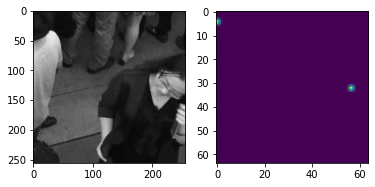

In [63]:
i = 0
for img,gt_dmap in trainDataSHT:
  #imgNew = img.view(-1,256,256).shape
  plt.figure()
  plt.subplot(1,2,1)
  plt.imshow(img.view(-1,256,256)[0], cmap = 'gray')
  plt.subplot(1,2,2)
  plt.imshow(gt_dmap[0])
  print(torch.sum(gt_dmap[0]))
  break
  #plt.figure()
  #plt.plot(gt_dmap)

In [64]:
class CCNN(nn.Module):
    def __init__(self):
      super(CCNN, self).__init__()
      PAD = 3
      DIL = 1
      self.conv1 = nn.Sequential(nn.Conv2d(in_channels=1, out_channels=32, kernel_size=(11,11), padding = 5, stride = 1), nn.ReLU())
      self.conv2 = nn.Conv2d(in_channels=32, out_channels=32, kernel_size=(7,7), padding = 3, stride = 1)
      self.conv3 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=(5,5), padding = 2, stride = 1)
      self.conv4 = nn.Sequential(nn.Conv2d(in_channels=64, out_channels=1000, kernel_size=(1,1), padding = 0, stride = 1), nn.ReLU())
      self.conv5 = nn.Sequential(nn.Conv2d(in_channels=1000, out_channels=400, kernel_size=(1,1), padding = 0, stride = 1), nn.ReLU())
      self.conv6 = nn.Sequential(nn.Conv2d(in_channels=400, out_channels=1, kernel_size=(1,1), padding = 0, stride = 1))
      #self._initialize_weights()
    def forward(self, x):
      x1 = self.conv1(x)
      x2 = F.relu(F.max_pool2d(self.conv2(x1), kernel_size=2, stride=2))
      x3 = F.relu(F.max_pool2d(self.conv3(x2), kernel_size=2, stride=2))
      x4 = self.conv4(x3)
      x5 = self.conv5(x4)
      xOut = self.conv6(x5)
      return xOut
    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.normal_(m.weight, std=0.01)
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

In [65]:
# class CCNN(nn.Module):
#     def __init__(self):
#       super(CCNN, self).__init__()
#       PAD = 3
#       DIL = 1
#       BATCHMOM = 0
#       eps=0.001
#       self.conv1 = nn.Sequential(nn.Conv2d(in_channels=1, out_channels=32, kernel_size=(11,11), padding = 5, stride = 1), 
#                                   nn.BatchNorm2d(32, momentum= BATCHMOM), nn.ReLU())
#       self.conv2 = nn.Sequential(nn.Conv2d(in_channels=32, out_channels=32, kernel_size=(7,7), padding = 3, stride = 1),
#                                   nn.BatchNorm2d(32, momentum= BATCHMOM, eps=0.001, affine = True))
#       self.conv3 = nn.Sequential(nn.Conv2d(in_channels=32, out_channels=64, kernel_size=(5,5), padding = 2, stride = 1),
#                                   nn.BatchNorm2d(64, momentum= BATCHMOM,  eps=0.001, affine = True))
#       self.conv4 = nn.Sequential(nn.Conv2d(in_channels=64, out_channels=1000, kernel_size=(1,1), padding = 0, stride = 1), 
#                                   nn.BatchNorm2d(1000, momentum= BATCHMOM,  eps=0.001, affine = True), nn.ReLU())
#       self.conv5 = nn.Sequential(nn.Conv2d(in_channels=1000, out_channels=400, kernel_size=(1,1), padding = 0, stride = 1), 
#                                   nn.BatchNorm2d(400, momentum= BATCHMOM,  eps=0.001, affine = True), nn.ReLU())
#       self.conv6 = nn.Sequential(nn.Conv2d(in_channels=400, out_channels=1, kernel_size=(1,1), padding = 0, stride = 1))
#       self._initialize_weights()
#     def forward(self, x):
#       x1 = self.conv1(x)
#       x2 = F.relu(F.max_pool2d(self.conv2(x1), kernel_size=2, stride=2))
#       x3 = F.relu(F.max_pool2d(self.conv3(x2), kernel_size=2, stride=2))
#       x4 = self.conv4(x3)
#       x5 = self.conv5(x4)
#       xOut = self.conv6(x5)
#       return xOut
#     def _initialize_weights(self):
#         for m in self.modules():
#             if isinstance(m, nn.Conv2d):
#                 nn.init.normal_(m.weight, std=0.01)
#                 if m.bias is not None:
#                     nn.init.constant_(m.bias, 0)
#             elif isinstance(m, nn.BatchNorm2d):
#                 nn.init.constant_(m.weight, 1)
#                 nn.init.constant_(m.bias, 0)

In [77]:
def plotLoss(epoch, lossTrainHist,lossTrainMAE, lossValHist, lossValMAE):
  plt.figure()
  plt.xlabel('Epoch')
  plt.ylabel('Cross Entropy Loss')
  plt.title('Loss')
  plt.plot(epoch, lossTrainHist, label='Train MSE')
  plt.plot(epoch, lossTrainMAE, label='Train MAE')
  plt.legend(loc='upper left')
  plt.show()
  plt.figure()
  plt.xlabel('Epoch')
  plt.ylabel('Cross Entropy Loss')
  plt.title('Loss')
  plt.plot(epoch, lossValHist, label='Val MSE')
  plt.plot(epoch, lossValMAE, label='Val MAE')
  plt.legend(loc='upper left')
  plt.show()

In [83]:
def showResult(dataLoader, net, epoch_):
  totalLoss = 0; i = 0
  net.eval()
  with torch.no_grad():
    for img,  gt_dmap in dataLoader:
      if torch.cuda.is_available:
        img = img.cuda()
        gt_dmap =  gt_dmap.cuda()
      outputs = net(img.float())
      fig, axs = plt.subplots(1, 3, figsize=(15,5))
      fig.suptitle('Epoch %d'%epoch_)
      axs[0].imshow(img.view(-1,256,256)[0].cpu().numpy(), cmap = 'gray')
      axs[0].set_title('Original Image')
      axs[1].imshow(gt_dmap.view(-1,64,64)[0].cpu().numpy())
      axs[1].set_title('True Label')
      axs[2].imshow(outputs.view(-1,64,64)[0].cpu().numpy(), cmap = 'gray')
      axs[2].set_title('Predicted Output')
      plt.show()
      print("True Number: ", torch.sum(gt_dmap.view(-1,64,64)[0]),
            "Predicted Number: ", torch.sum(outputs.view(-1,64,64)[0]))
      if i%5 == 3:
        break
      i +=1


In [84]:
def calcLoss(dataloader, net, criterion, criterionII):
  totalLoss = 0; i = 0; totalMAE = 0
  net.eval()
  #with torch.no_grad():
  for img,  gt_dmap in dataloader:
    if torch.cuda.is_available:
      img = img.cuda()
      gt_dmap =  gt_dmap.cuda()
    i +=1
    outputs = net(img.float())
    loss = criterion(outputs.view(-1,64,64), gt_dmap.view(-1,64,64).float())
    lossMAE = criterionII(outputs.view(-1,64,64), gt_dmap.view(-1,64,64).float())
    totalLoss += loss.item()
    totalMAE += lossMAE.item()
    if i%100 == 99:
      break
  avgLoss = totalLoss/i
  avgLossMAE = totalMAE/i
  return avgLoss, avgLossMAE

In [89]:
net = CCNN()
lossTrainHist = []; lossValHist = []; epochHist = []; lossValMAE = []; lossTrainMAE = []
if torch.cuda.is_available():
    net = net.cuda()
#criterion = nn.L1Loss()
#optimizer = optim.Adam(net.parameters(), lr=0.001, betas=(0.9, 0.999), eps=1e-8, weight_decay=0.005)
device=torch.device("cuda")
criterion=nn.MSELoss().to(device)
criterionII = nn.L1Loss().to(device)
#optimizer = torch.optim.SGD(net.parameters(), lr=1e-7, momentum=0.95, )
optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9, weight_decay=0.005)
#optimizer = optim.Adam(net.parameters(), lr=0.00001, betas=(0.9, 0.999), eps=1e-8, weight_decay=0.005)

**********Epoch: 1 **********
 Epoch 1,  Iteration     1,  Loss: 0.3046202958
Sum Label:  tensor(2.0001, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(-1979.6077, device='cuda:0', grad_fn=<SumBackward0>)


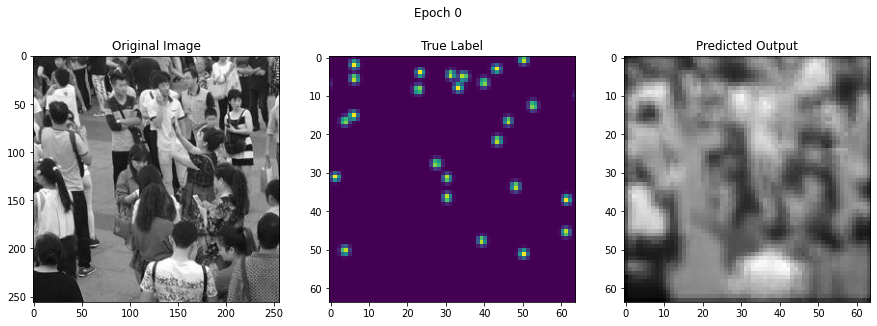

True Number:  tensor(25.0135, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(12682.3848, device='cuda:0')


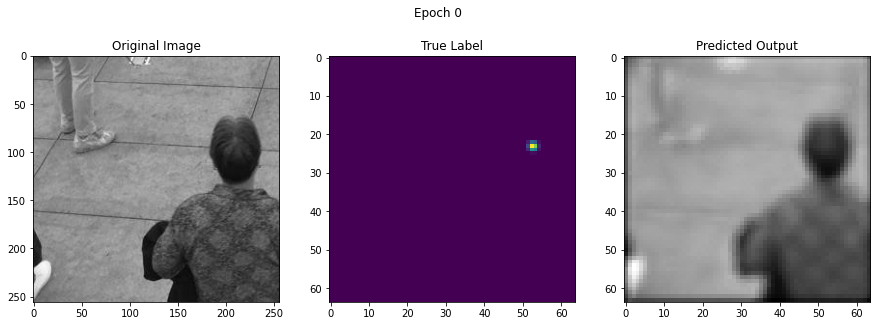

True Number:  tensor(1.0000, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13048.9326, device='cuda:0')


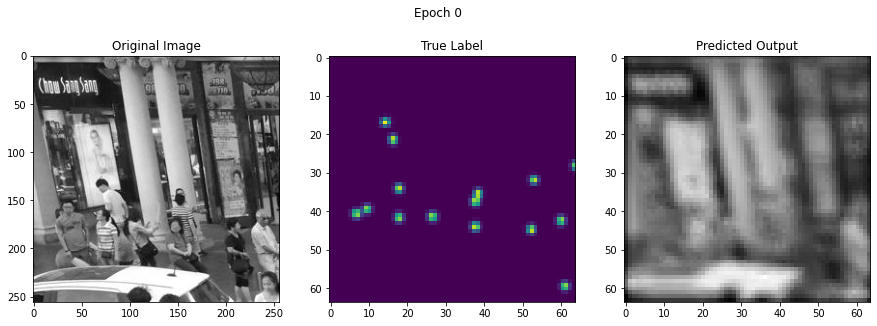

True Number:  tensor(14.5108, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13761.3301, device='cuda:0')


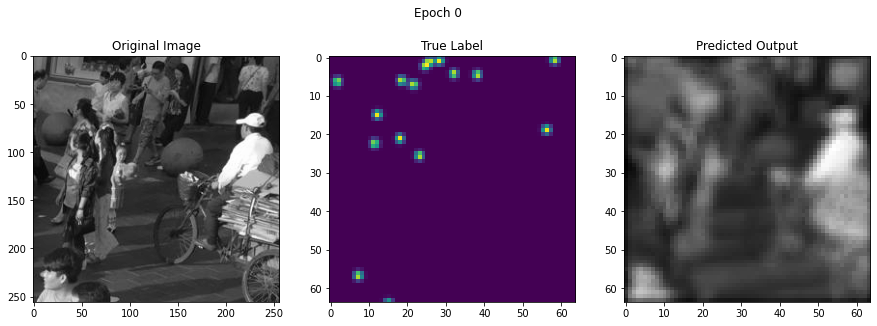

True Number:  tensor(15.2049, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8973.2373, device='cuda:0')


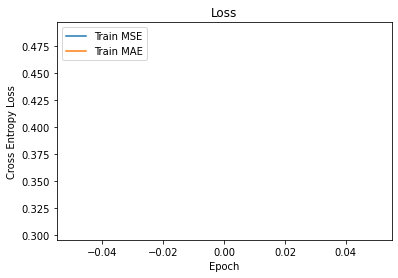

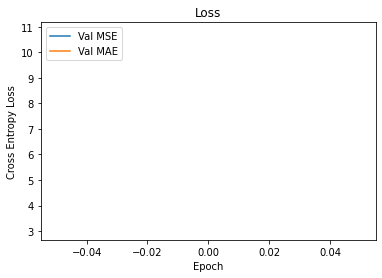

Test Loss MSE:  9.824518955115115 Test Loss MAE:  2.8832832045025296
 Epoch 1,  Iteration   401,  Loss: 0.0730380987
Sum Label:  tensor(0., device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(4.3526, device='cuda:0', grad_fn=<SumBackward0>)


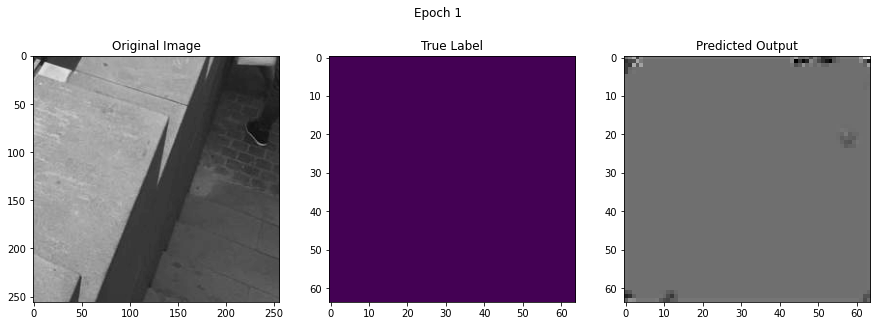

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(6.4099, device='cuda:0')


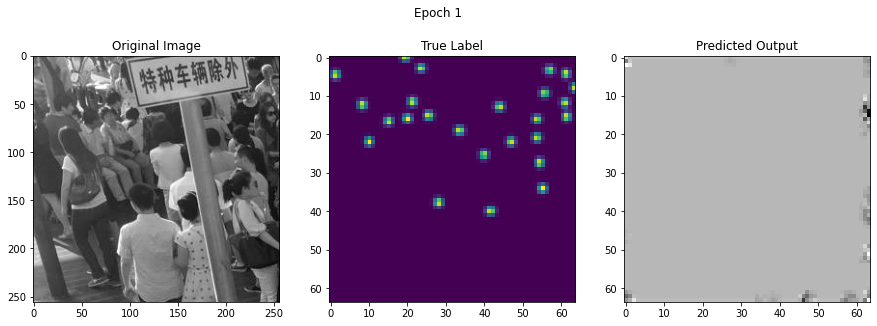

True Number:  tensor(24.2758, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(5.8509, device='cuda:0')


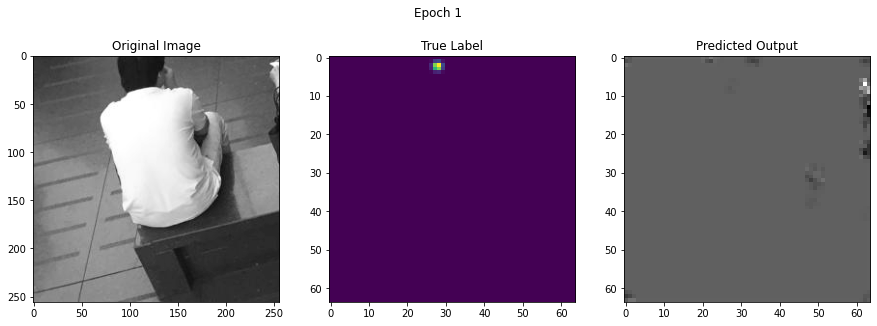

True Number:  tensor(1.0135, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(6.1158, device='cuda:0')


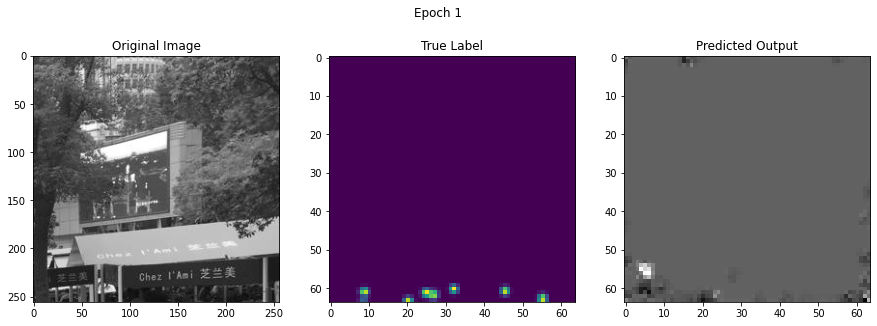

True Number:  tensor(6.6459, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(4.3194, device='cuda:0')


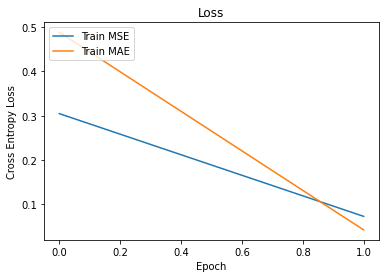

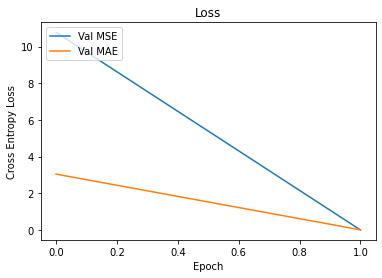

Test Loss MSE:  0.0005384891301678227 Test Loss MAE:  0.005912014554875593
 Epoch 1,  Iteration   801,  Loss: 0.0367853233
Sum Label:  tensor(2.0134, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(11.7949, device='cuda:0', grad_fn=<SumBackward0>)


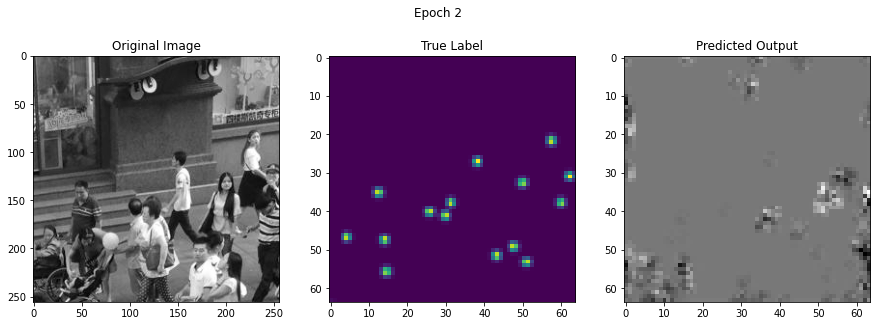

True Number:  tensor(15.0276, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.7348, device='cuda:0')


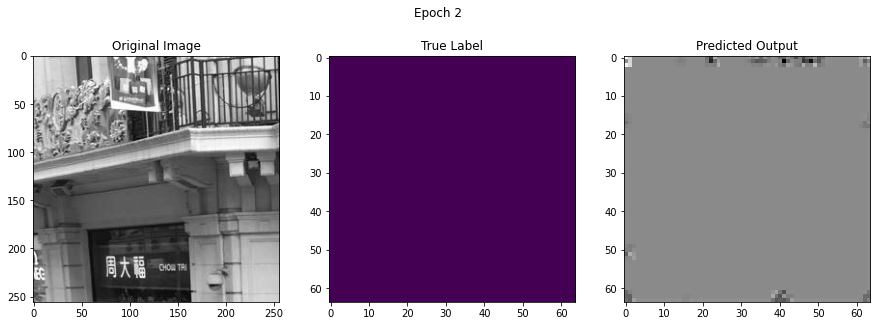

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(12.1534, device='cuda:0')


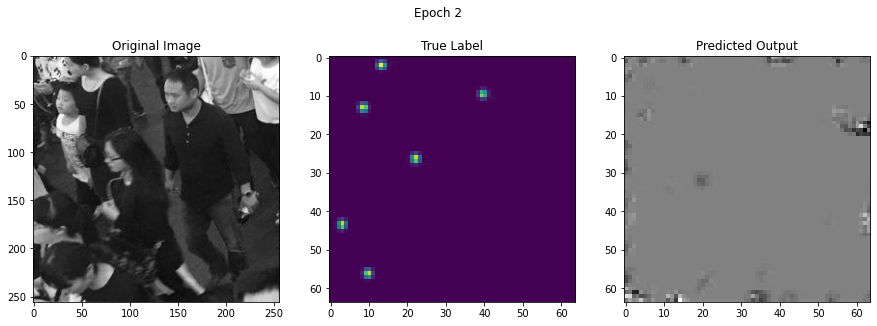

True Number:  tensor(5.9999, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.9777, device='cuda:0')


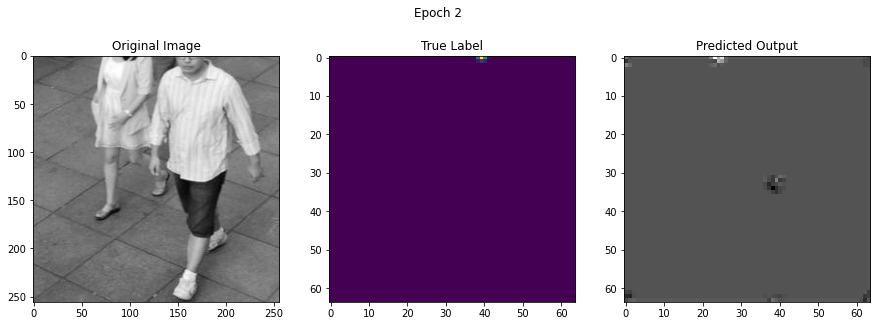

True Number:  tensor(0.4300, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.0968, device='cuda:0')


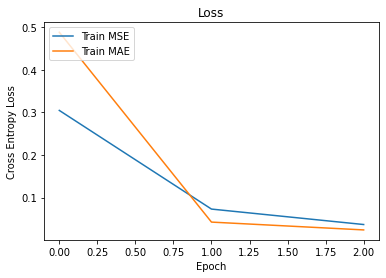

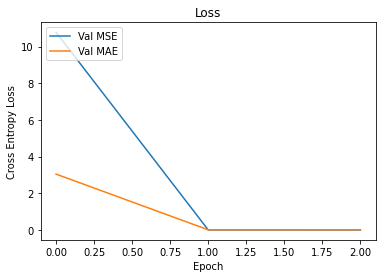

Test Loss MSE:  0.0005560531579598171 Test Loss MAE:  0.007198040804007288
 Epoch 1,  Iteration  1201,  Loss: 0.0246998814
Sum Label:  tensor(14.3641, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(11.0709, device='cuda:0', grad_fn=<SumBackward0>)


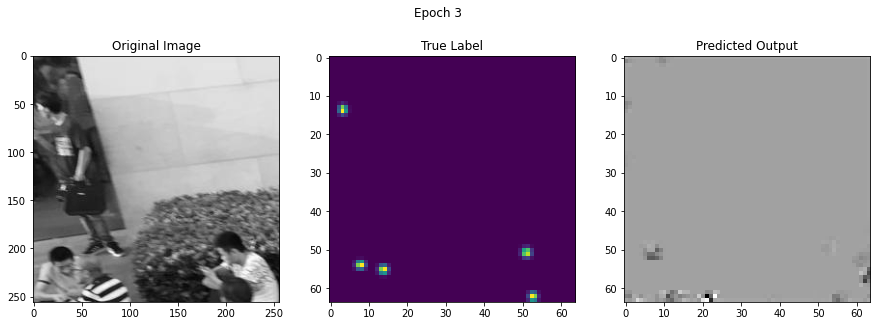

True Number:  tensor(4.9955, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.6818, device='cuda:0')


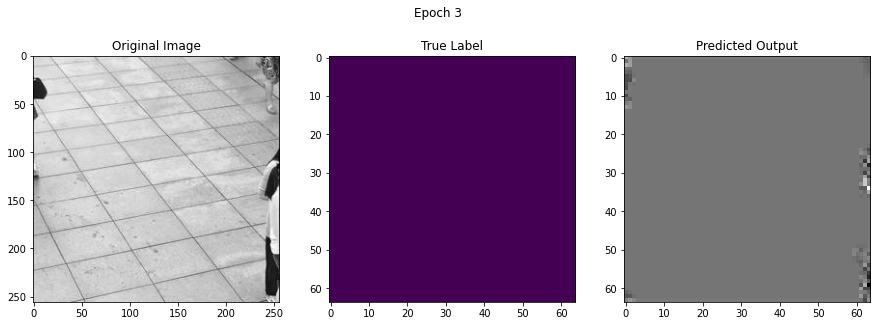

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.6023, device='cuda:0')


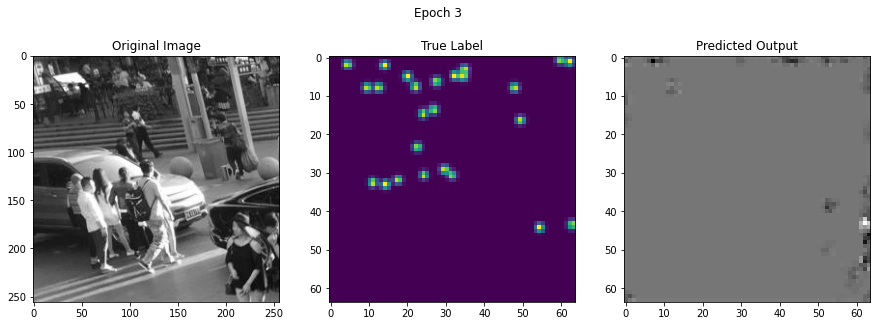

True Number:  tensor(24.8412, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.2782, device='cuda:0')


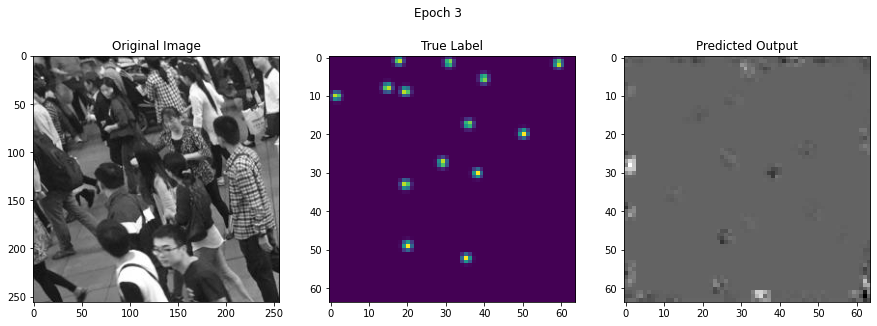

True Number:  tensor(13.9687, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.1186, device='cuda:0')


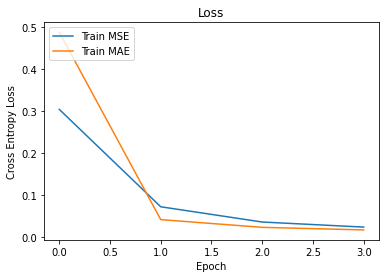

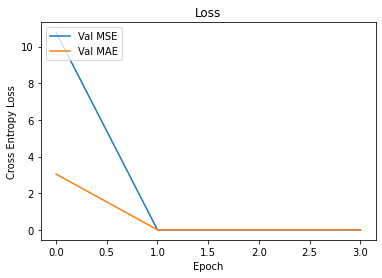

Test Loss MSE:  0.0005437616278372429 Test Loss MAE:  0.006049721814560319
 Epoch 1,  Iteration  1601,  Loss: 0.0186329994
Sum Label:  tensor(1.9866, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(5.2323, device='cuda:0', grad_fn=<SumBackward0>)


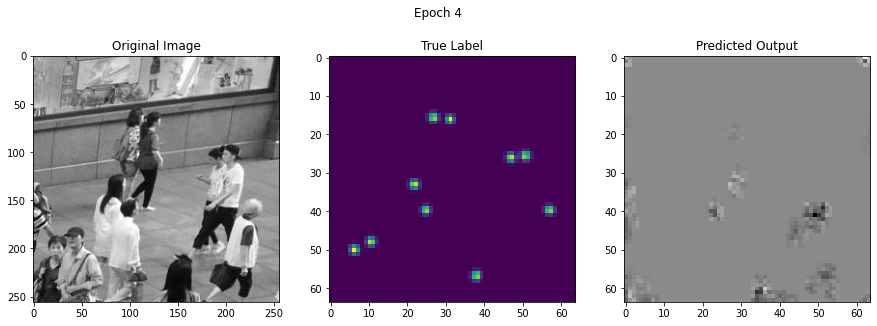

True Number:  tensor(10.0405, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(4.4140, device='cuda:0')


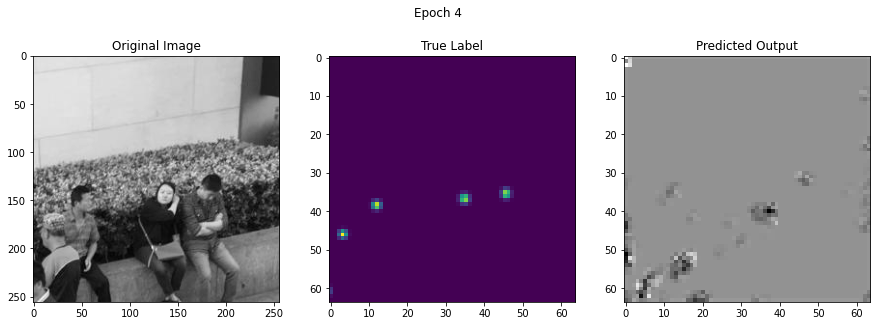

True Number:  tensor(4.1178, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(4.3625, device='cuda:0')


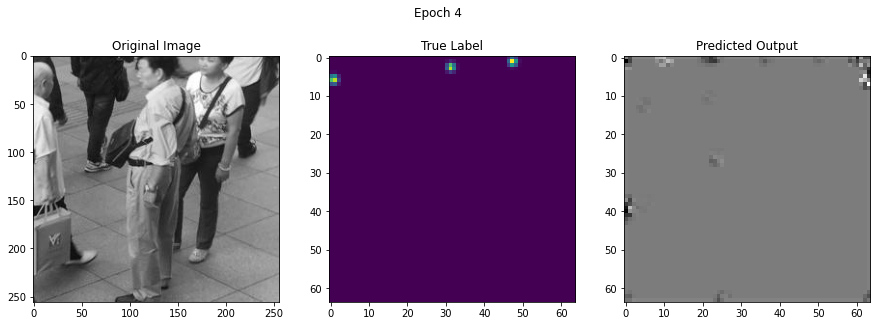

True Number:  tensor(2.9328, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(5.5857, device='cuda:0')


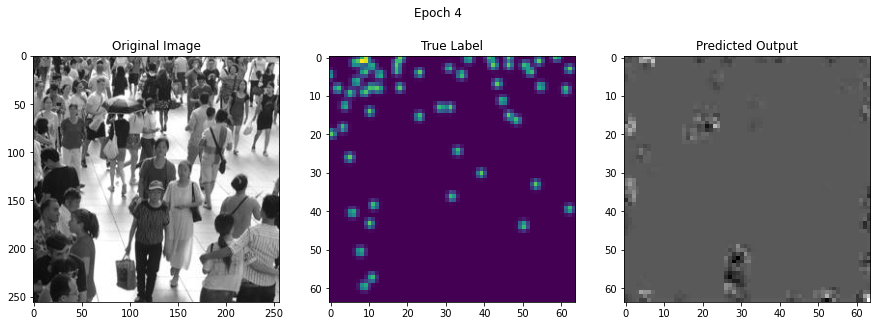

True Number:  tensor(53.9842, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(6.1572, device='cuda:0')


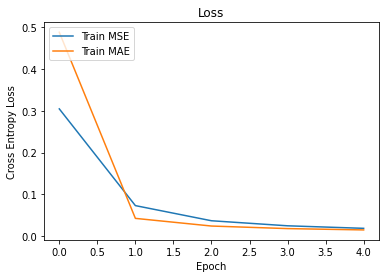

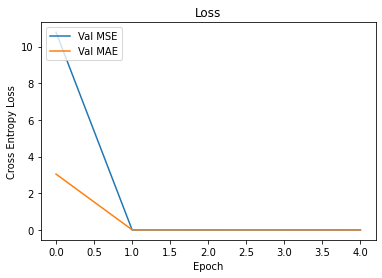

Test Loss MSE:  0.0003565400355579517 Test Loss MAE:  0.00416256735251859
 Epoch 1,  Iteration  2001,  Loss: 0.0149940407
Sum Label:  tensor(36.0379, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(12.7647, device='cuda:0', grad_fn=<SumBackward0>)


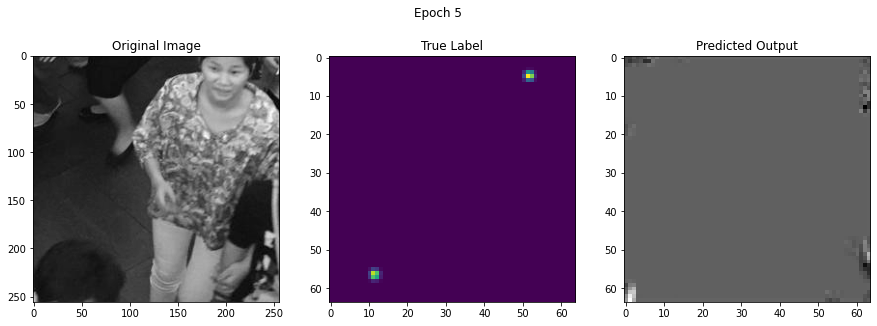

True Number:  tensor(2.0134, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(12.7730, device='cuda:0')


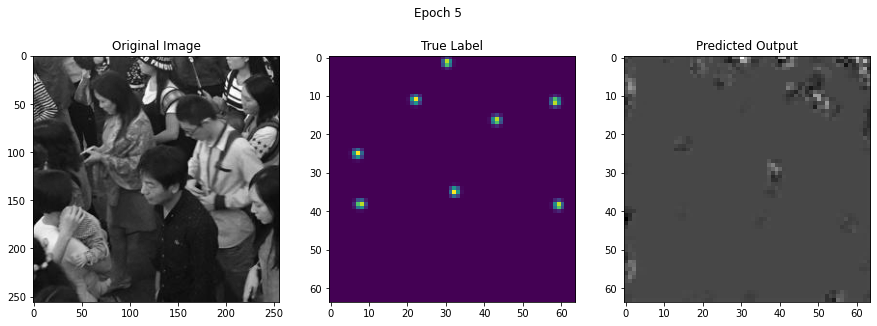

True Number:  tensor(7.9596, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.5491, device='cuda:0')


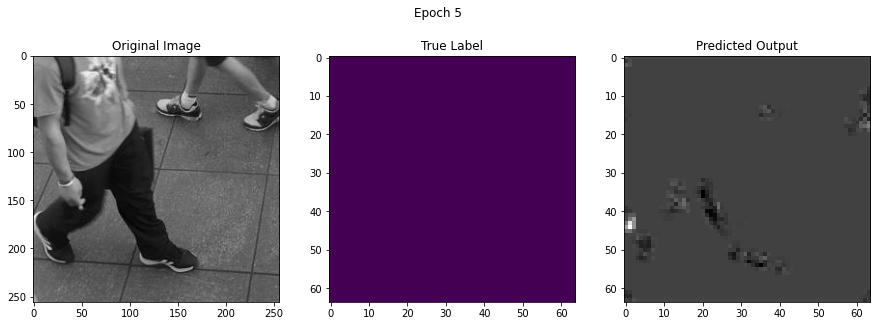

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(12.0319, device='cuda:0')


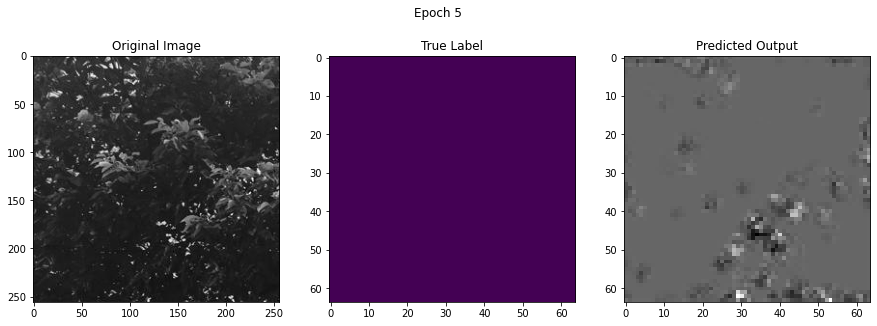

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.9547, device='cuda:0')


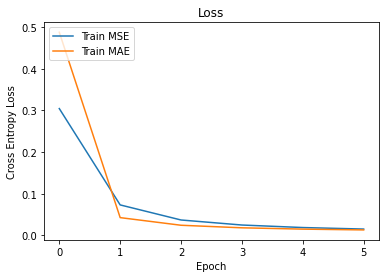

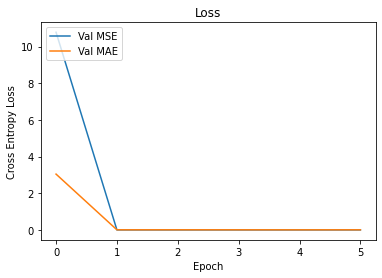

Test Loss MSE:  0.00031389692161831067 Test Loss MAE:  0.005213547283971701
 Epoch 1,  Iteration  2401,  Loss: 0.0125937937
Sum Label:  tensor(1.0000, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(8.1969, device='cuda:0', grad_fn=<SumBackward0>)


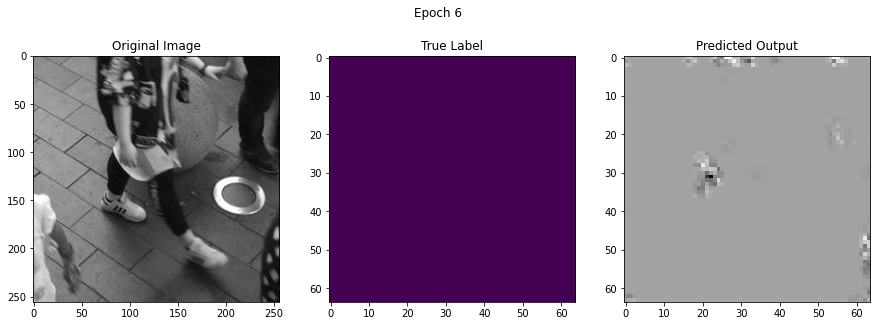

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.2616, device='cuda:0')


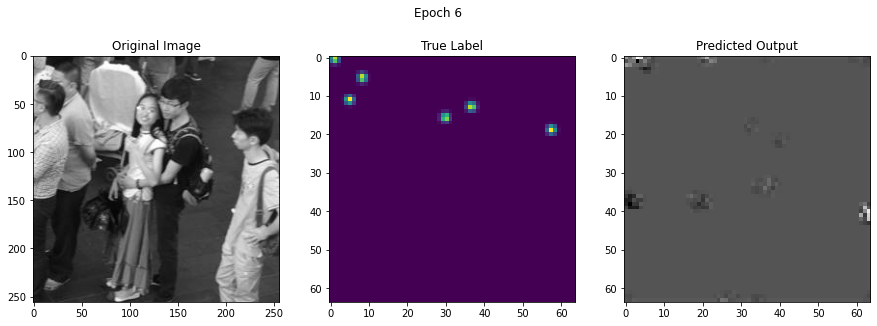

True Number:  tensor(5.8677, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.4221, device='cuda:0')


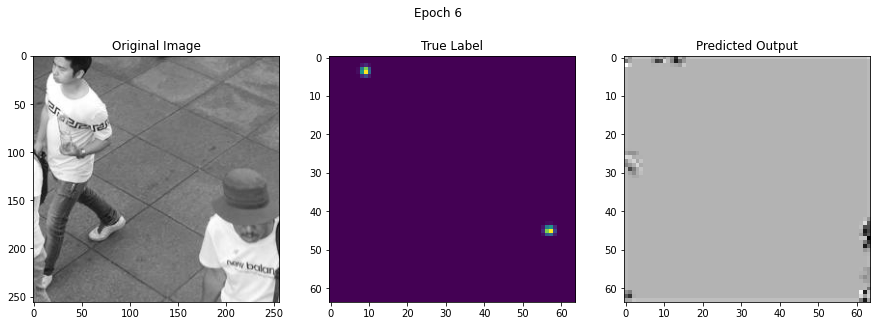

True Number:  tensor(1.9999, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.9818, device='cuda:0')


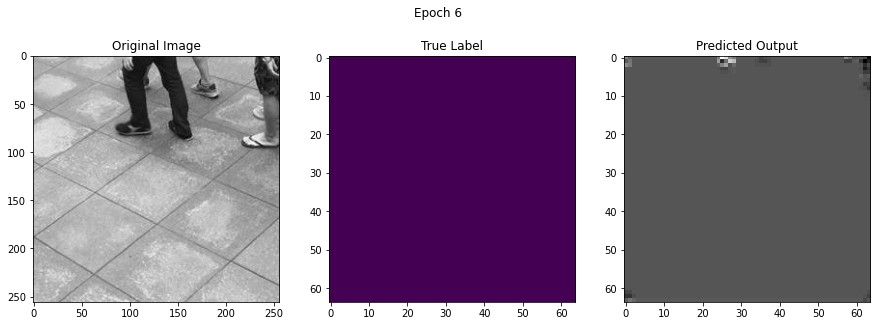

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.5275, device='cuda:0')


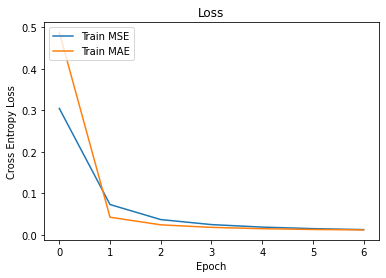

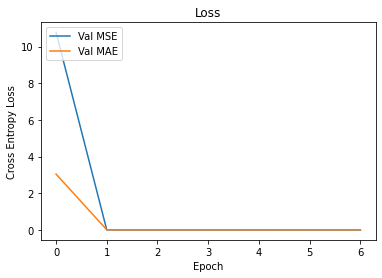

Test Loss MSE:  0.00032780478236280476 Test Loss MAE:  0.004337263970889829
 Epoch 1,  Iteration  2801,  Loss: 0.0108554191
Sum Label:  tensor(23.8233, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(9.8524, device='cuda:0', grad_fn=<SumBackward0>)


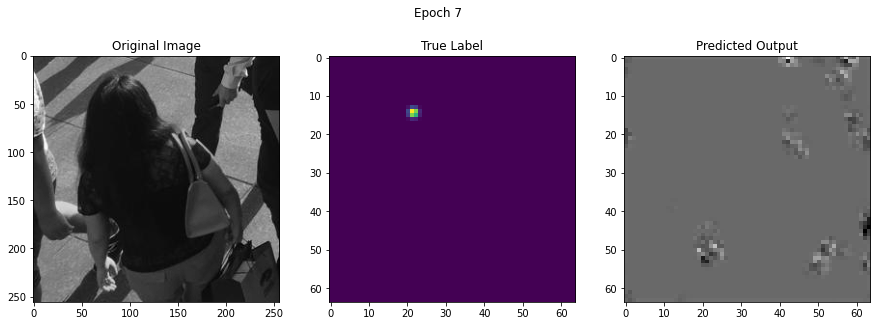

True Number:  tensor(1.0135, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.4928, device='cuda:0')


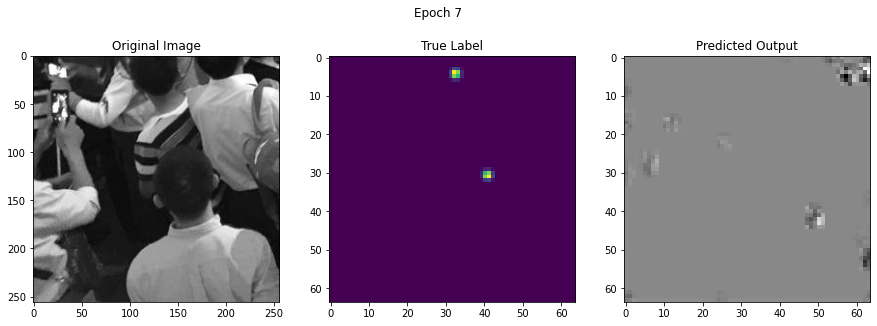

True Number:  tensor(2.0270, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.1246, device='cuda:0')


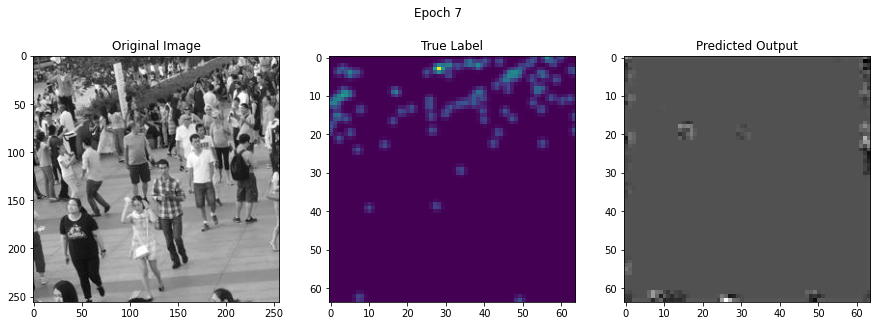

True Number:  tensor(98.3880, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.6577, device='cuda:0')


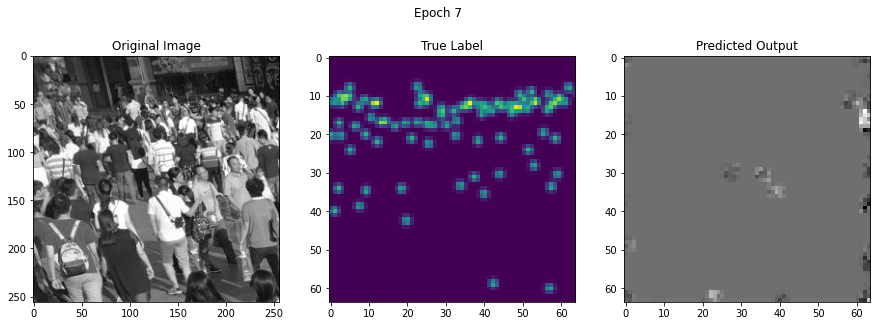

True Number:  tensor(83.8537, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.6243, device='cuda:0')


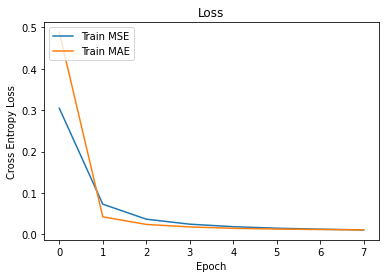

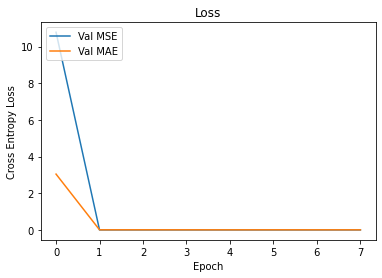

Test Loss MSE:  0.0004393275875087846 Test Loss MAE:  0.005692668275606602
 Epoch 1,  Iteration  3201,  Loss: 0.0095522779
Sum Label:  tensor(3.0000, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(6.1321, device='cuda:0', grad_fn=<SumBackward0>)


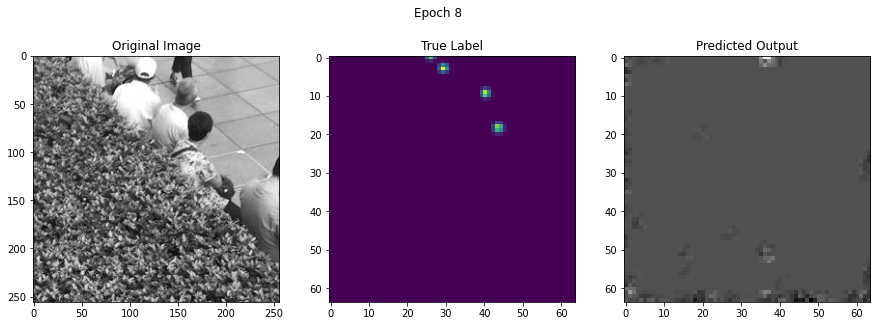

True Number:  tensor(3.4301, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(6.0425, device='cuda:0')


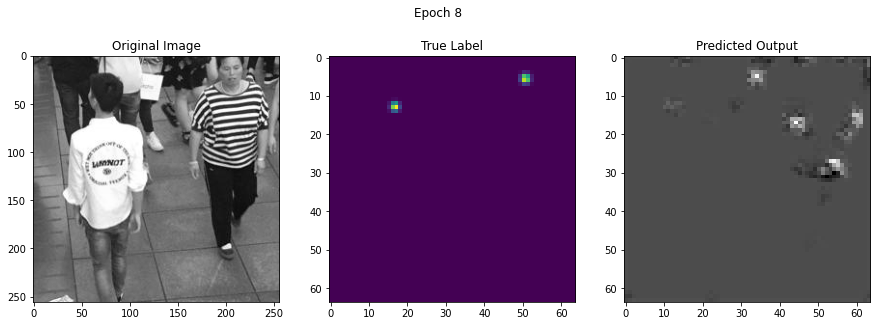

True Number:  tensor(2.0134, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.1731, device='cuda:0')


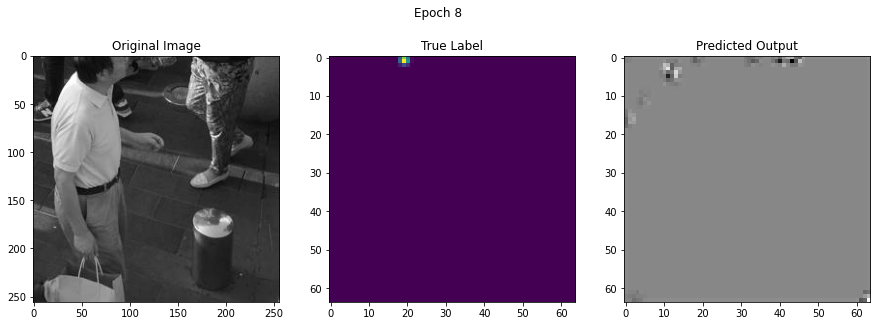

True Number:  tensor(0.9462, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(6.3992, device='cuda:0')


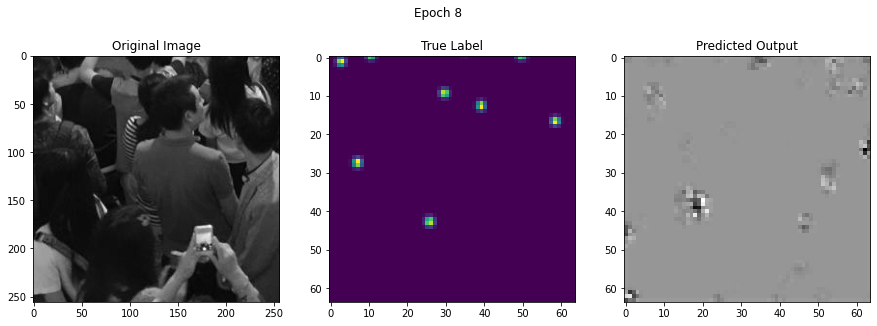

True Number:  tensor(6.9163, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(5.7257, device='cuda:0')


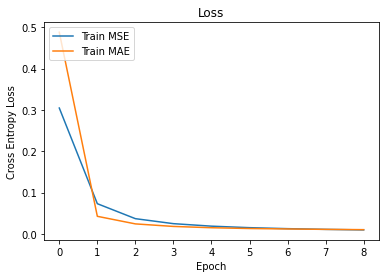

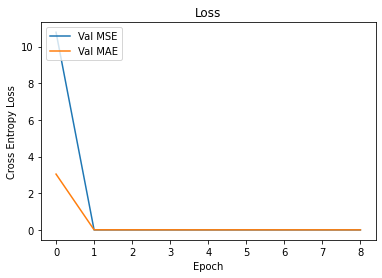

Test Loss MSE:  0.0003723142708576684 Test Loss MAE:  0.004136338871151134
 Epoch 1,  Iteration  3601,  Loss: 0.0085386026
Sum Label:  tensor(9.9964, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(5.3738, device='cuda:0', grad_fn=<SumBackward0>)


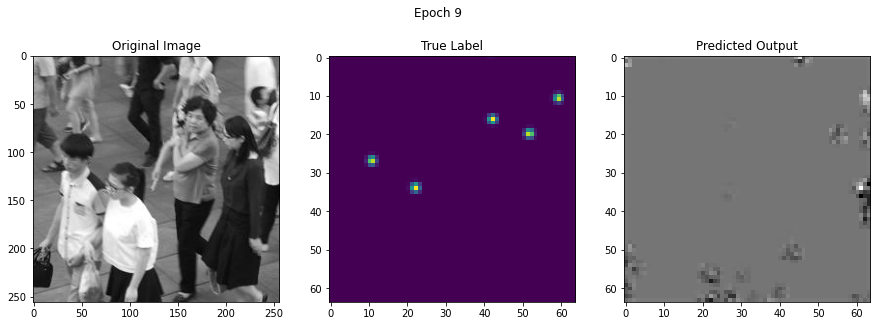

True Number:  tensor(4.9909, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(4.0164, device='cuda:0')


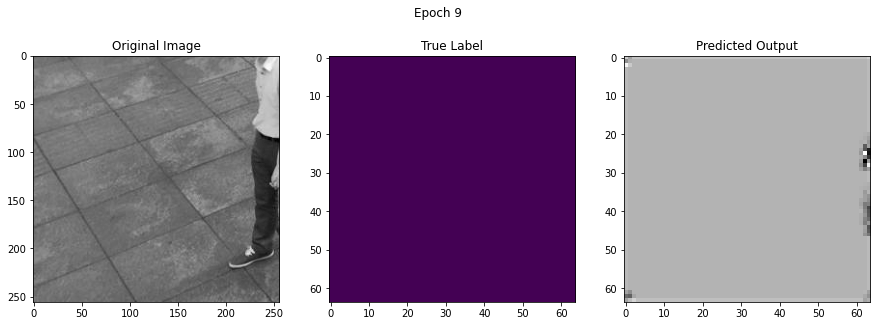

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(4.4017, device='cuda:0')


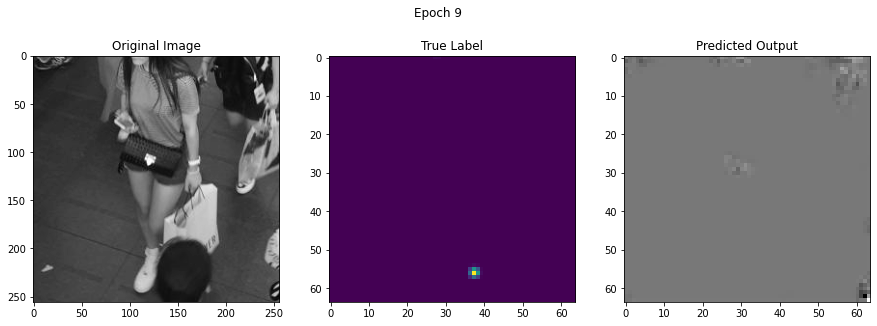

True Number:  tensor(1.0044, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(4.5775, device='cuda:0')


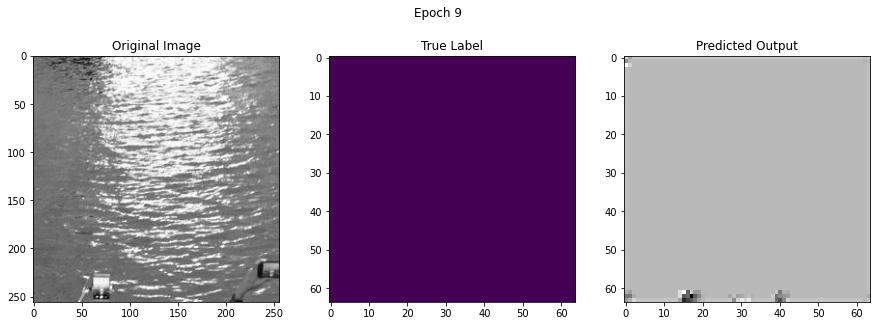

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(4.5290, device='cuda:0')


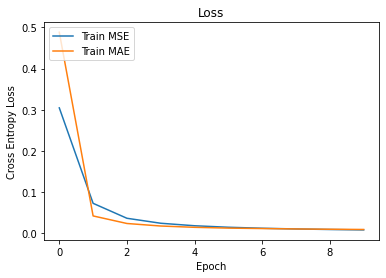

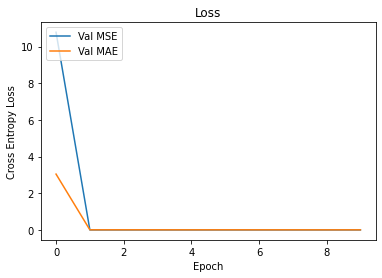

Test Loss MSE:  0.00038115893984941253 Test Loss MAE:  0.003795368161823864
 Epoch 1,  Iteration  4001,  Loss: 0.0077334048
Sum Label:  tensor(0., device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(12.7305, device='cuda:0', grad_fn=<SumBackward0>)


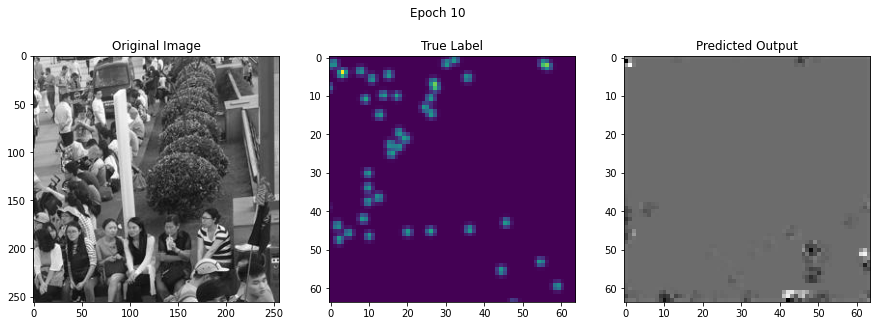

True Number:  tensor(41.6526, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(12.8960, device='cuda:0')


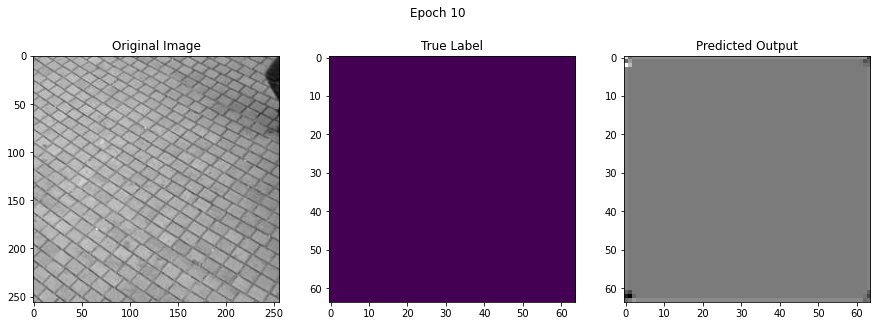

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.3888, device='cuda:0')


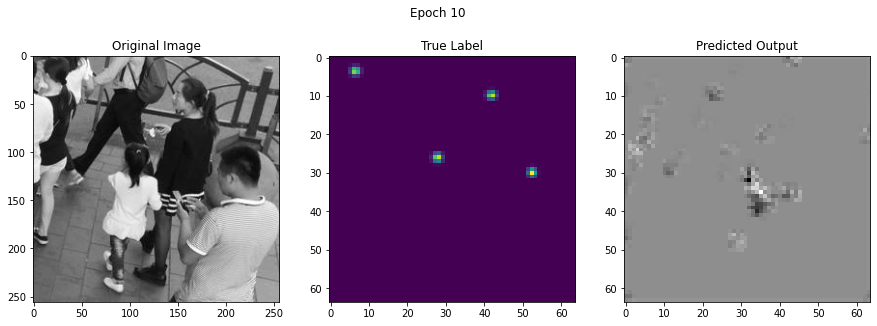

True Number:  tensor(4., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.0770, device='cuda:0')


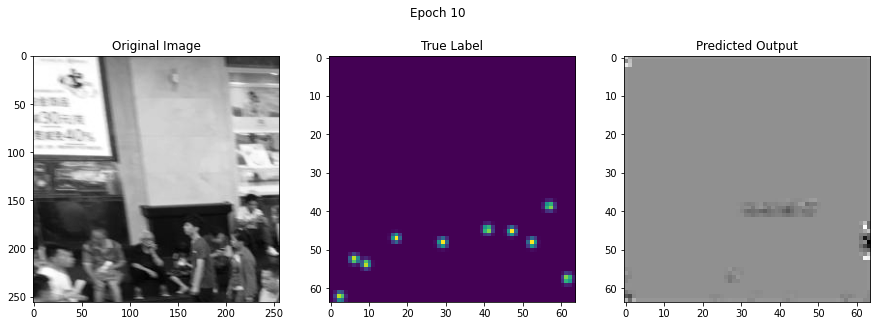

True Number:  tensor(9.9689, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.0548, device='cuda:0')


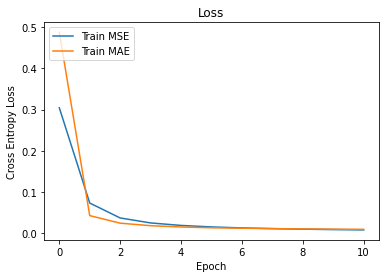

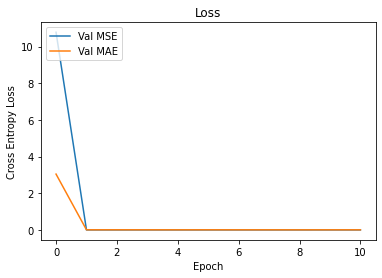

Test Loss MSE:  0.0004148894529752204 Test Loss MAE:  0.005718301468989765
**********Epoch: 2 **********
 Epoch 2,  Iteration     1,  Loss: 0.0000043240
Sum Label:  tensor(0., device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(7.5848, device='cuda:0', grad_fn=<SumBackward0>)


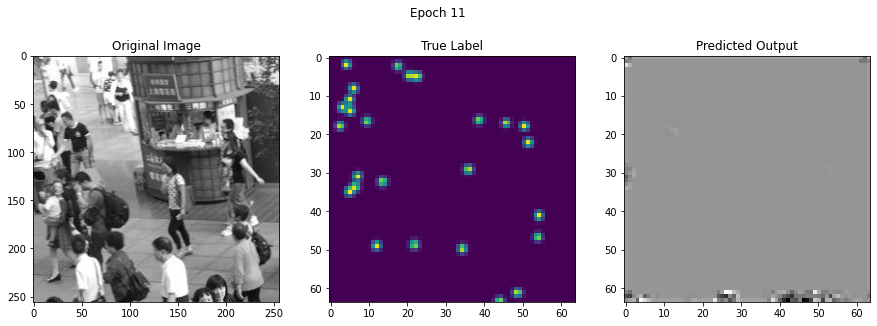

True Number:  tensor(25.5244, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.2382, device='cuda:0')


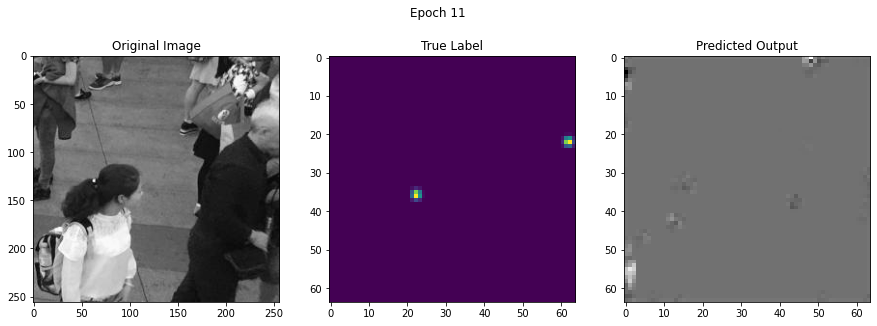

True Number:  tensor(1.9999, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.6973, device='cuda:0')


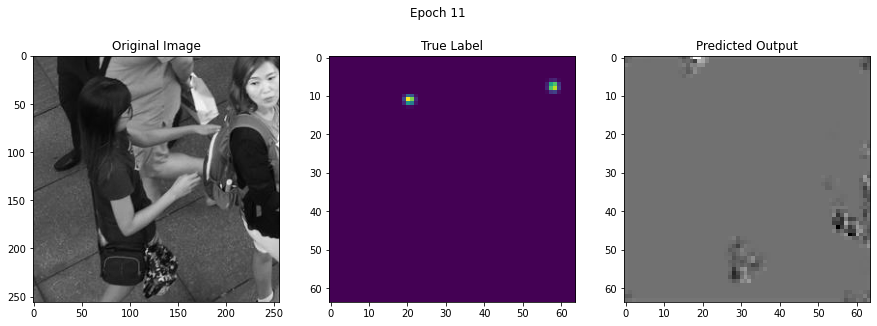

True Number:  tensor(2.0134, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(6.8835, device='cuda:0')


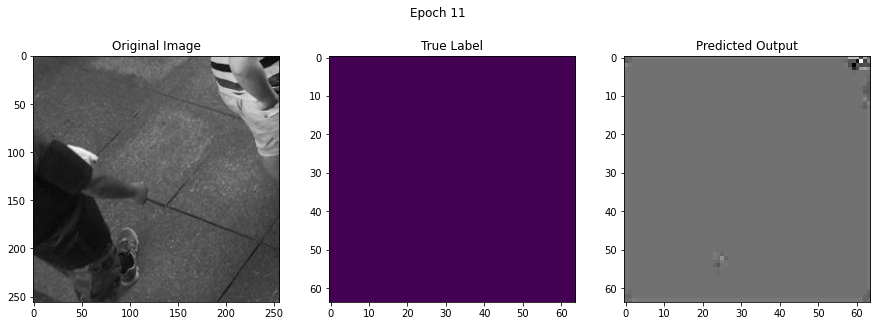

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.3745, device='cuda:0')


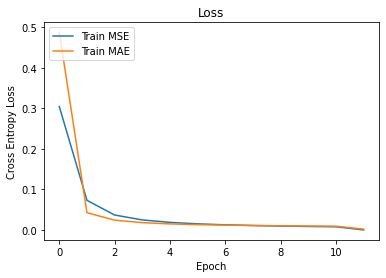

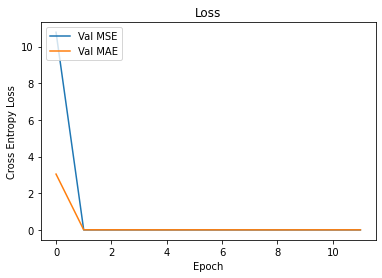

Test Loss MSE:  0.00028970447766424155 Test Loss MAE:  0.0038171781396323986
 Epoch 2,  Iteration   401,  Loss: 0.0004190878
Sum Label:  tensor(27.6966, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(7.2919, device='cuda:0', grad_fn=<SumBackward0>)


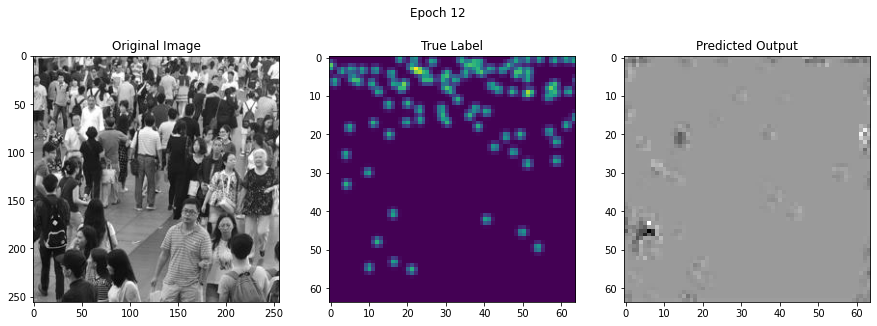

True Number:  tensor(93.4722, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(6.8798, device='cuda:0')


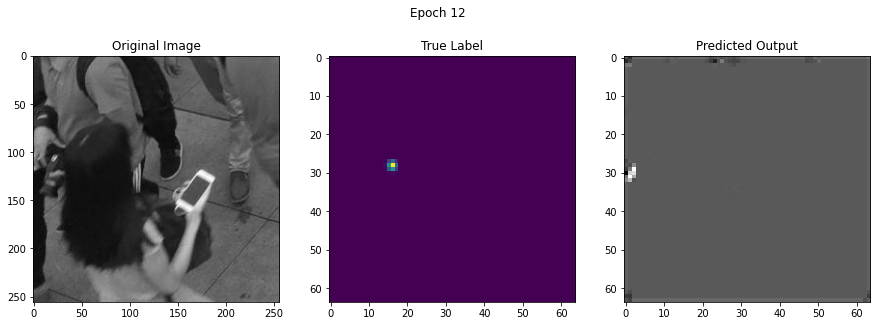

True Number:  tensor(0.9866, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.7080, device='cuda:0')


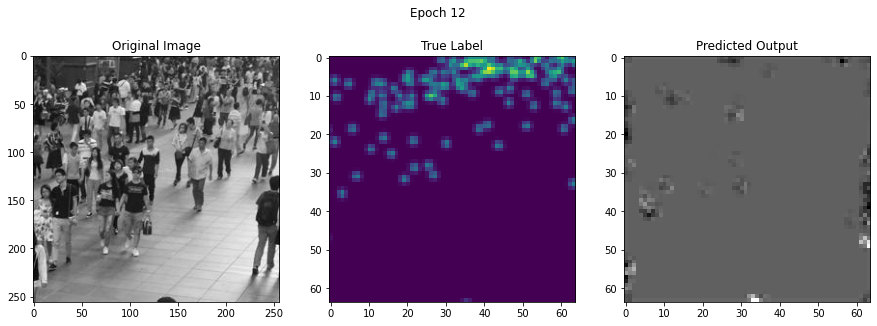

True Number:  tensor(115.4016, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.2537, device='cuda:0')


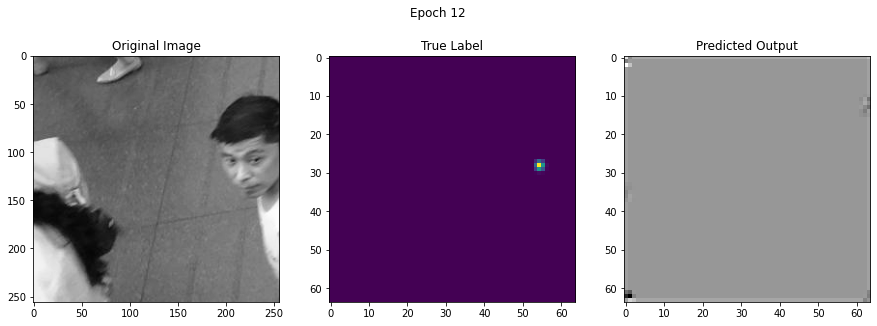

True Number:  tensor(0.9866, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.6803, device='cuda:0')


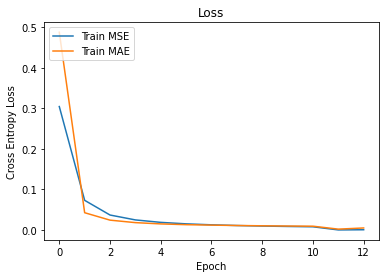

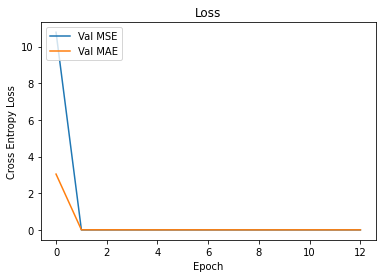

Test Loss MSE:  0.000223683173526113 Test Loss MAE:  0.00337413048272896
 Epoch 2,  Iteration   801,  Loss: 0.0003902839
Sum Label:  tensor(9.0000, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(9.0657, device='cuda:0', grad_fn=<SumBackward0>)


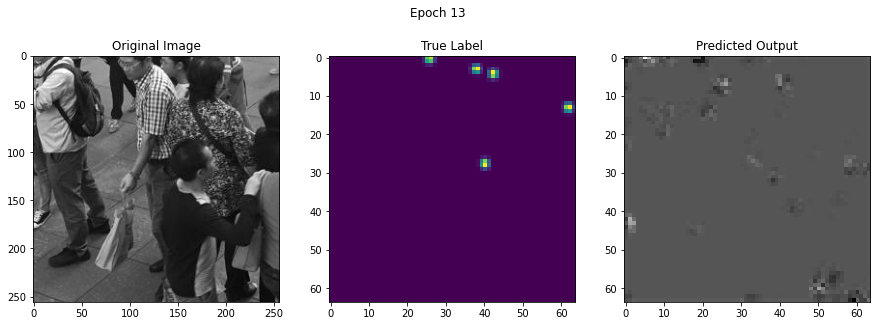

True Number:  tensor(4.9091, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.4410, device='cuda:0')


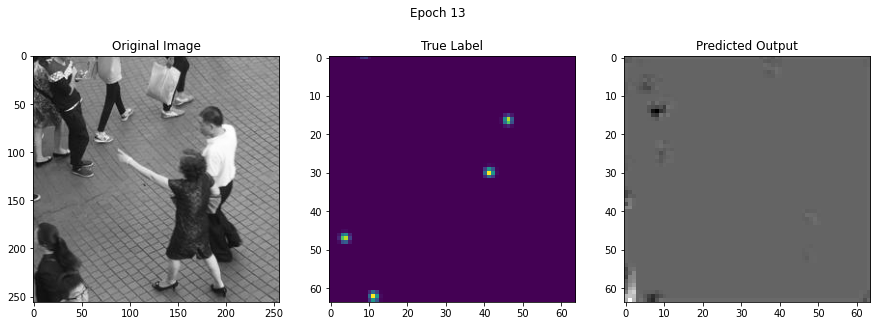

True Number:  tensor(4.0598, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.6131, device='cuda:0')


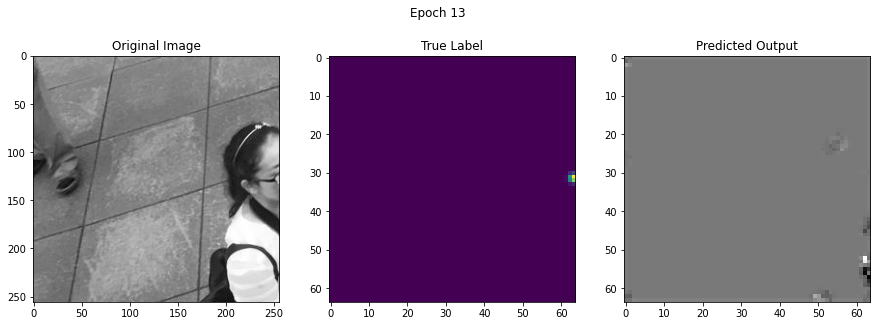

True Number:  tensor(0.8210, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.4579, device='cuda:0')


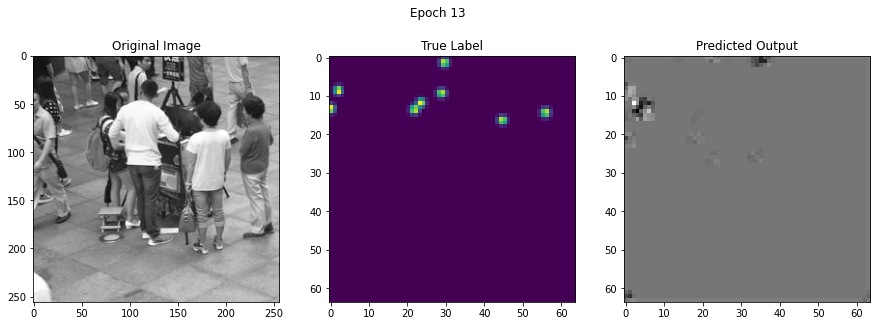

True Number:  tensor(7.7737, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.5066, device='cuda:0')


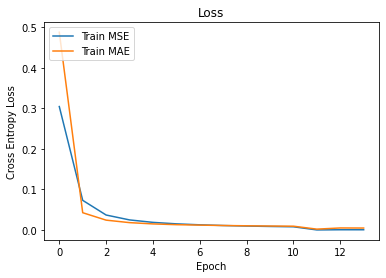

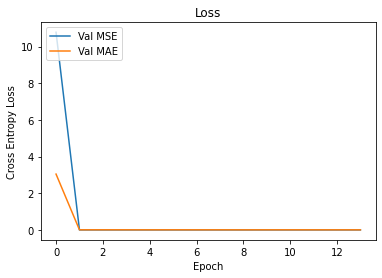

Test Loss MSE:  0.00041068224598145916 Test Loss MAE:  0.004803849344207633
 Epoch 2,  Iteration  1201,  Loss: 0.0004058046
Sum Label:  tensor(0., device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(8.2000, device='cuda:0', grad_fn=<SumBackward0>)


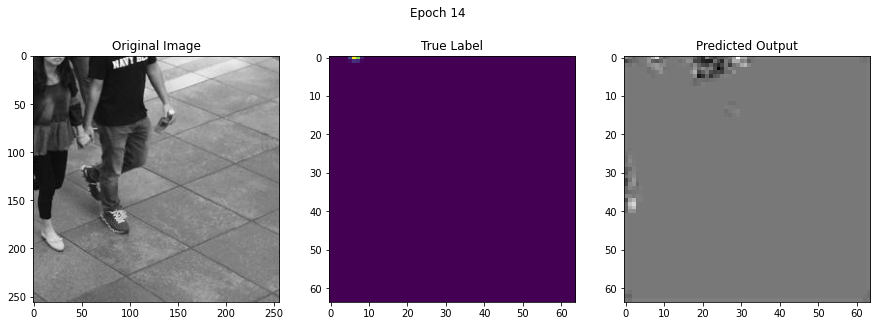

True Number:  tensor(0.4359, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.7196, device='cuda:0')


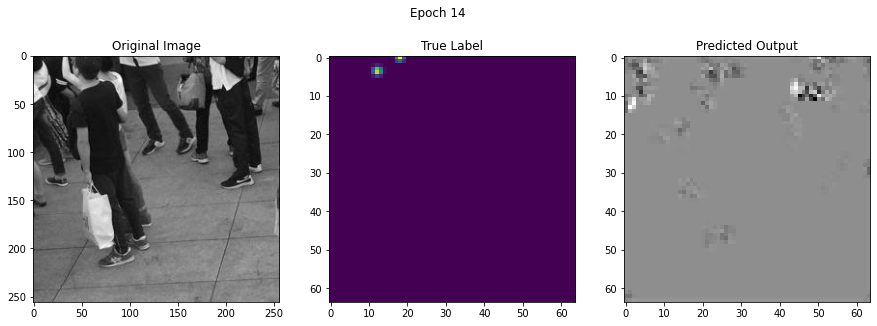

True Number:  tensor(1.6969, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.5517, device='cuda:0')


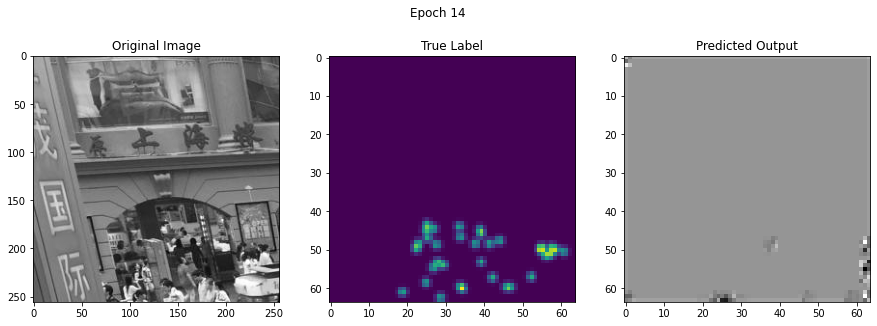

True Number:  tensor(34.0403, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.8828, device='cuda:0')


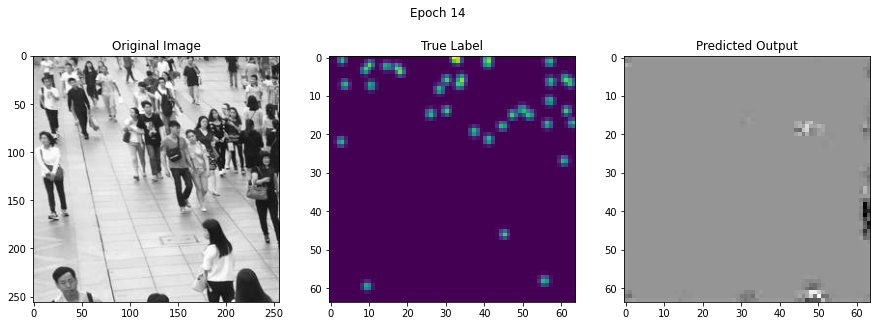

True Number:  tensor(36.4025, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.4800, device='cuda:0')


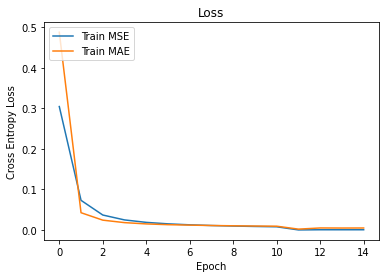

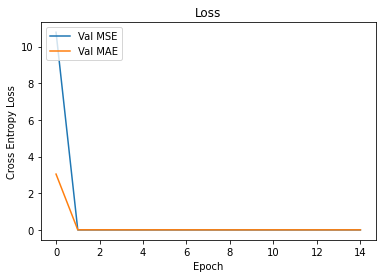

Test Loss MSE:  0.0004440756891732106 Test Loss MAE:  0.004744358851122811
 Epoch 2,  Iteration  1601,  Loss: 0.0004166624
Sum Label:  tensor(5.6796, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(13.0529, device='cuda:0', grad_fn=<SumBackward0>)


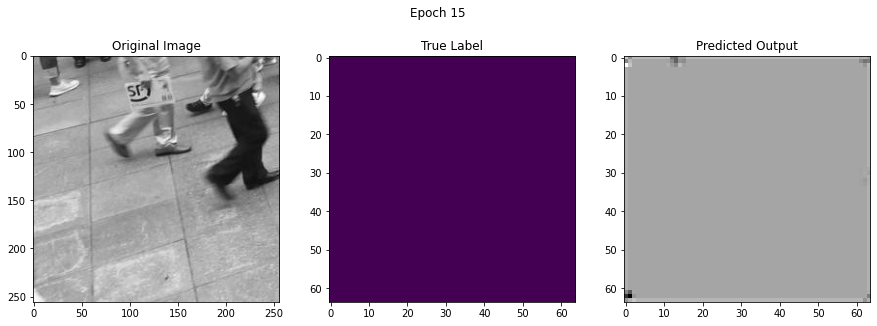

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.2366, device='cuda:0')


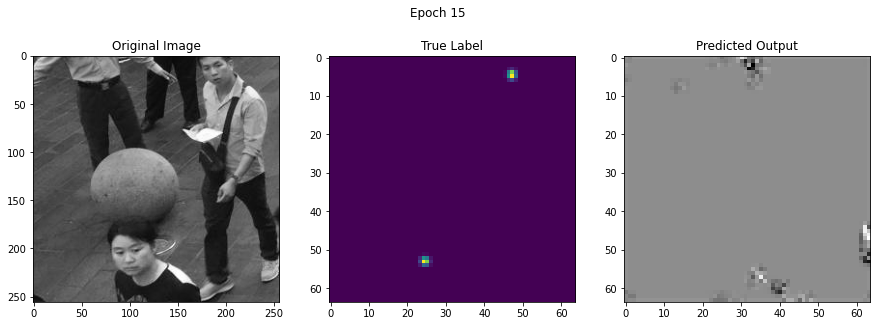

True Number:  tensor(1.9999, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.0510, device='cuda:0')


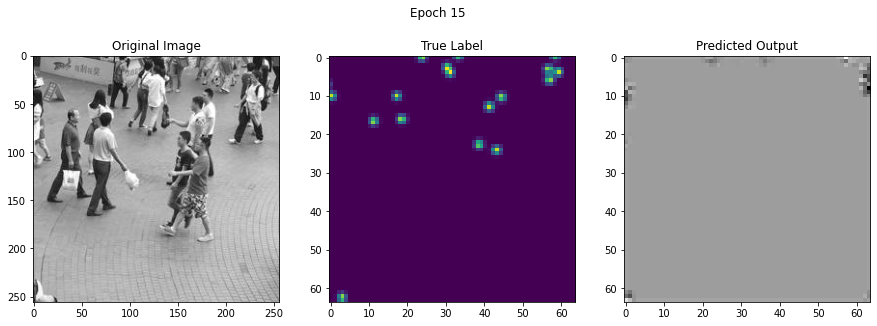

True Number:  tensor(15.3718, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.0990, device='cuda:0')


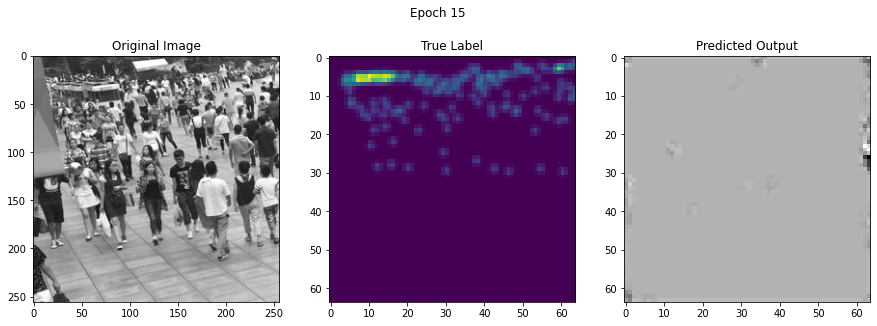

True Number:  tensor(167.2643, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.0481, device='cuda:0')


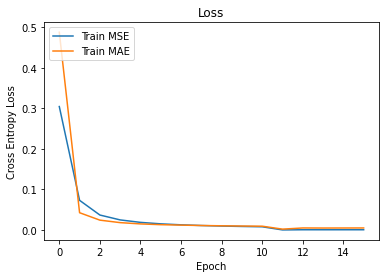

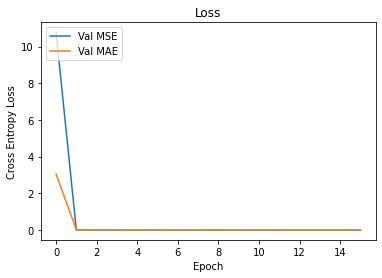

Test Loss MSE:  0.0004846730282242972 Test Loss MAE:  0.005873182167609532
 Epoch 2,  Iteration  2001,  Loss: 0.0004288302
Sum Label:  tensor(1.0000, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(13.0083, device='cuda:0', grad_fn=<SumBackward0>)


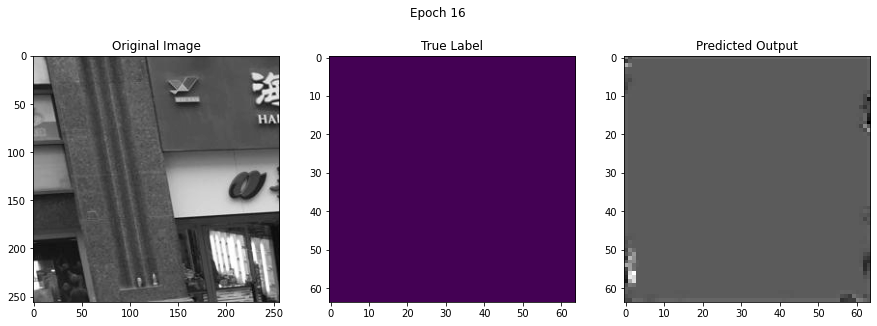

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.5655, device='cuda:0')


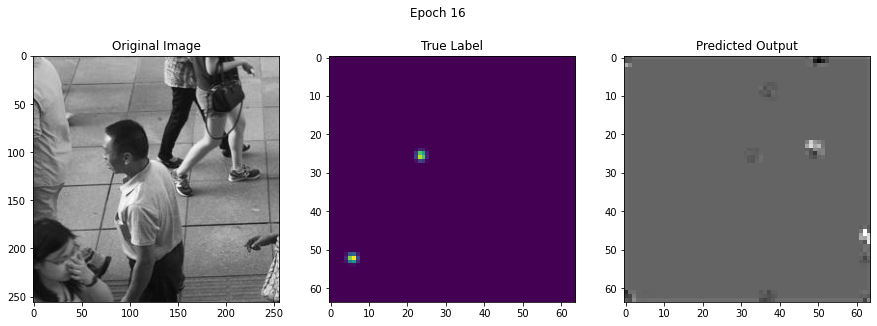

True Number:  tensor(2.0134, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.6245, device='cuda:0')


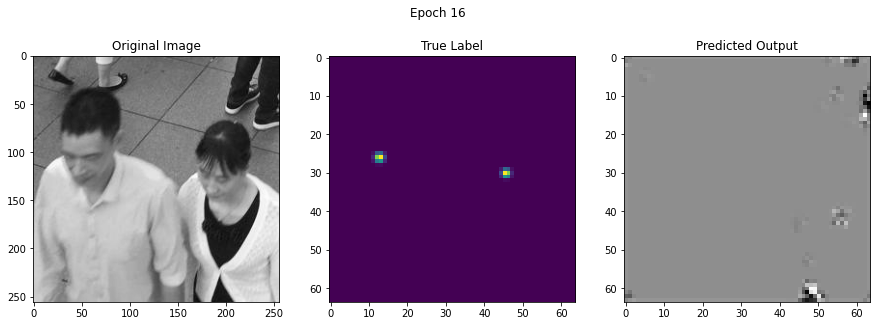

True Number:  tensor(1.9999, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.3984, device='cuda:0')


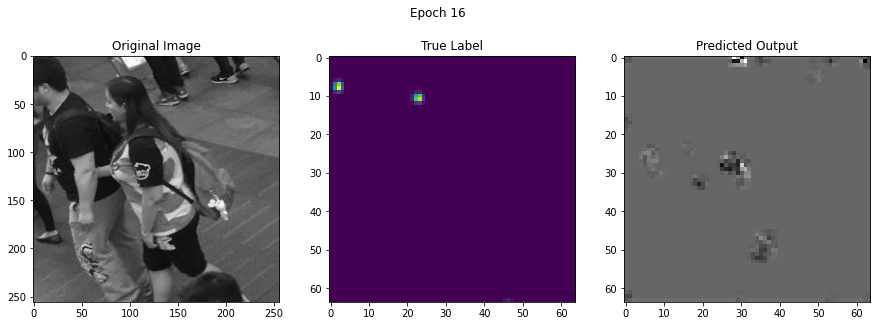

True Number:  tensor(2.0672, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.4082, device='cuda:0')


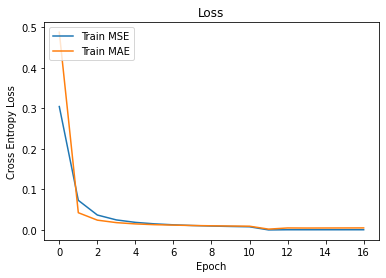

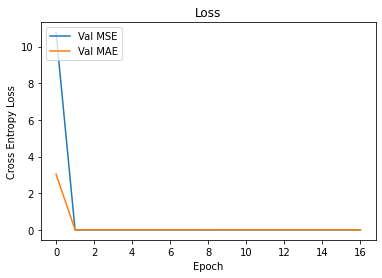

Test Loss MSE:  0.00033800900567285044 Test Loss MAE:  0.0053011462600393725
 Epoch 2,  Iteration  2401,  Loss: 0.0004176667
Sum Label:  tensor(15.8378, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(16.7195, device='cuda:0', grad_fn=<SumBackward0>)


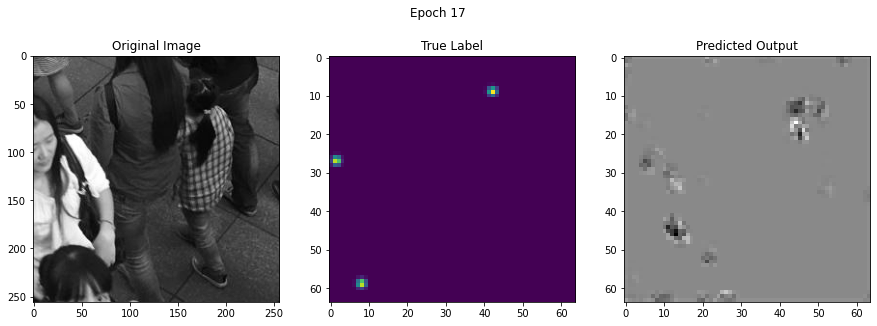

True Number:  tensor(2.9865, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(16.5914, device='cuda:0')


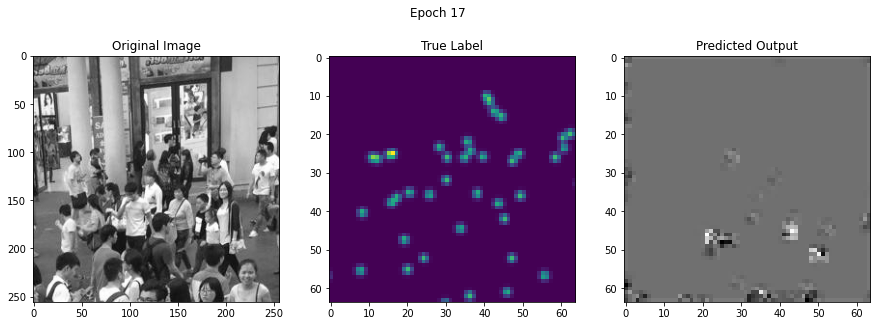

True Number:  tensor(39.3399, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(16.6815, device='cuda:0')


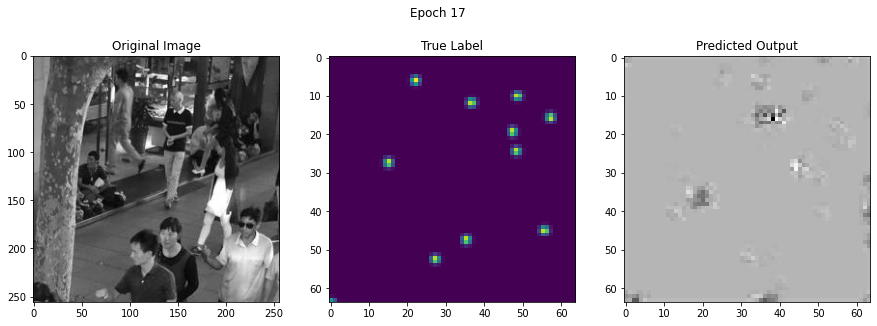

True Number:  tensor(10.2240, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(16.3017, device='cuda:0')


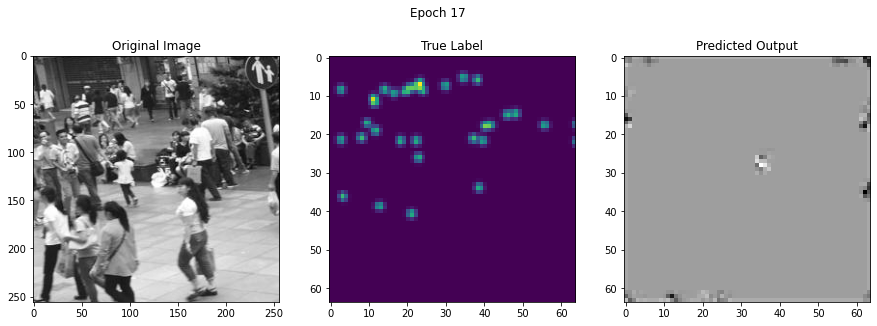

True Number:  tensor(31.6504, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(16.6481, device='cuda:0')


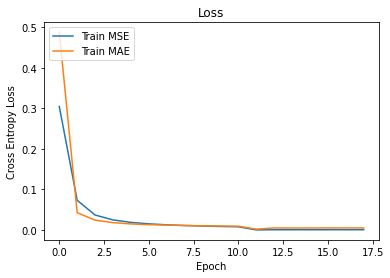

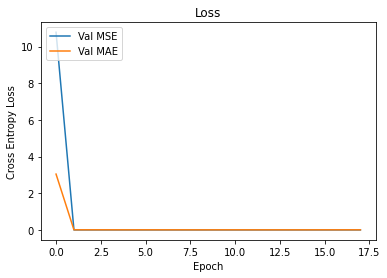

Test Loss MSE:  0.00034380399825529435 Test Loss MAE:  0.006065971462639293
 Epoch 2,  Iteration  2801,  Loss: 0.0004170687
Sum Label:  tensor(0., device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(13.4726, device='cuda:0', grad_fn=<SumBackward0>)


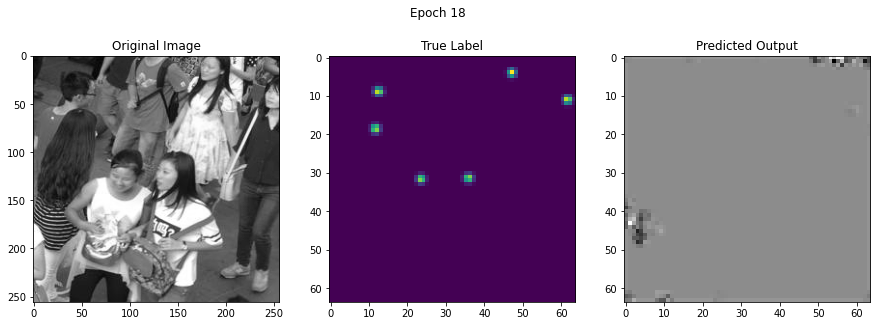

True Number:  tensor(6.0270, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.2513, device='cuda:0')


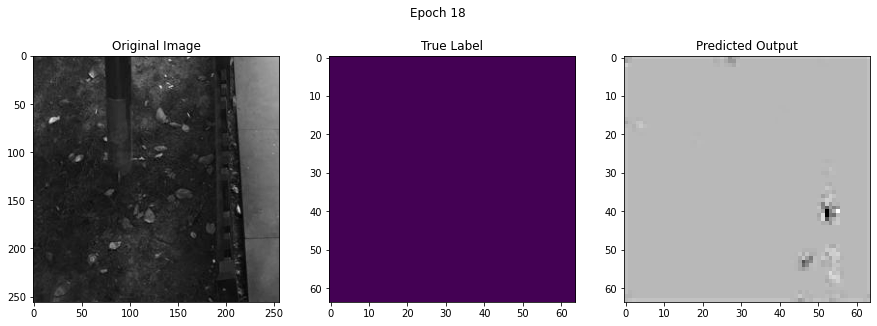

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.3200, device='cuda:0')


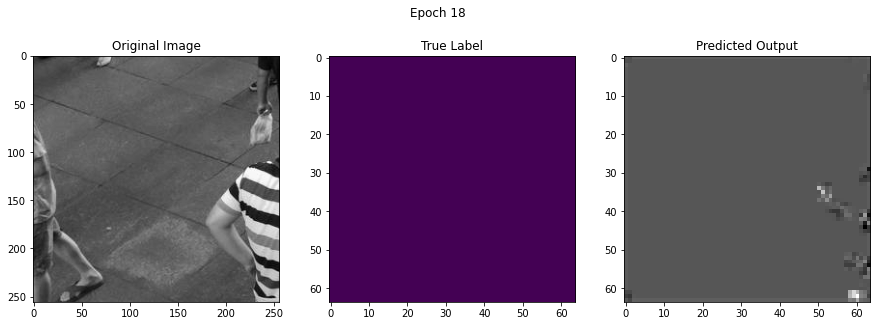

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.4783, device='cuda:0')


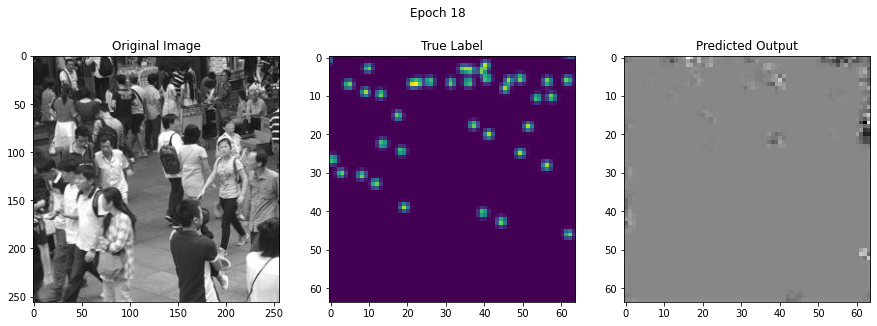

True Number:  tensor(37.3278, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.2003, device='cuda:0')


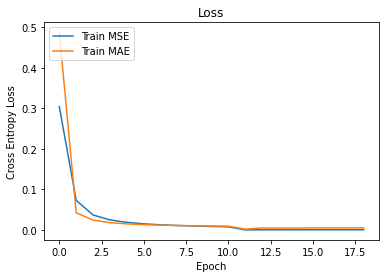

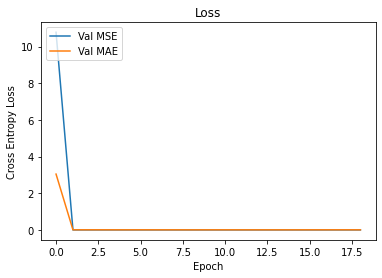

Test Loss MSE:  0.0002597270125382541 Test Loss MAE:  0.004821483255128818
 Epoch 2,  Iteration  3201,  Loss: 0.0004112596
Sum Label:  tensor(0., device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(7.4378, device='cuda:0', grad_fn=<SumBackward0>)


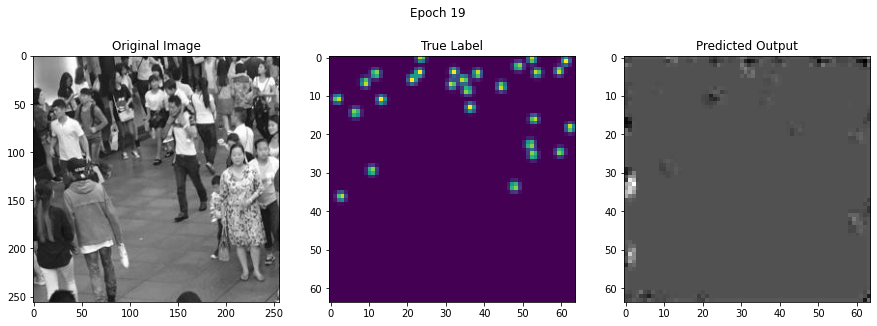

True Number:  tensor(27.7232, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.1925, device='cuda:0')


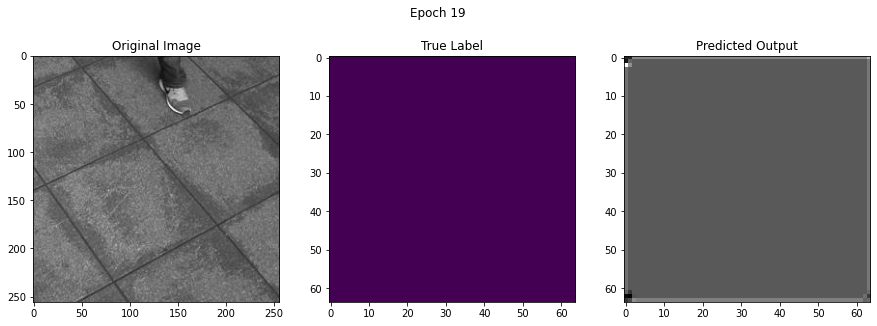

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.1567, device='cuda:0')


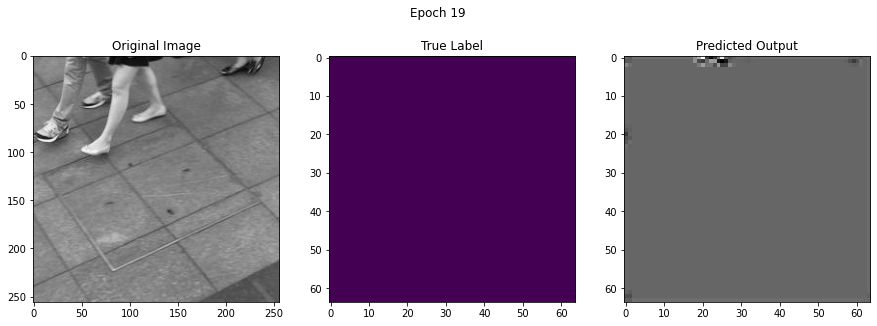

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.1348, device='cuda:0')


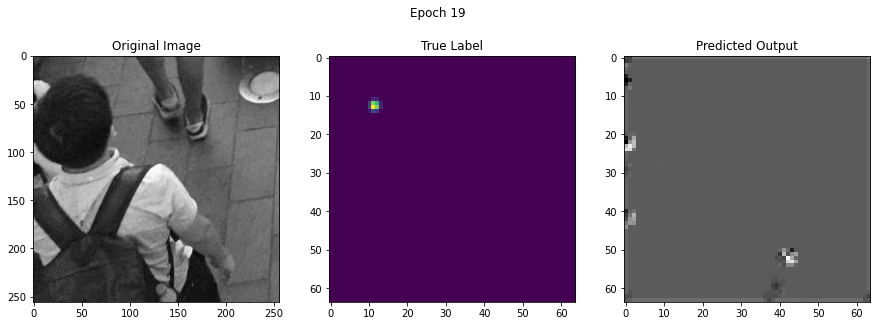

True Number:  tensor(1.0135, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.1956, device='cuda:0')


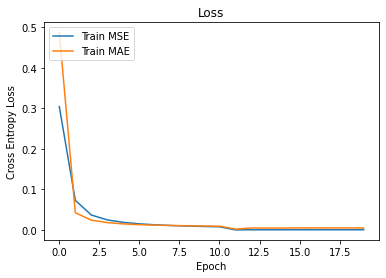

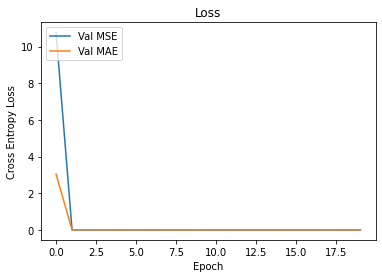

Test Loss MSE:  0.00044112101391240714 Test Loss MAE:  0.004015924203247208
 Epoch 2,  Iteration  3601,  Loss: 0.0004211930
Sum Label:  tensor(0., device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(14.4808, device='cuda:0', grad_fn=<SumBackward0>)


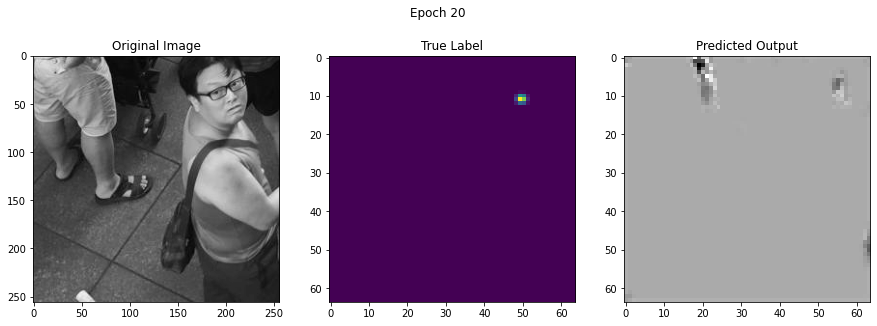

True Number:  tensor(1.0000, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(14.4475, device='cuda:0')


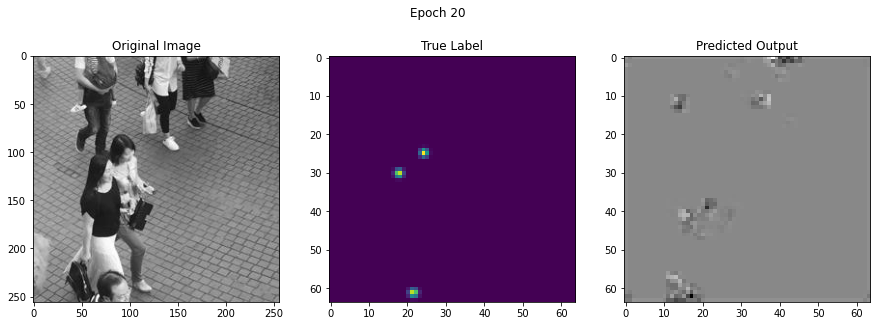

True Number:  tensor(2.9865, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(14.4723, device='cuda:0')


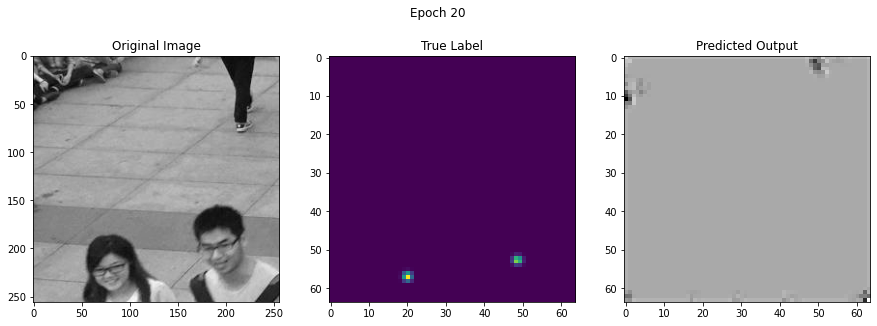

True Number:  tensor(2.0001, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(14.5245, device='cuda:0')


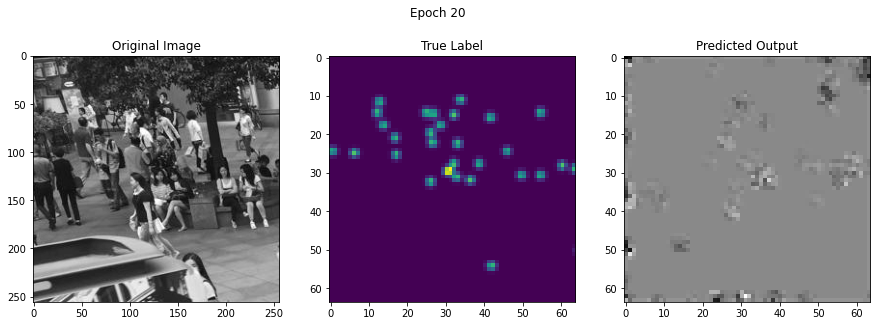

True Number:  tensor(29.6271, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(14.3134, device='cuda:0')


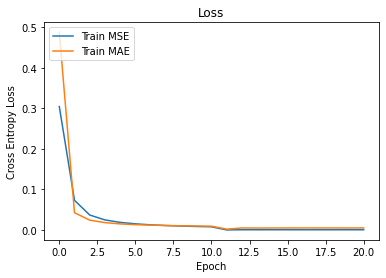

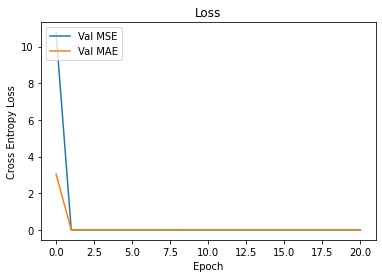

Test Loss MSE:  0.00034039238034158116 Test Loss MAE:  0.005378441699319566
 Epoch 2,  Iteration  4001,  Loss: 0.0004197121
Sum Label:  tensor(2.8211, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(7.8269, device='cuda:0', grad_fn=<SumBackward0>)


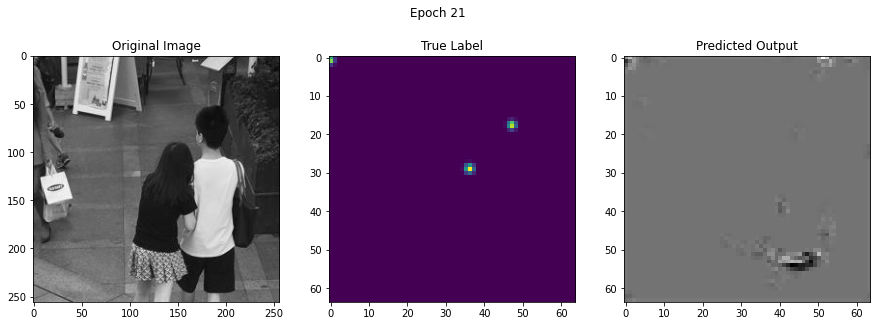

True Number:  tensor(2.5331, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.7290, device='cuda:0')


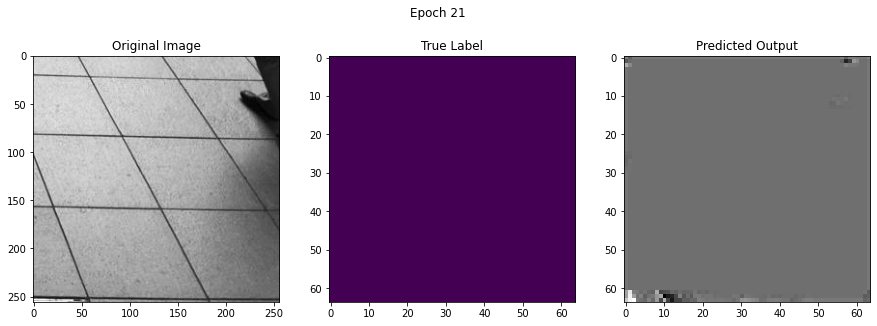

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.7844, device='cuda:0')


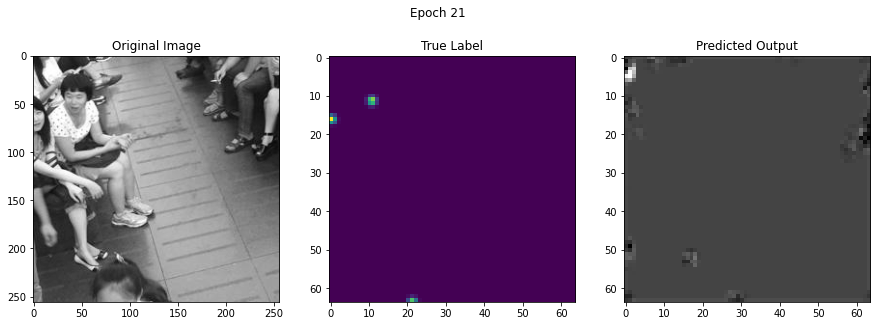

True Number:  tensor(2.2535, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.8038, device='cuda:0')


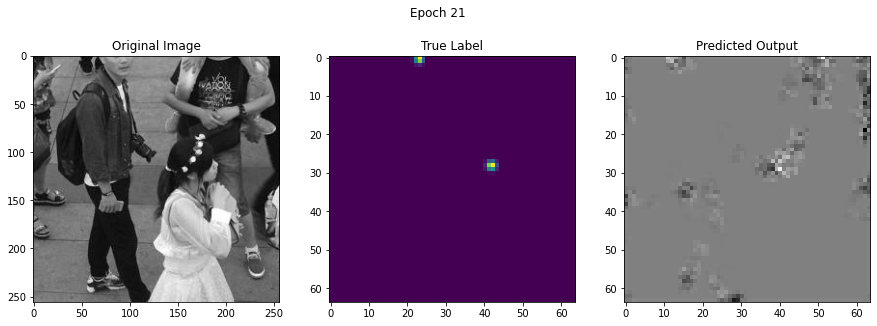

True Number:  tensor(1.8970, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.5097, device='cuda:0')


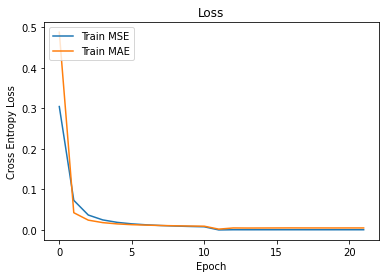

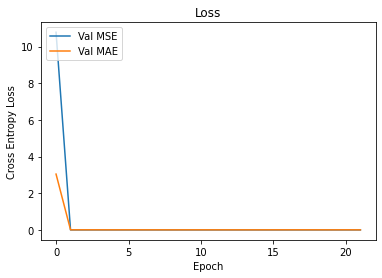

Test Loss MSE:  0.0003997913489396836 Test Loss MAE:  0.004203868320804428
**********Epoch: 3 **********
 Epoch 3,  Iteration     1,  Loss: 0.0000050718
Sum Label:  tensor(0., device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(9.2097, device='cuda:0', grad_fn=<SumBackward0>)


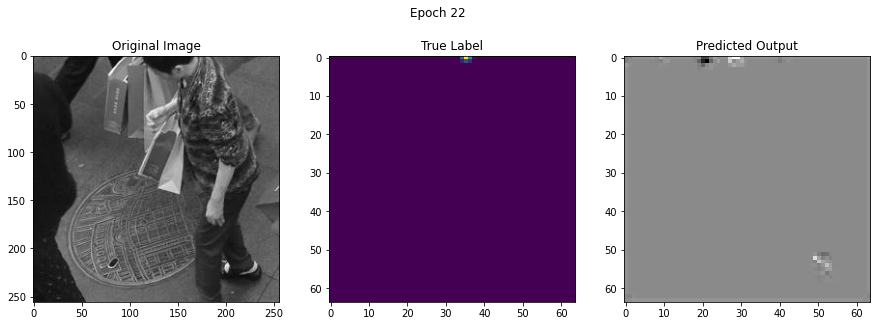

True Number:  tensor(0.5699, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.2405, device='cuda:0')


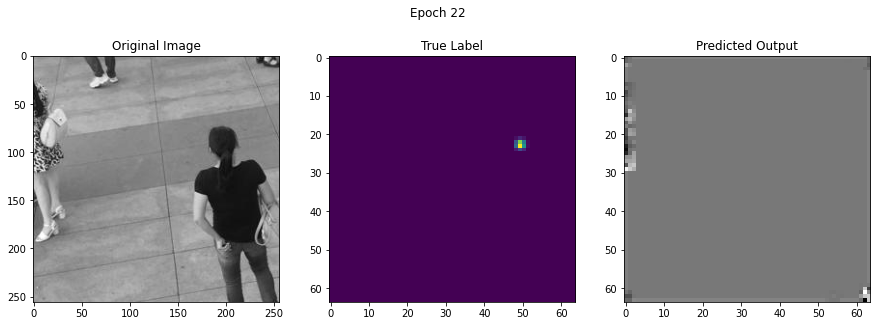

True Number:  tensor(1.0000, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.2302, device='cuda:0')


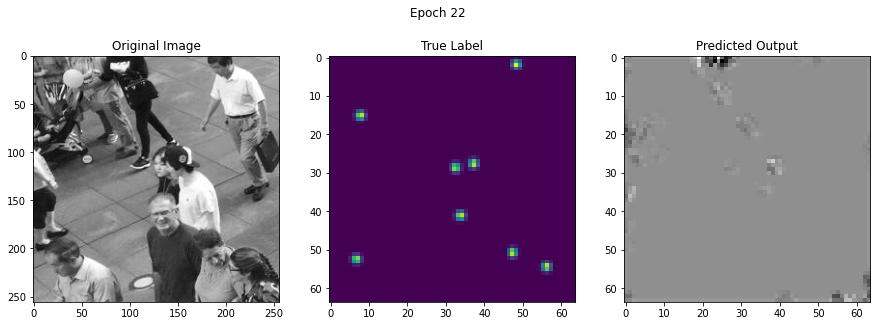

True Number:  tensor(8.0133, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.0509, device='cuda:0')


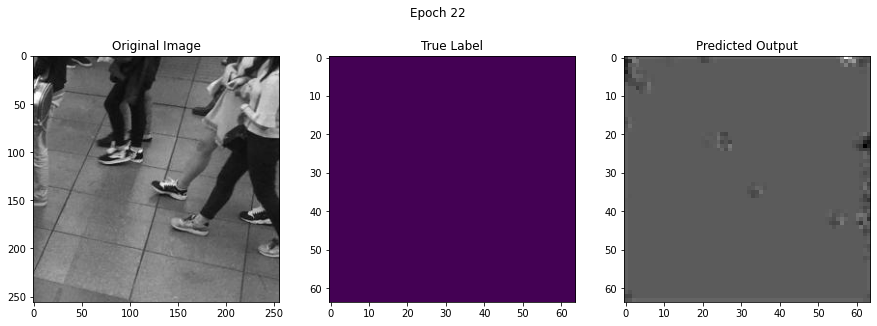

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.1570, device='cuda:0')


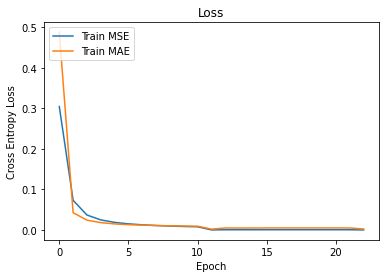

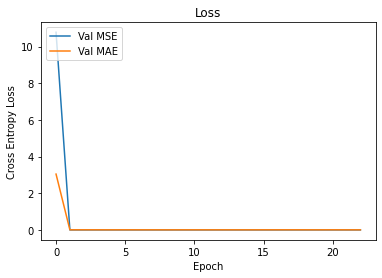

Test Loss MSE:  0.00036099370464224266 Test Loss MAE:  0.004283402051607316
 Epoch 3,  Iteration   401,  Loss: 0.0004531143
Sum Label:  tensor(7.8523, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(8.7050, device='cuda:0', grad_fn=<SumBackward0>)


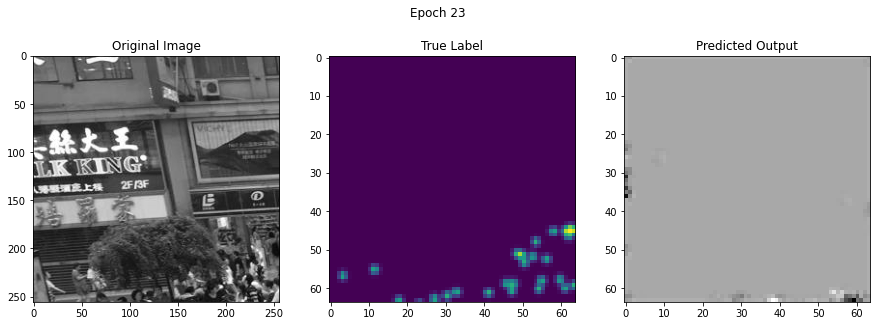

True Number:  tensor(25.2416, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.6065, device='cuda:0')


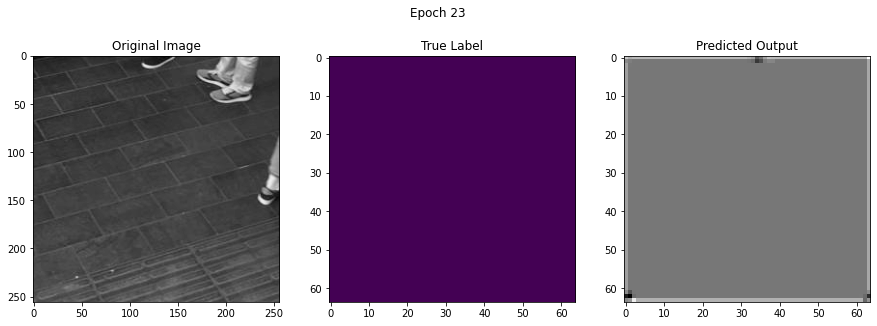

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.7299, device='cuda:0')


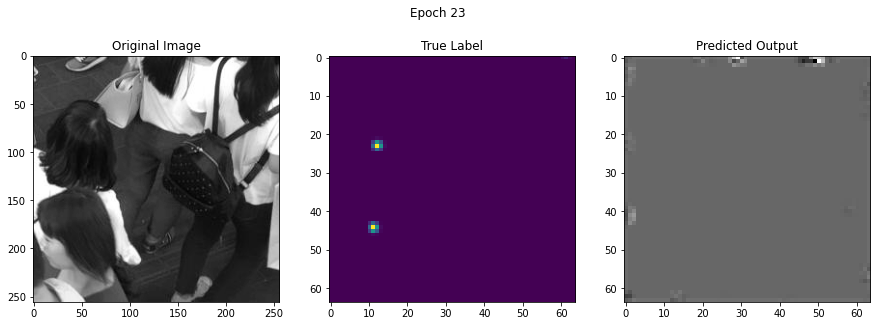

True Number:  tensor(2.0270, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.7748, device='cuda:0')


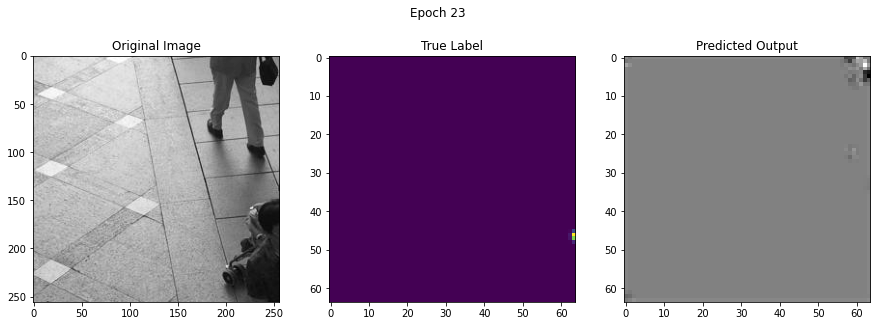

True Number:  tensor(0.2936, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.6869, device='cuda:0')


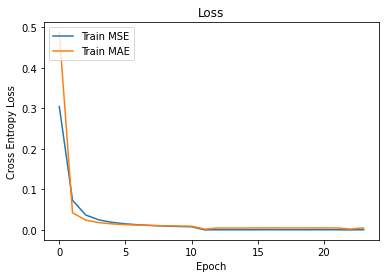

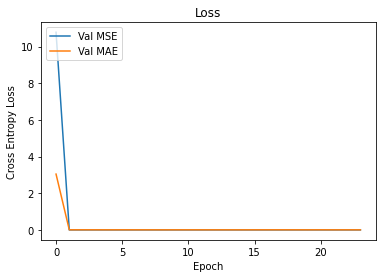

Test Loss MSE:  0.0004185262281809095 Test Loss MAE:  0.004555811138936516
 Epoch 3,  Iteration   801,  Loss: 0.0004634614
Sum Label:  tensor(2.0134, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(13.4076, device='cuda:0', grad_fn=<SumBackward0>)


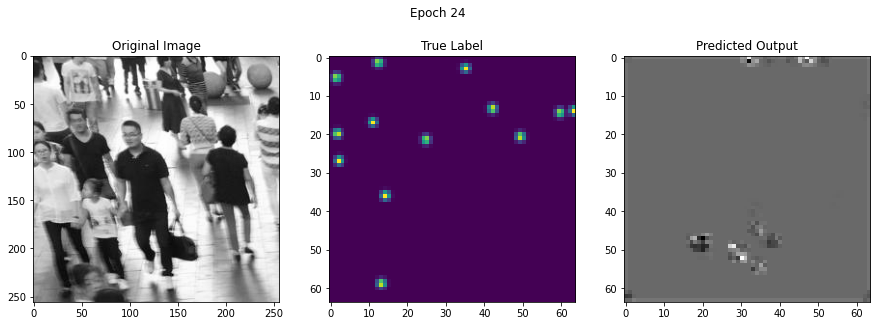

True Number:  tensor(12.6971, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.6715, device='cuda:0')


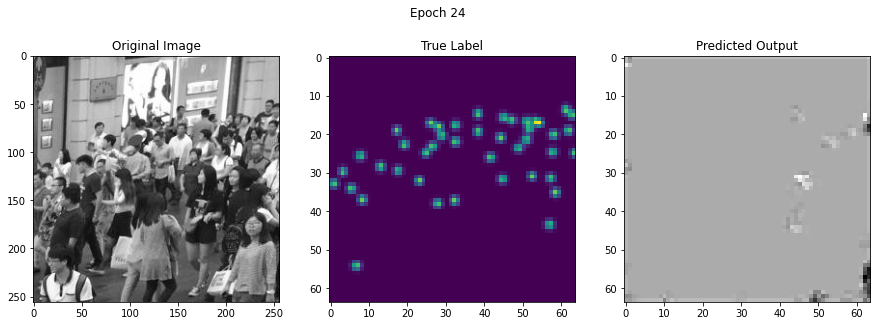

True Number:  tensor(42.4578, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.5718, device='cuda:0')


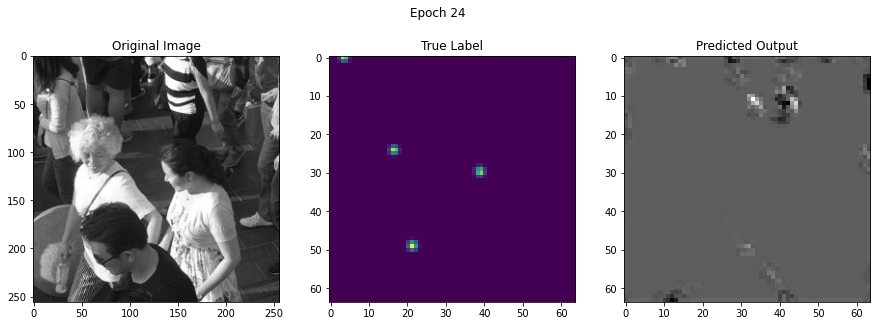

True Number:  tensor(3.7064, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.5685, device='cuda:0')


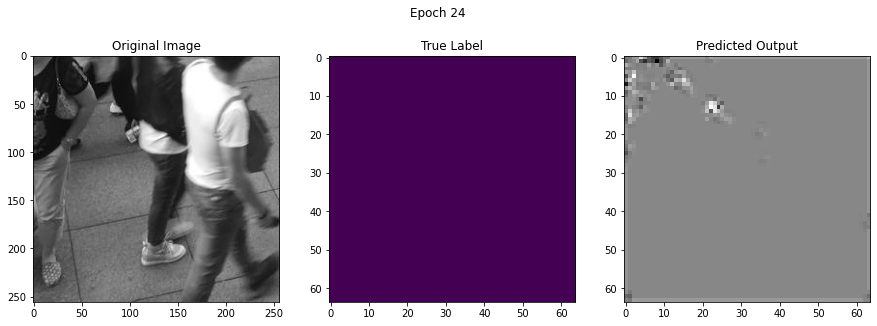

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.6540, device='cuda:0')


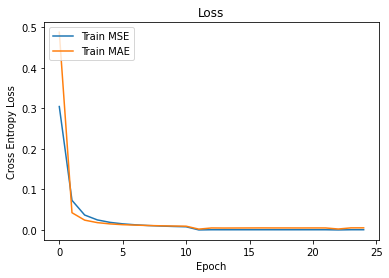

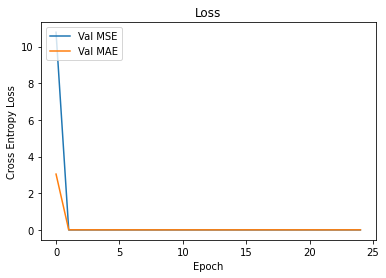

Test Loss MSE:  0.0003226673508944452 Test Loss MAE:  0.005255657306994603
 Epoch 3,  Iteration  1201,  Loss: 0.0004442048
Sum Label:  tensor(6.5700, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(7.1545, device='cuda:0', grad_fn=<SumBackward0>)


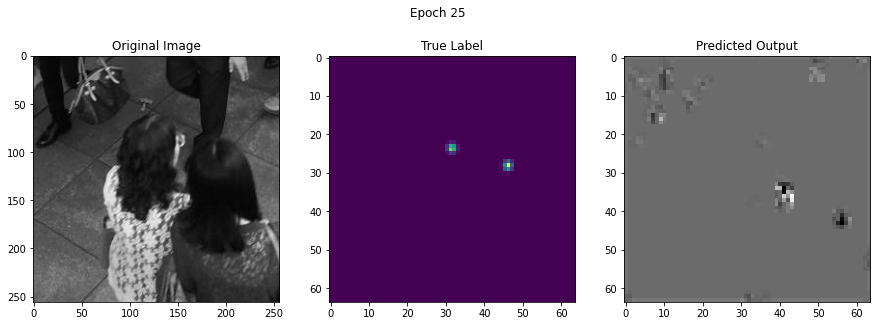

True Number:  tensor(2.0001, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.4429, device='cuda:0')


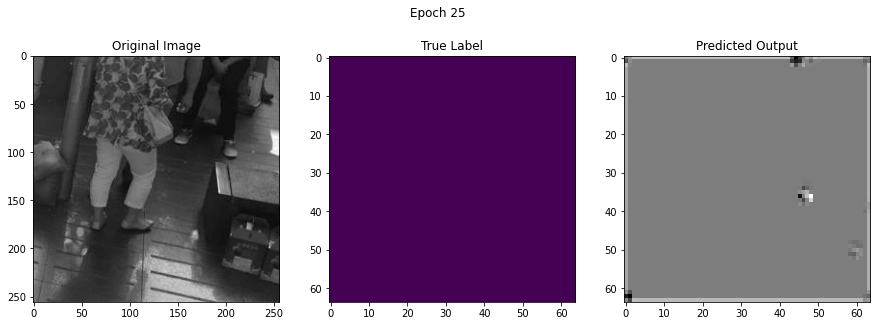

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.4559, device='cuda:0')


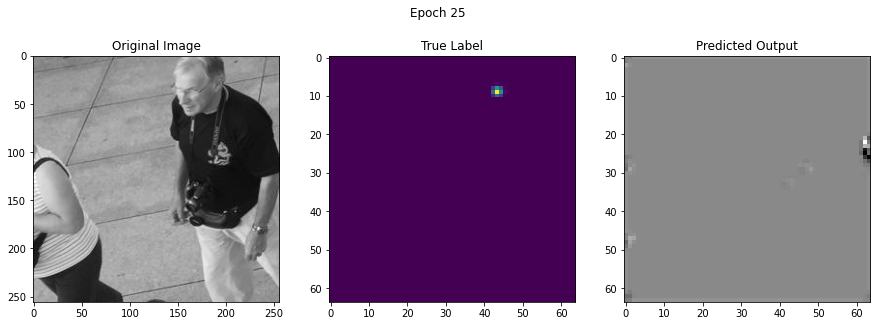

True Number:  tensor(0.9866, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.4319, device='cuda:0')


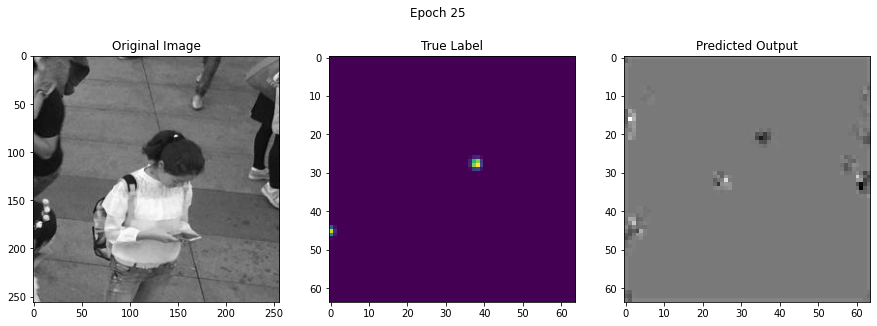

True Number:  tensor(1.4435, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.4058, device='cuda:0')


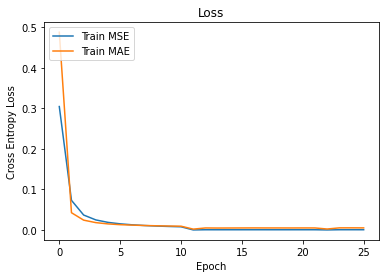

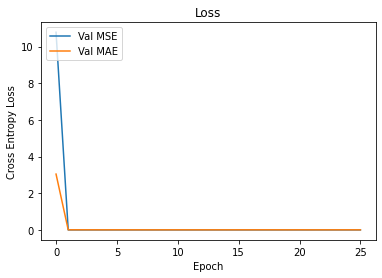

Test Loss MSE:  0.0004202100855529738 Test Loss MAE:  0.004168347213323219
 Epoch 3,  Iteration  1601,  Loss: 0.0004419056
Sum Label:  tensor(8.0002, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(7.8723, device='cuda:0', grad_fn=<SumBackward0>)


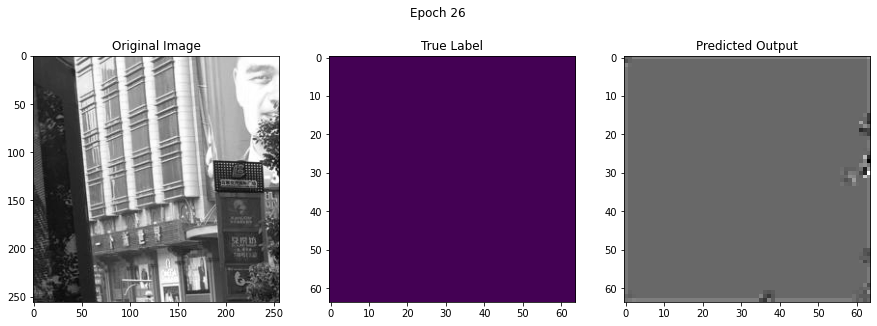

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.9369, device='cuda:0')


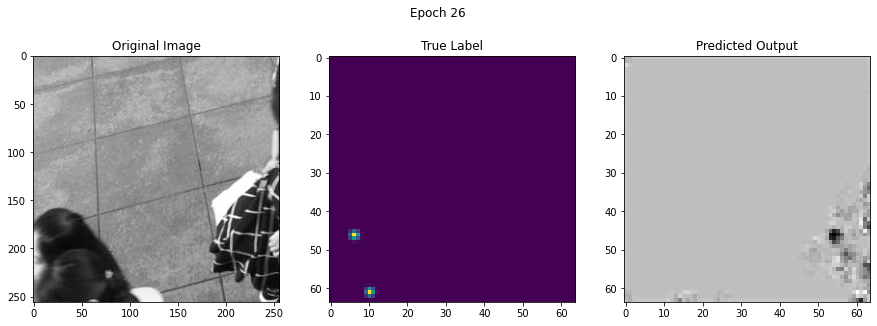

True Number:  tensor(1.9732, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.6087, device='cuda:0')


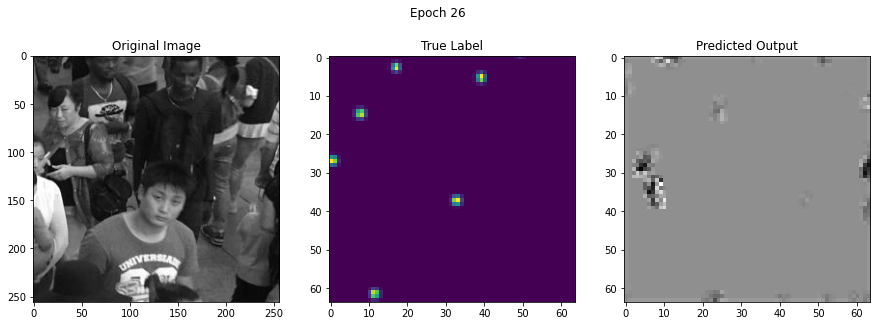

True Number:  tensor(5.9777, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.8412, device='cuda:0')


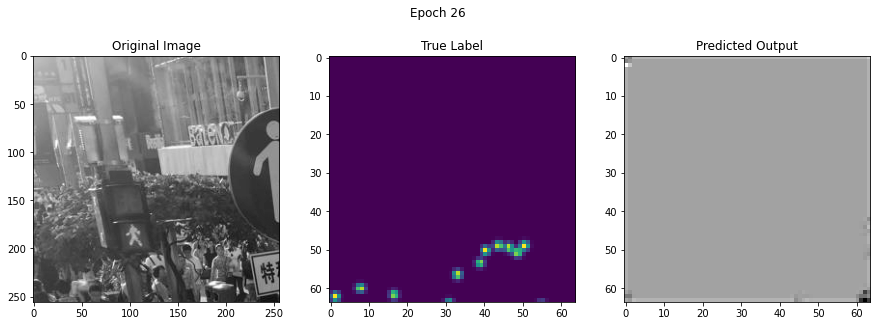

True Number:  tensor(10.3804, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.9295, device='cuda:0')


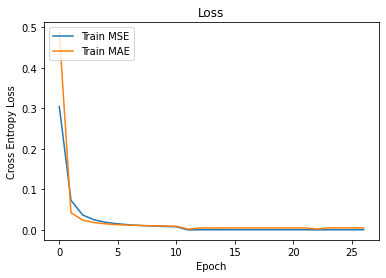

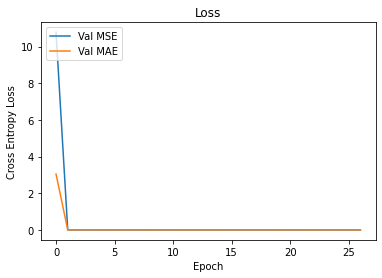

Test Loss MSE:  0.00032784508386446925 Test Loss MAE:  0.003855521741294951
 Epoch 3,  Iteration  2001,  Loss: 0.0004322781
Sum Label:  tensor(6.4125, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(11.4145, device='cuda:0', grad_fn=<SumBackward0>)


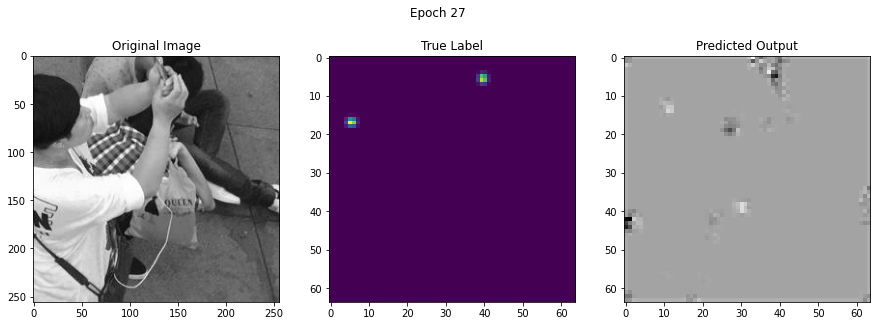

True Number:  tensor(2.0134, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.3117, device='cuda:0')


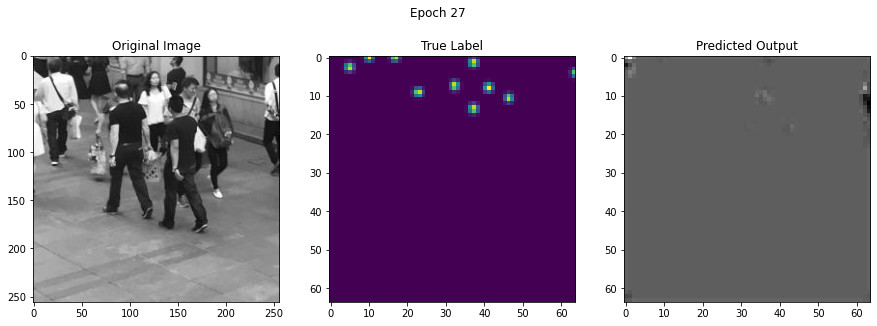

True Number:  tensor(8.8197, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.3538, device='cuda:0')


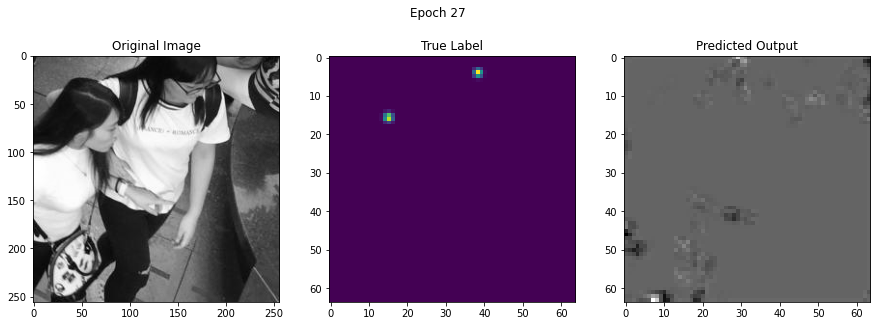

True Number:  tensor(1.9866, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.1686, device='cuda:0')


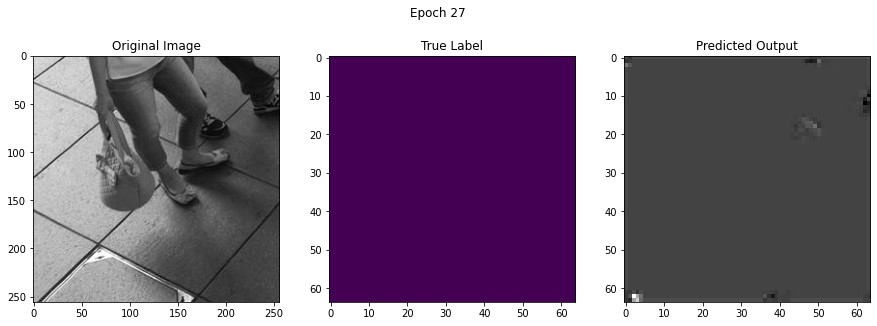

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.3831, device='cuda:0')


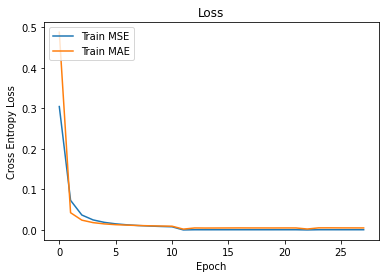

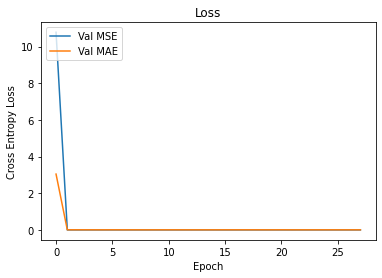

Test Loss MSE:  0.0004848066294774374 Test Loss MAE:  0.005321352662650322
 Epoch 3,  Iteration  2401,  Loss: 0.0004391469
Sum Label:  tensor(3.0000, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(9.7362, device='cuda:0', grad_fn=<SumBackward0>)


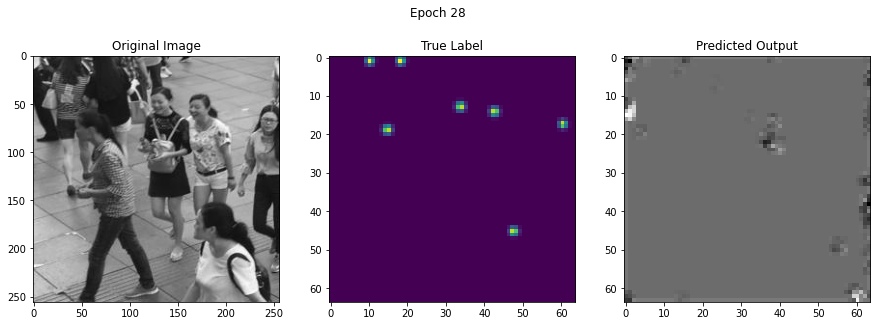

True Number:  tensor(6.9378, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.7486, device='cuda:0')


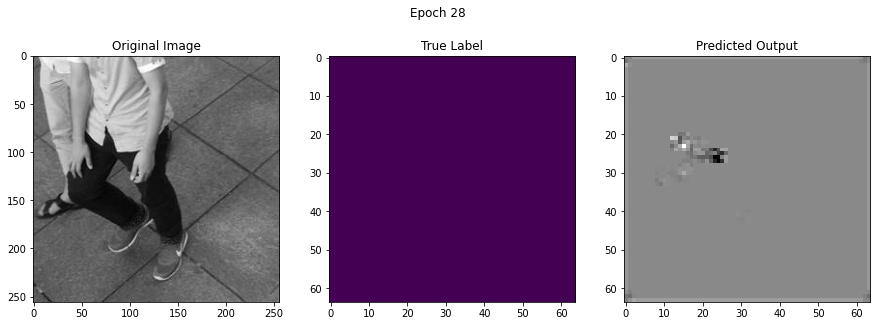

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.7629, device='cuda:0')


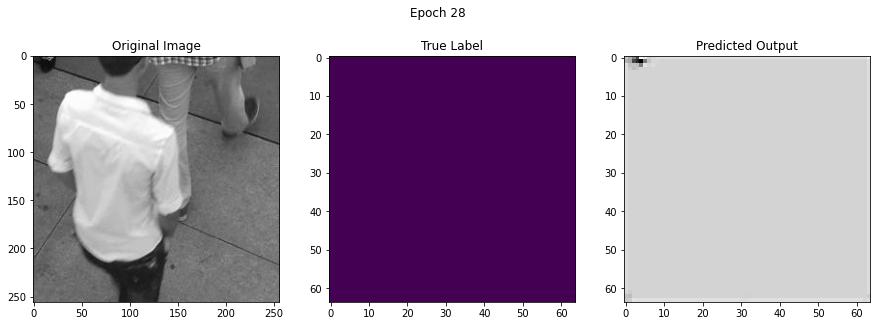

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.7540, device='cuda:0')


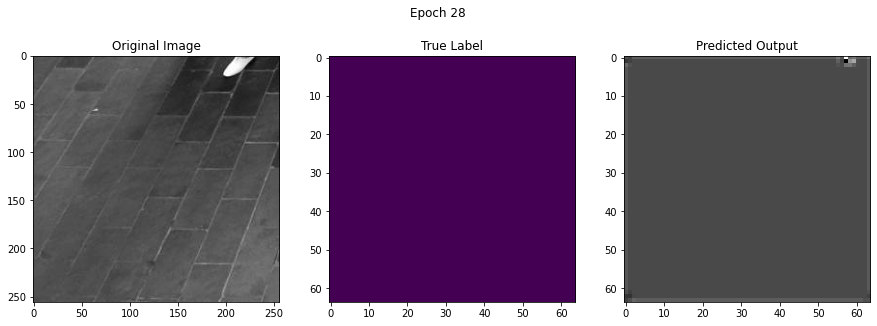

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.7910, device='cuda:0')


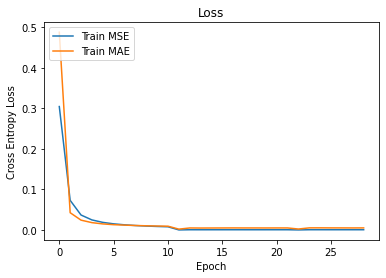

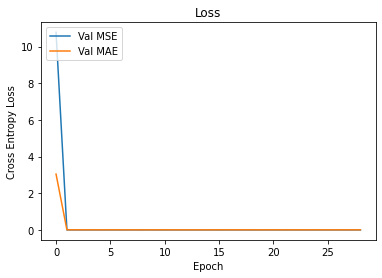

Test Loss MSE:  0.0003303738146103275 Test Loss MAE:  0.004282538793190863
 Epoch 3,  Iteration  2801,  Loss: 0.0004276792
Sum Label:  tensor(20.1399, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(11.2834, device='cuda:0', grad_fn=<SumBackward0>)


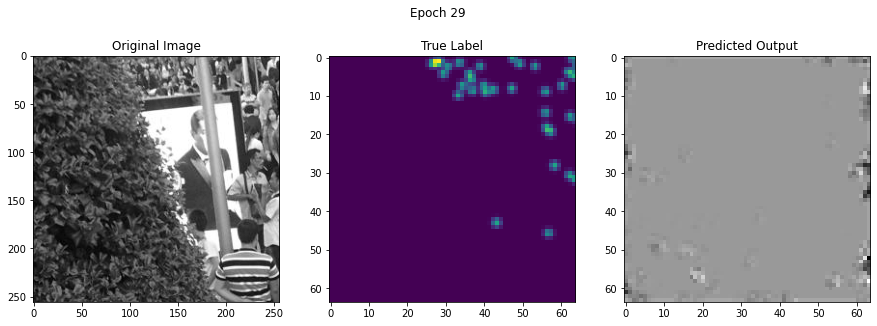

True Number:  tensor(32.3721, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.1018, device='cuda:0')


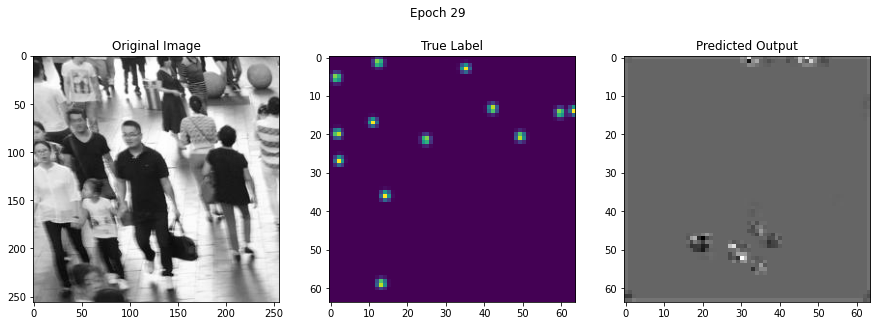

True Number:  tensor(12.6971, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.2113, device='cuda:0')


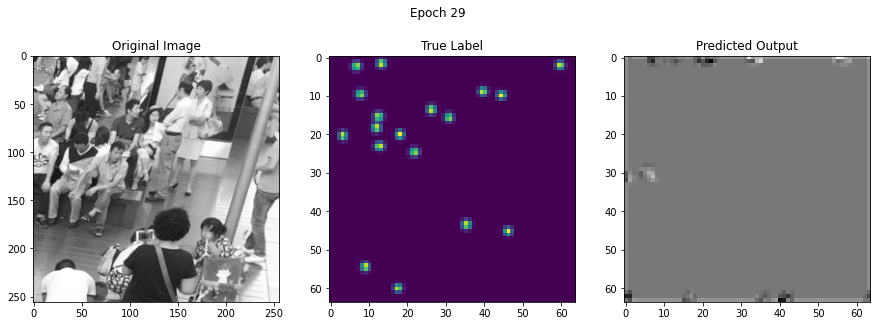

True Number:  tensor(18.0268, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.1903, device='cuda:0')


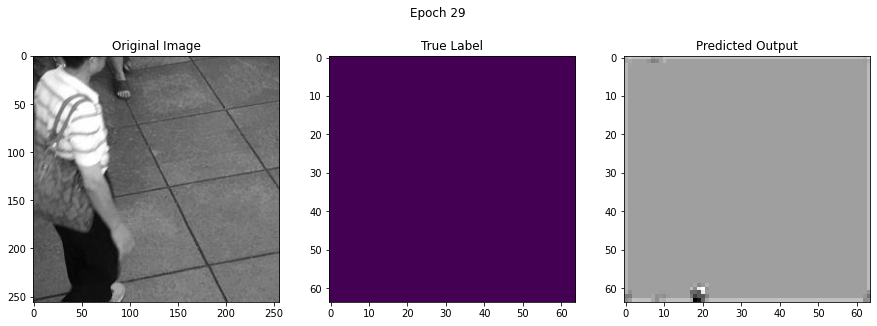

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.1965, device='cuda:0')


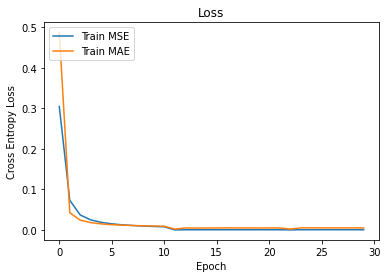

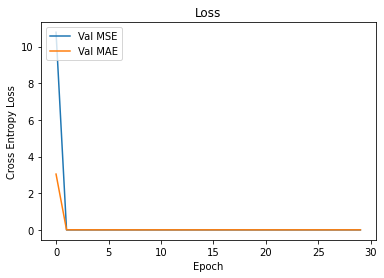

Test Loss MSE:  0.00028344558074762735 Test Loss MAE:  0.004420020220086279
 Epoch 3,  Iteration  3201,  Loss: 0.0004287209
Sum Label:  tensor(0., device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(10.1834, device='cuda:0', grad_fn=<SumBackward0>)


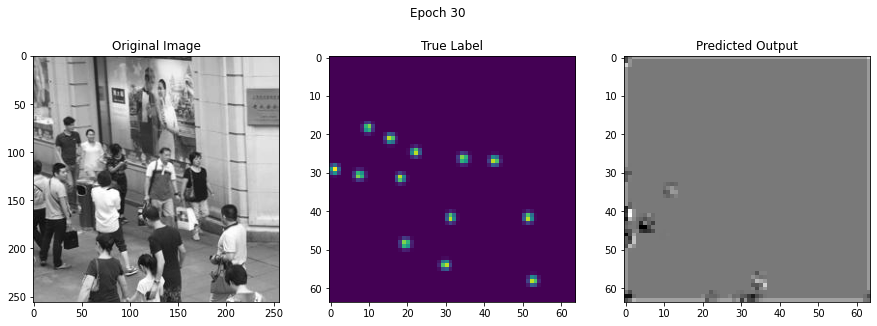

True Number:  tensor(13.0226, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.0671, device='cuda:0')


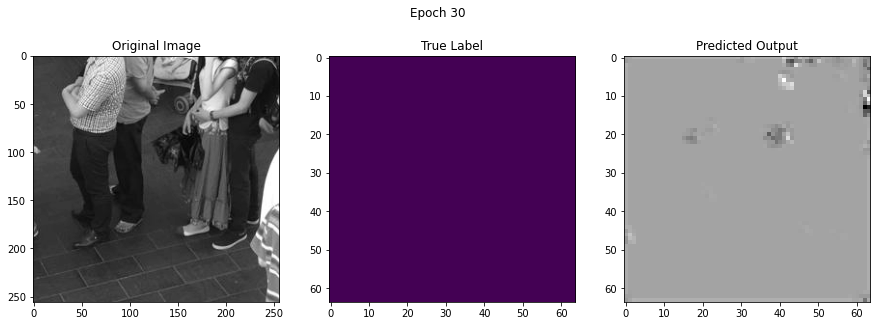

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.0240, device='cuda:0')


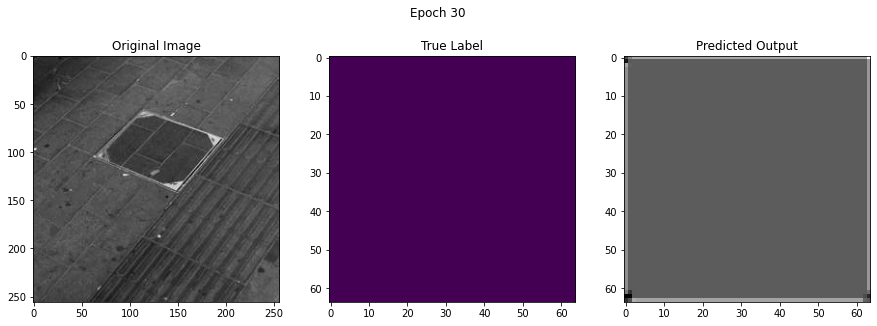

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.0846, device='cuda:0')


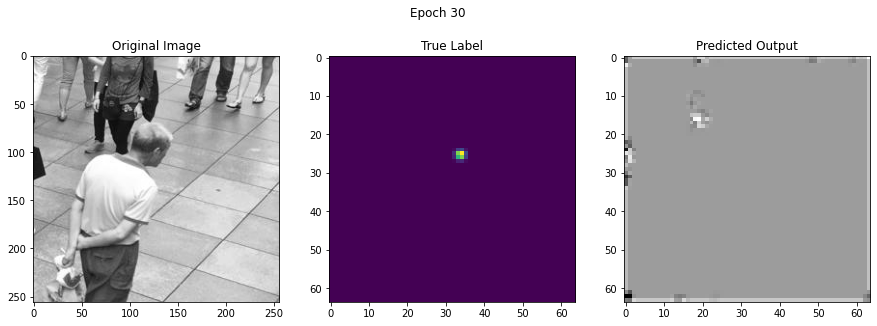

True Number:  tensor(1.0135, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.0778, device='cuda:0')


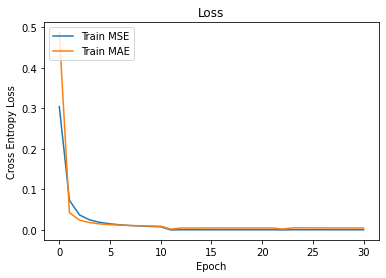

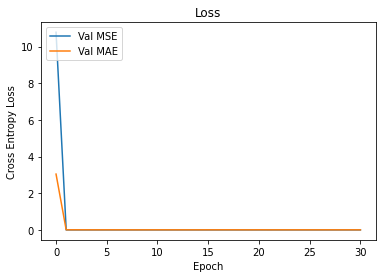

Test Loss MSE:  0.0006165185866462487 Test Loss MAE:  0.005818247924455338
 Epoch 3,  Iteration  3601,  Loss: 0.0004256178
Sum Label:  tensor(2.0313, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(9.3468, device='cuda:0', grad_fn=<SumBackward0>)


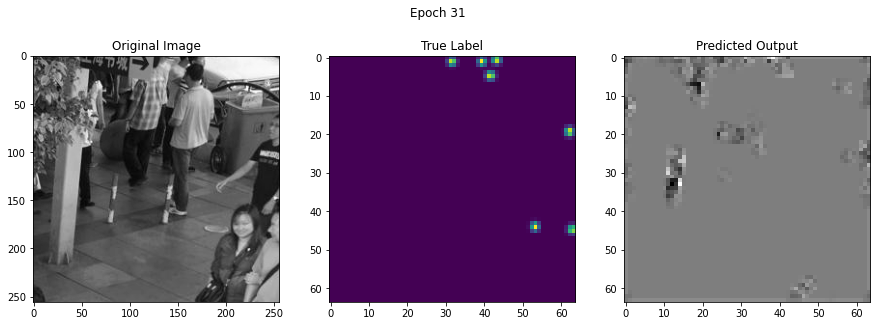

True Number:  tensor(6.8285, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.4013, device='cuda:0')


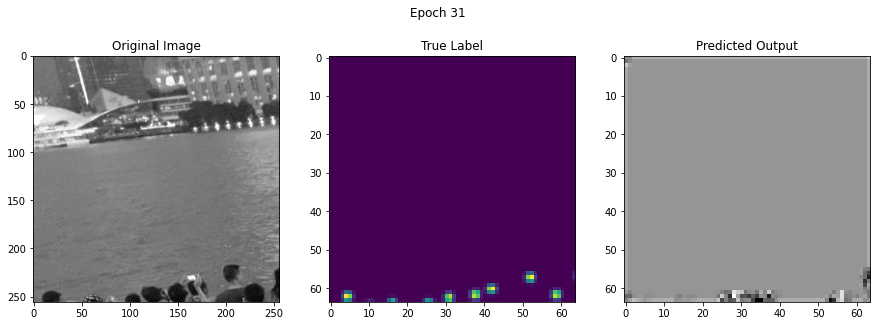

True Number:  tensor(6.6595, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.4363, device='cuda:0')


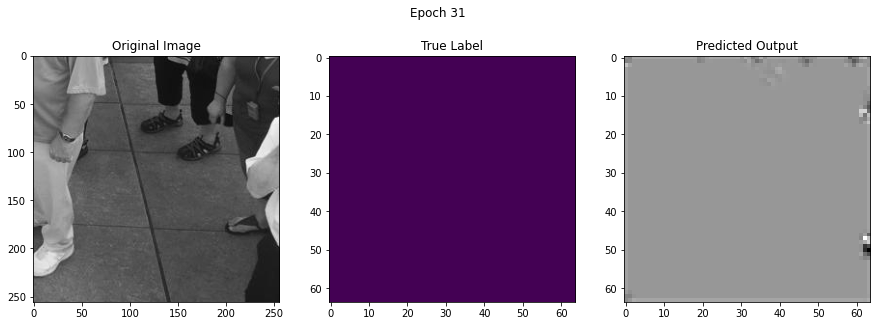

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.4397, device='cuda:0')


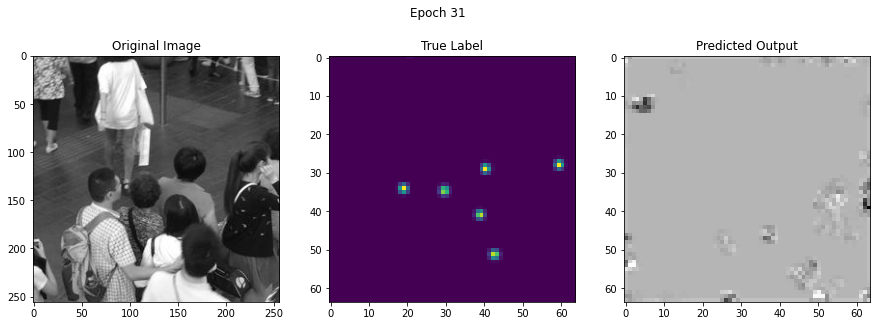

True Number:  tensor(5.9910, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.3717, device='cuda:0')


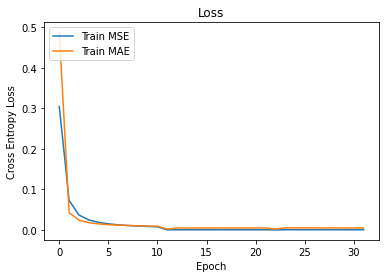

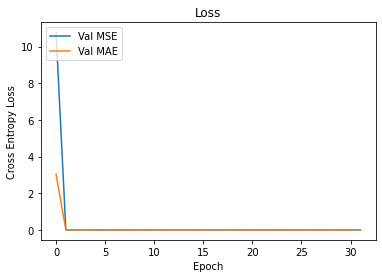

Test Loss MSE:  0.0006192376759790564 Test Loss MAE:  0.0052922841542485085
 Epoch 3,  Iteration  4001,  Loss: 0.0004250540
Sum Label:  tensor(0., device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(8.4847, device='cuda:0', grad_fn=<SumBackward0>)


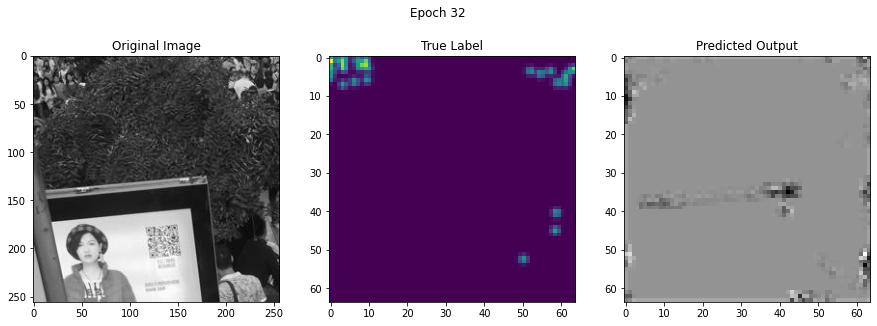

True Number:  tensor(25.0682, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.2225, device='cuda:0')


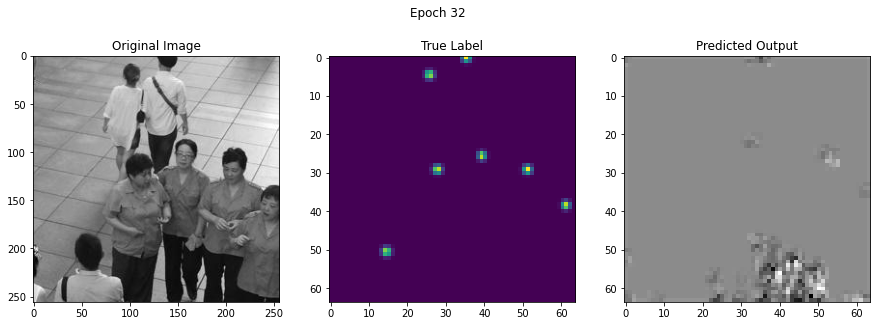

True Number:  tensor(6.8234, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.1927, device='cuda:0')


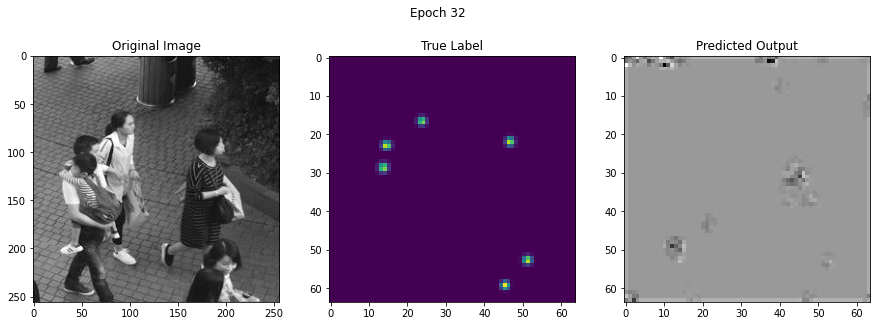

True Number:  tensor(6.0134, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.2921, device='cuda:0')


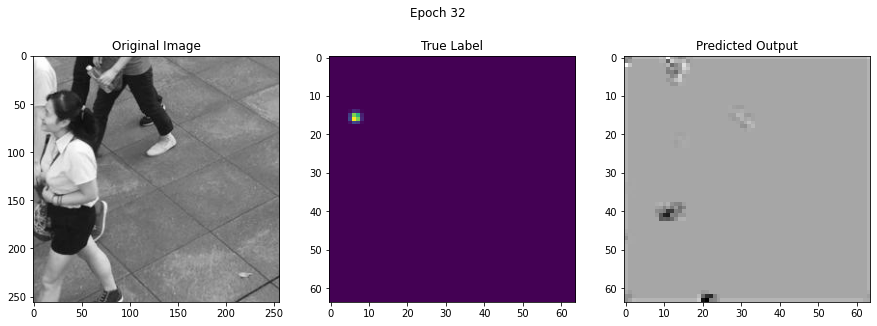

True Number:  tensor(1.0135, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.2858, device='cuda:0')


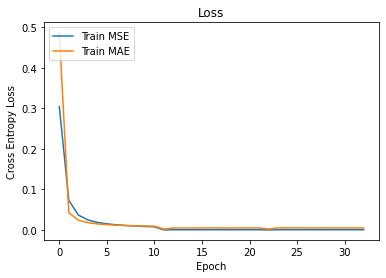

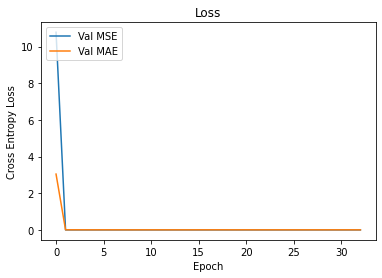

Test Loss MSE:  0.0003849773783019713 Test Loss MAE:  0.0041037031538746875
**********Epoch: 4 **********
 Epoch 4,  Iteration     1,  Loss: 0.0013988987
Sum Label:  tensor(33.8256, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(7.4699, device='cuda:0', grad_fn=<SumBackward0>)


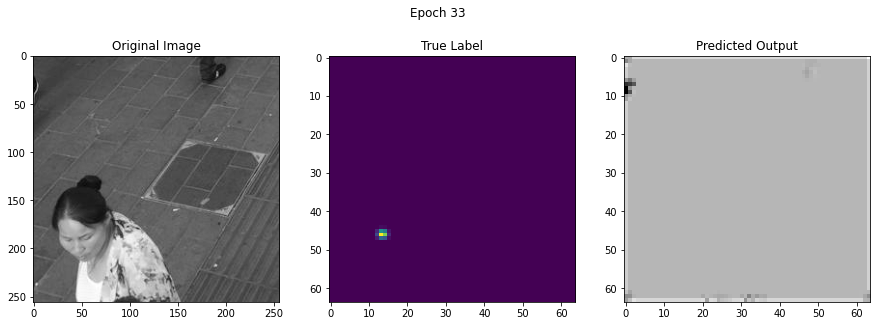

True Number:  tensor(1.0000, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.3830, device='cuda:0')


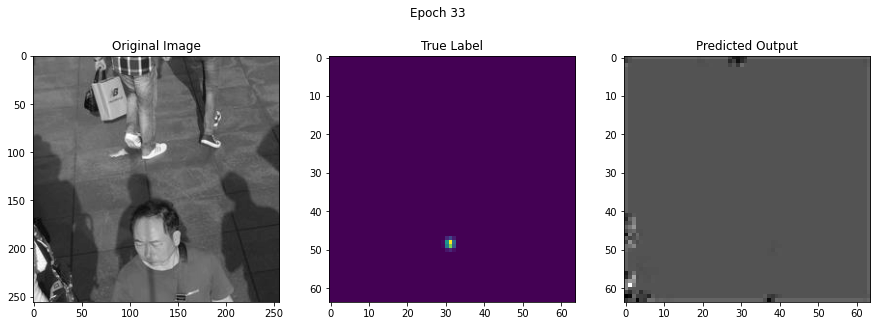

True Number:  tensor(1.0000, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.3871, device='cuda:0')


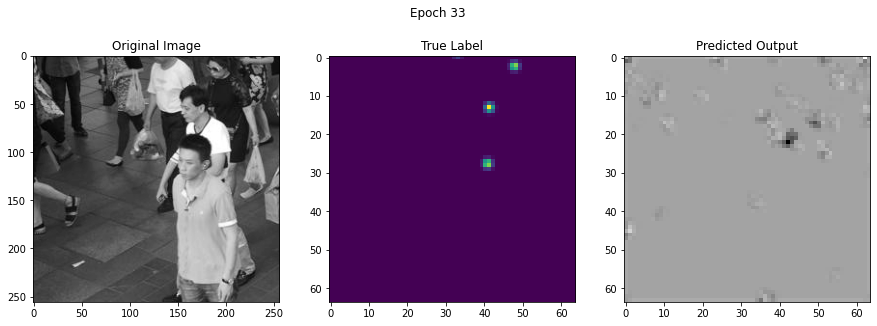

True Number:  tensor(3.1164, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.3191, device='cuda:0')


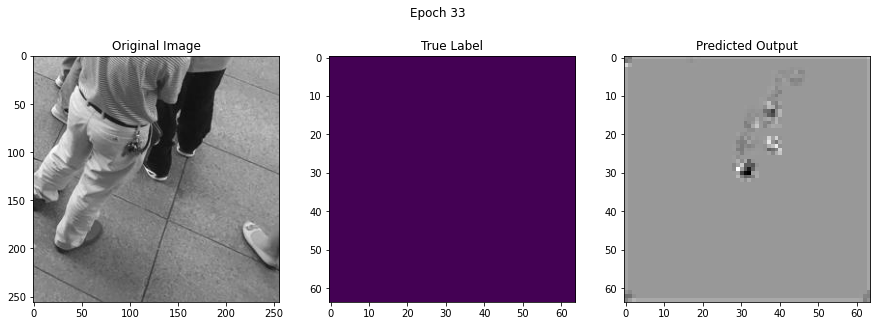

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.3752, device='cuda:0')


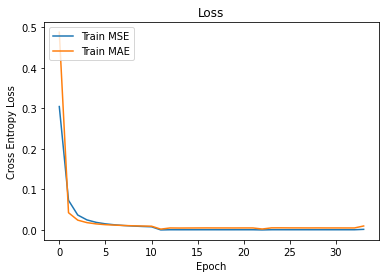

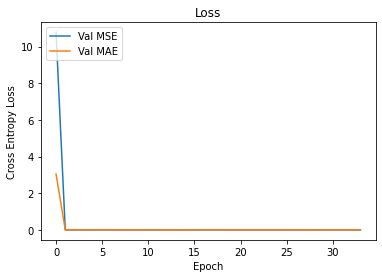

Test Loss MSE:  0.00048280501998691983 Test Loss MAE:  0.0045073510328721665
 Epoch 4,  Iteration   401,  Loss: 0.0004436117
Sum Label:  tensor(52.7380, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(14.0722, device='cuda:0', grad_fn=<SumBackward0>)


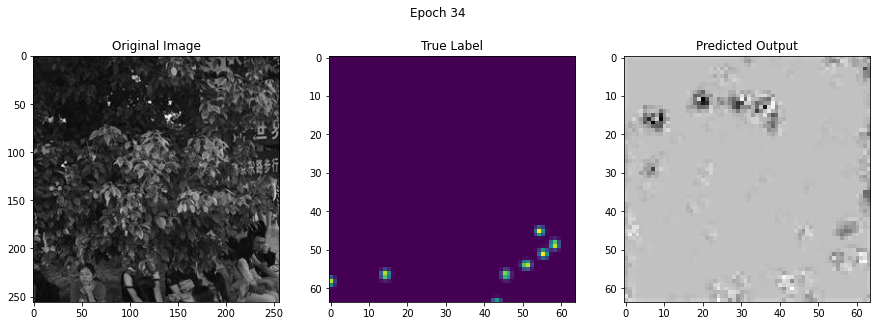

True Number:  tensor(6.8461, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.9054, device='cuda:0')


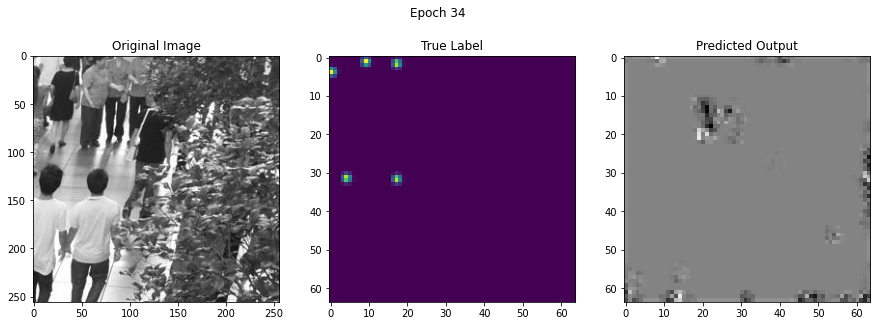

True Number:  tensor(4.7965, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(14.0895, device='cuda:0')


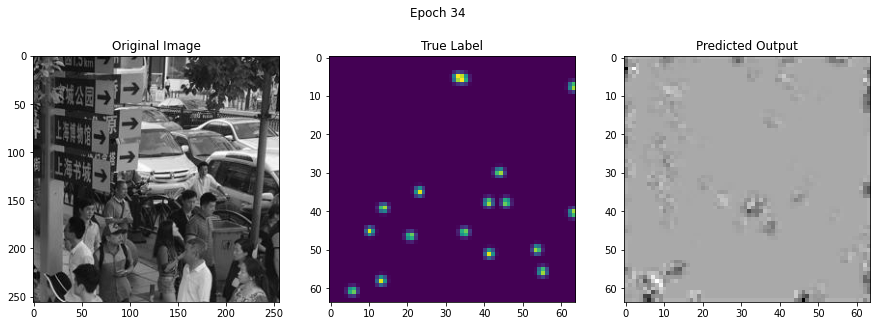

True Number:  tensor(16.6555, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(13.9953, device='cuda:0')


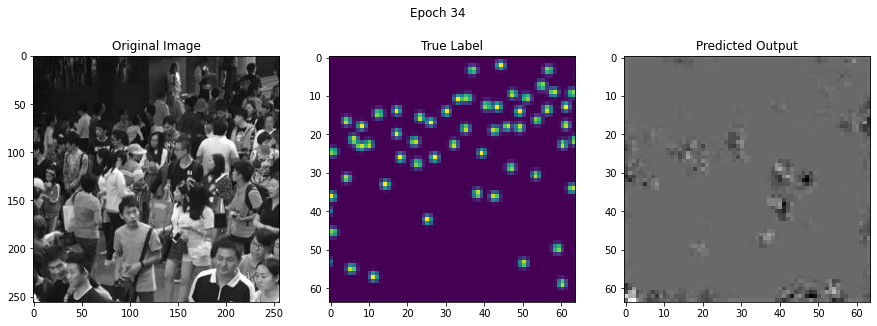

True Number:  tensor(55.3337, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(14.0510, device='cuda:0')


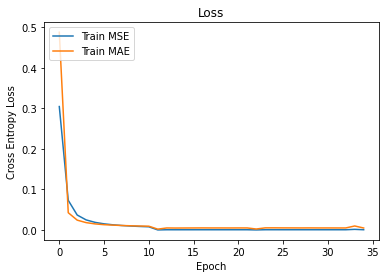

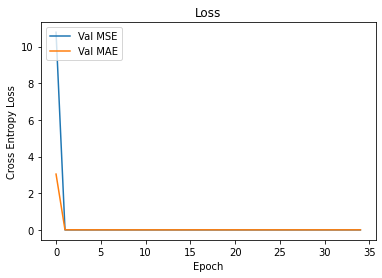

Test Loss MSE:  0.0005362311581811442 Test Loss MAE:  0.006331649590095486
 Epoch 4,  Iteration   801,  Loss: 0.0004323323
Sum Label:  tensor(4.2762, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(10.2685, device='cuda:0', grad_fn=<SumBackward0>)


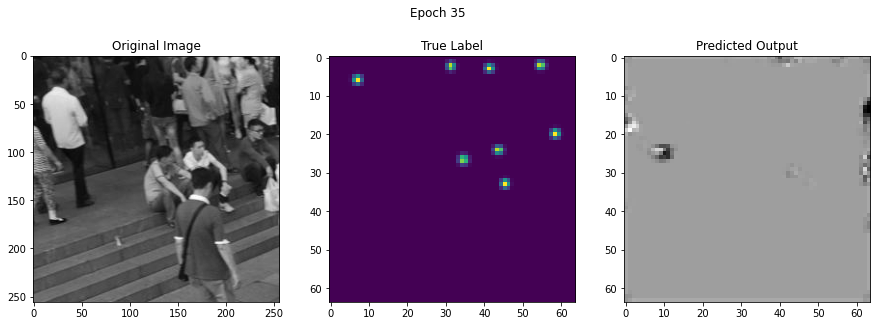

True Number:  tensor(7.9598, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.1458, device='cuda:0')


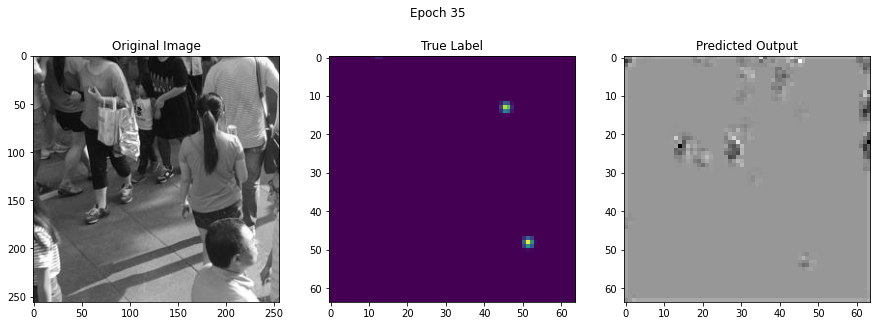

True Number:  tensor(2.0411, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.1614, device='cuda:0')


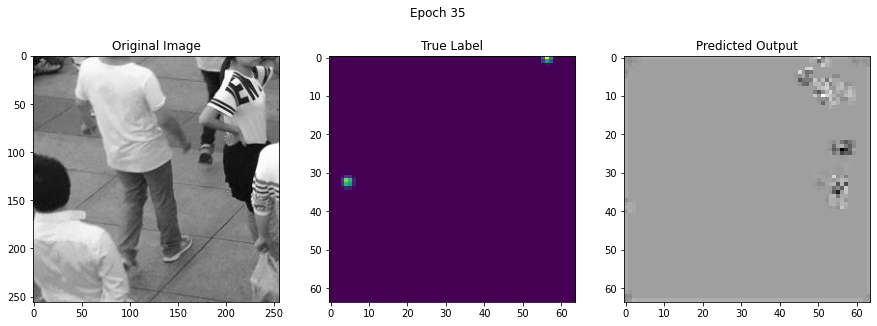

True Number:  tensor(1.8235, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.1916, device='cuda:0')


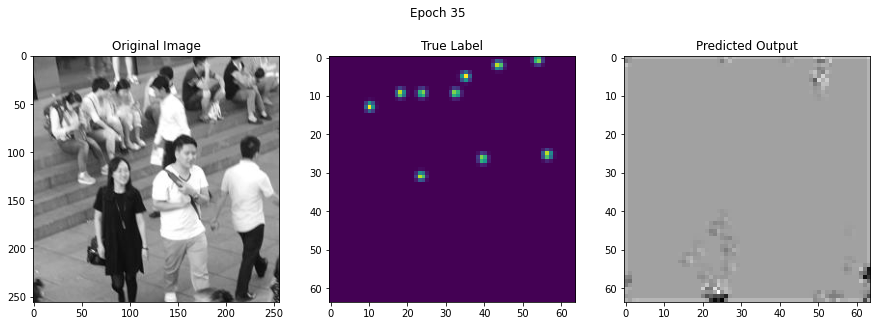

True Number:  tensor(9.9725, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.1824, device='cuda:0')


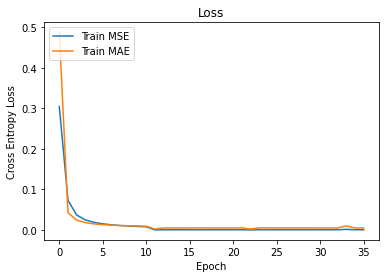

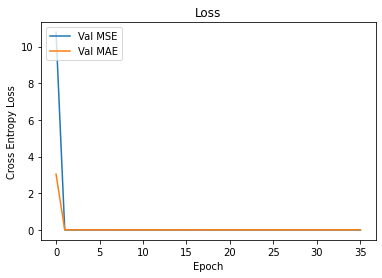

Test Loss MSE:  0.0003734253877881183 Test Loss MAE:  0.004638075932032532
 Epoch 4,  Iteration  1201,  Loss: 0.0004261154
Sum Label:  tensor(36.0379, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(9.2498, device='cuda:0', grad_fn=<SumBackward0>)


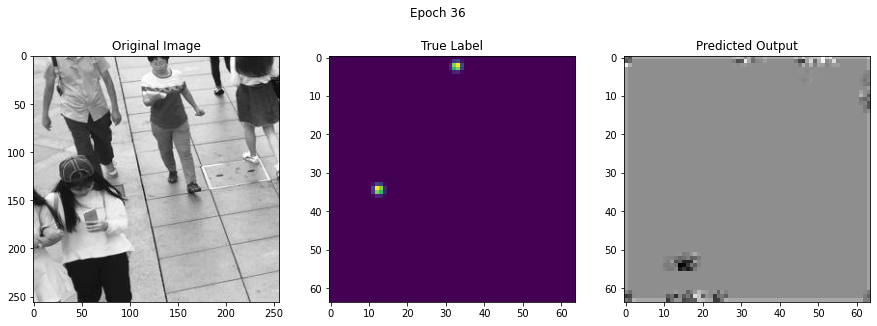

True Number:  tensor(2.0270, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.3866, device='cuda:0')


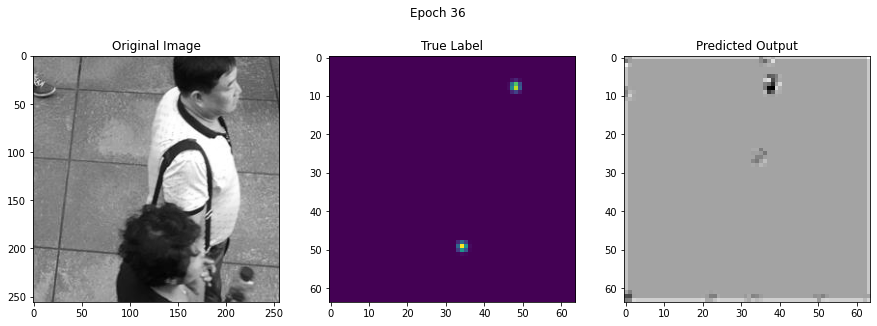

True Number:  tensor(1.9866, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.3999, device='cuda:0')


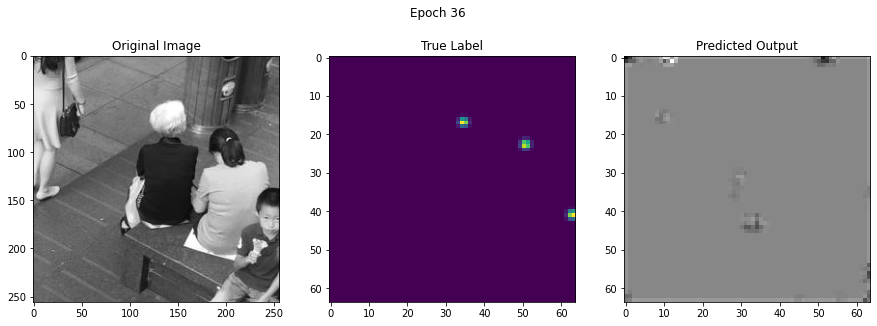

True Number:  tensor(2.9105, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.3909, device='cuda:0')


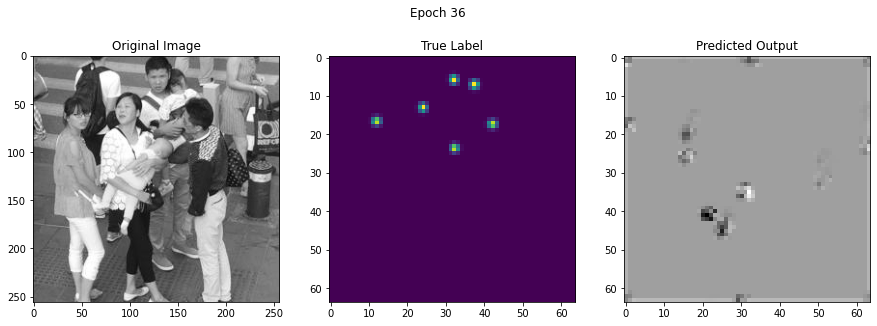

True Number:  tensor(5.9597, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.3826, device='cuda:0')


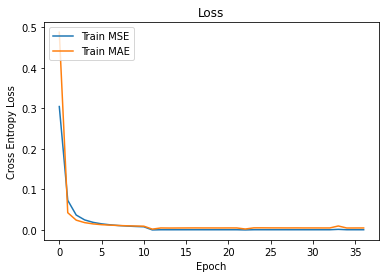

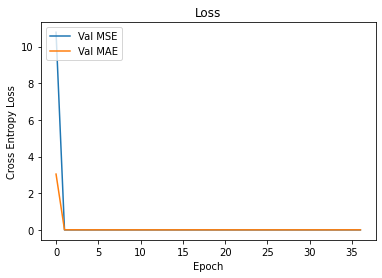

Test Loss MSE:  0.0003502548507971038 Test Loss MAE:  0.004442984541652329
 Epoch 4,  Iteration  1601,  Loss: 0.0004354119
Sum Label:  tensor(6.9724, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(11.6099, device='cuda:0', grad_fn=<SumBackward0>)


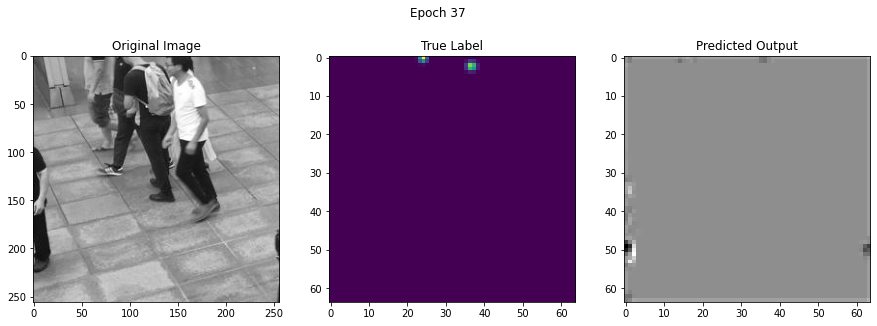

True Number:  tensor(1.8235, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.5614, device='cuda:0')


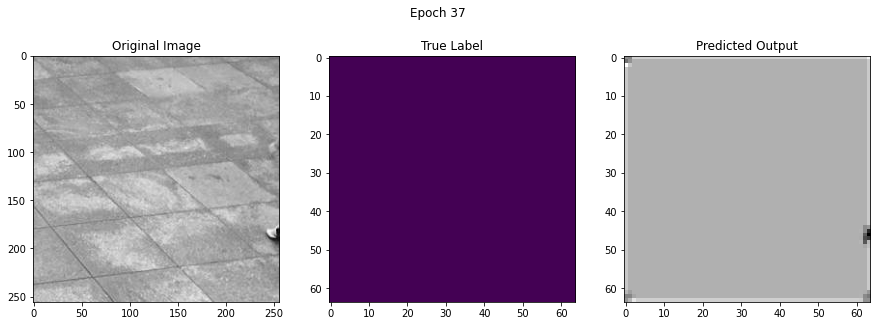

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.5601, device='cuda:0')


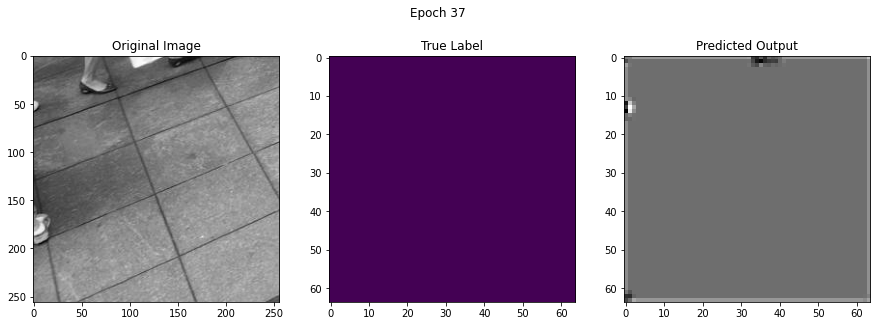

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.5627, device='cuda:0')


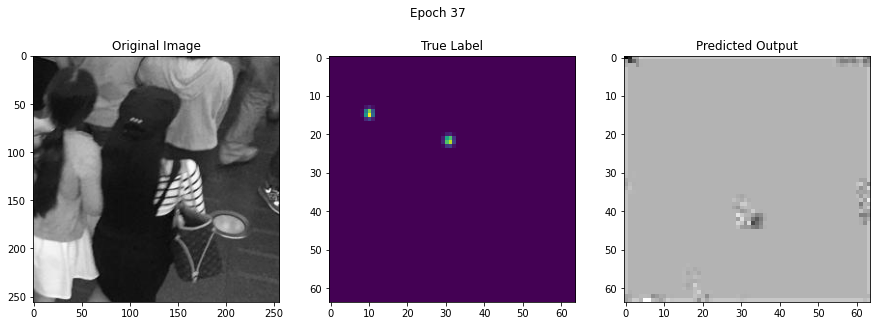

True Number:  tensor(2.0134, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.5437, device='cuda:0')


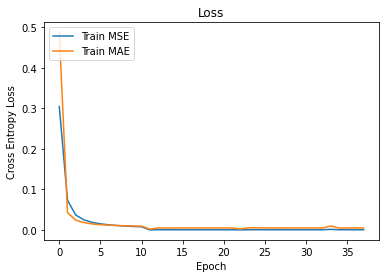

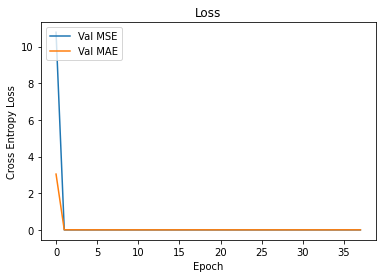

Test Loss MSE:  0.00039477145340545877 Test Loss MAE:  0.004908036671089705
 Epoch 4,  Iteration  2001,  Loss: 0.0004424228
Sum Label:  tensor(2.0001, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(7.7309, device='cuda:0', grad_fn=<SumBackward0>)


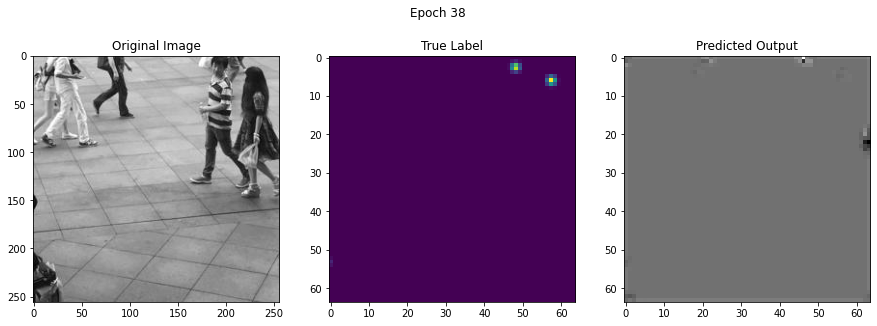

True Number:  tensor(2.0403, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.7797, device='cuda:0')


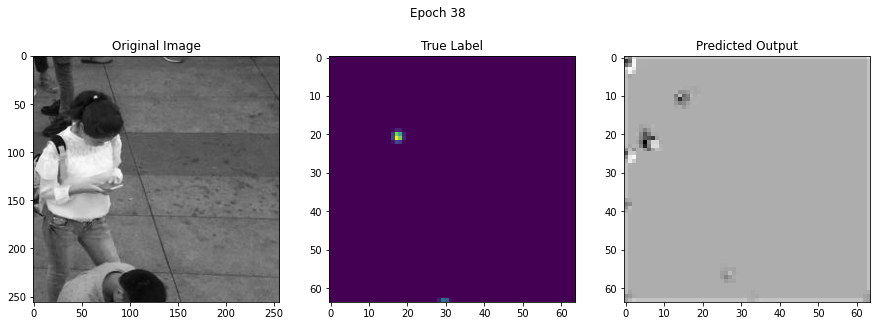

True Number:  tensor(1.1925, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.7746, device='cuda:0')


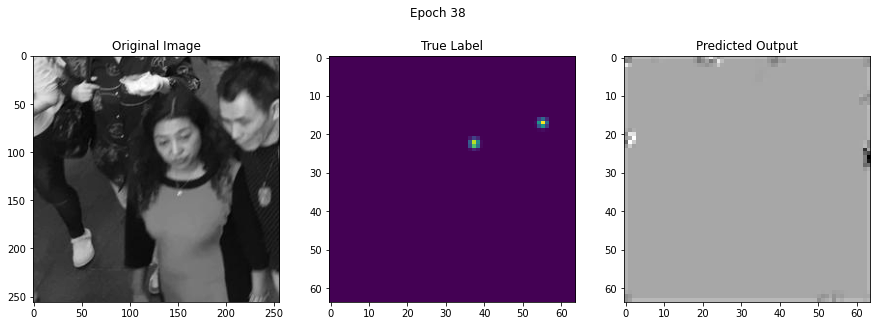

True Number:  tensor(1.9866, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.7736, device='cuda:0')


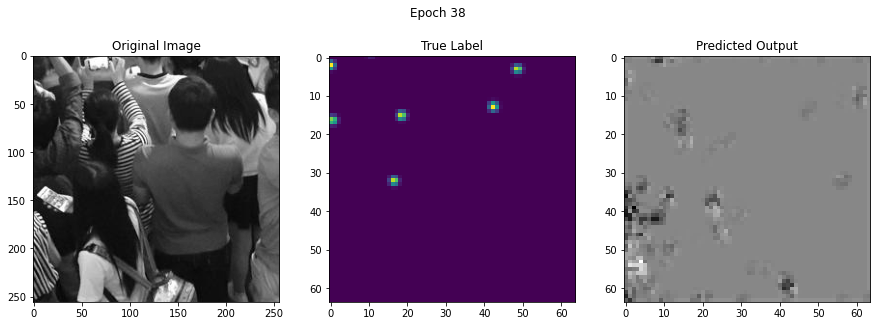

True Number:  tensor(5.6471, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.6811, device='cuda:0')


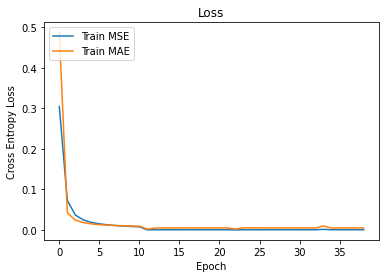

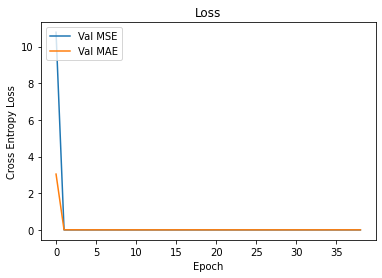

Test Loss MSE:  0.00029847987175022776 Test Loss MAE:  0.0037732121447628044
 Epoch 4,  Iteration  2401,  Loss: 0.0004449752
Sum Label:  tensor(25.3064, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(9.3029, device='cuda:0', grad_fn=<SumBackward0>)


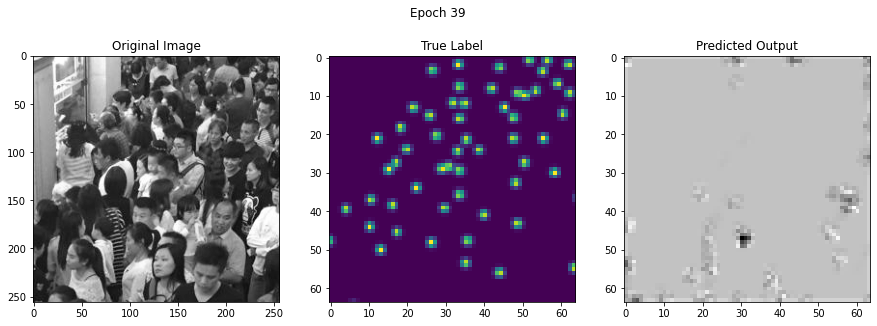

True Number:  tensor(55.2049, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.3751, device='cuda:0')


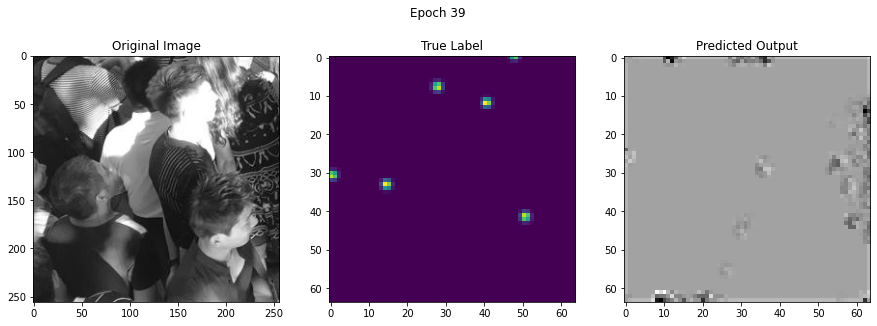

True Number:  tensor(5.3720, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.3785, device='cuda:0')


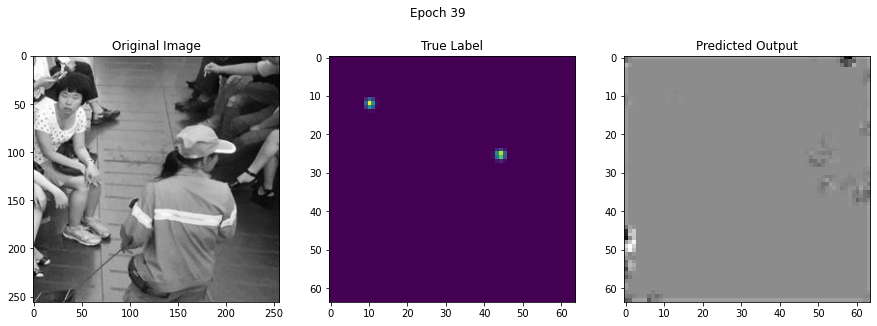

True Number:  tensor(1.9866, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.4100, device='cuda:0')


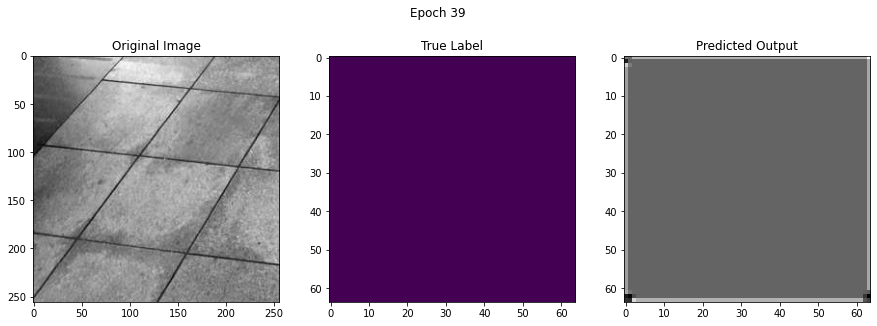

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.4239, device='cuda:0')


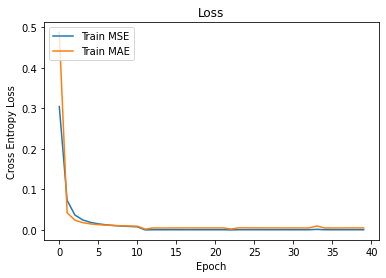

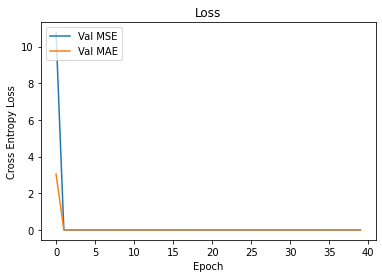

Test Loss MSE:  0.00046389855832317016 Test Loss MAE:  0.004930862293795052
 Epoch 4,  Iteration  2801,  Loss: 0.0004385899
Sum Label:  tensor(0., device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(9.4110, device='cuda:0', grad_fn=<SumBackward0>)


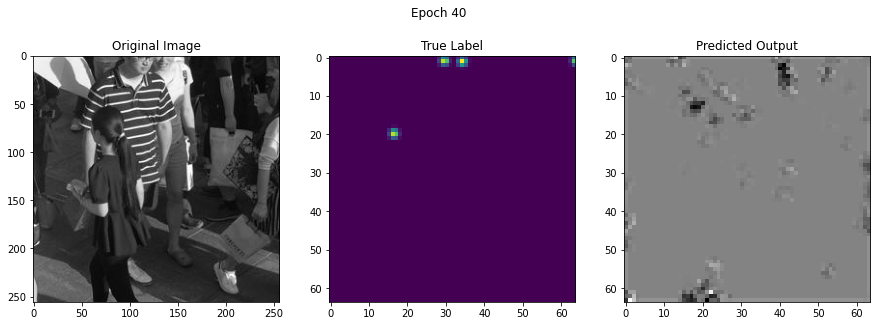

True Number:  tensor(3.3911, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.2262, device='cuda:0')


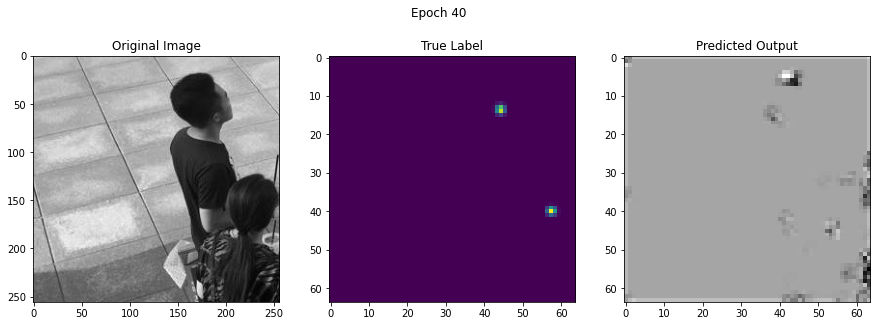

True Number:  tensor(1.9866, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.2607, device='cuda:0')


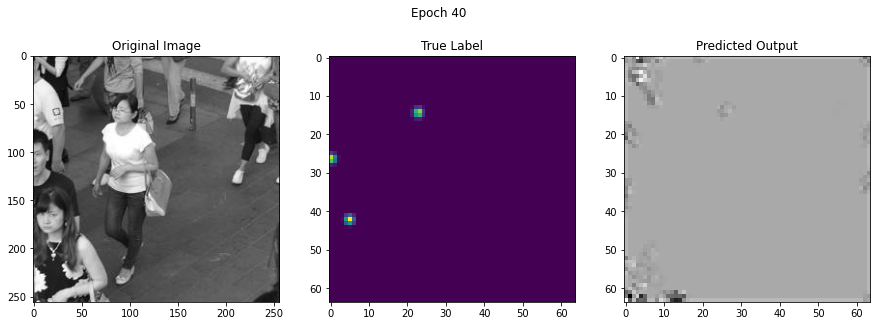

True Number:  tensor(2.8211, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.2609, device='cuda:0')


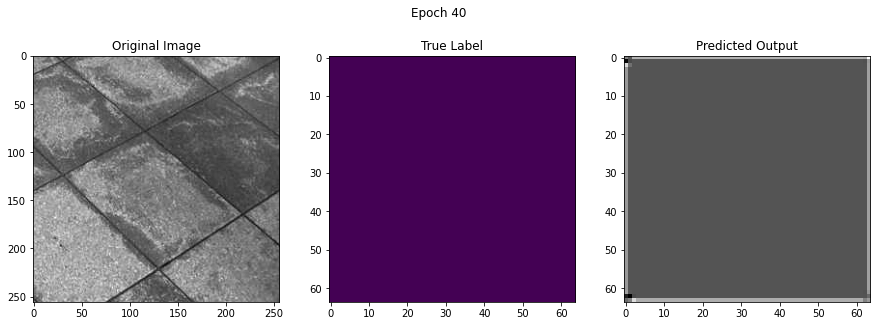

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.2917, device='cuda:0')


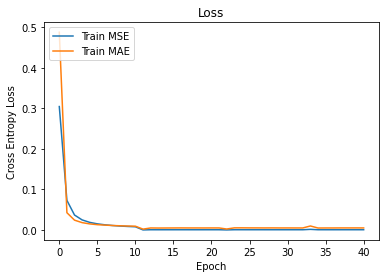

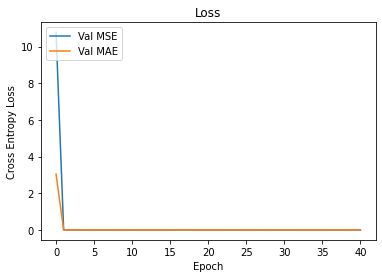

Test Loss MSE:  0.0005020511327456181 Test Loss MAE:  0.0051165799977201405
 Epoch 4,  Iteration  3201,  Loss: 0.0004279417
Sum Label:  tensor(3.2895, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(9.7916, device='cuda:0', grad_fn=<SumBackward0>)


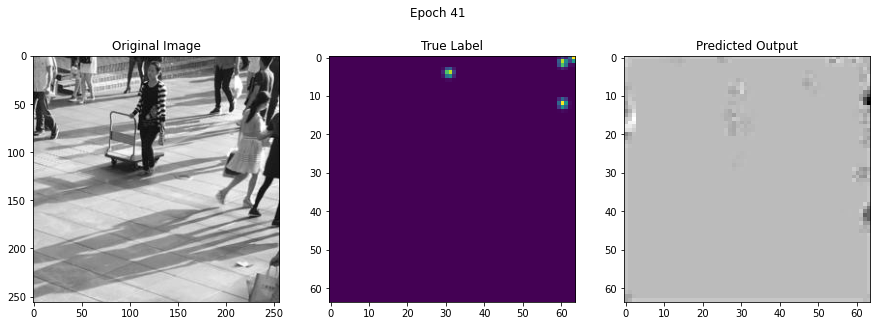

True Number:  tensor(3.5587, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.7507, device='cuda:0')


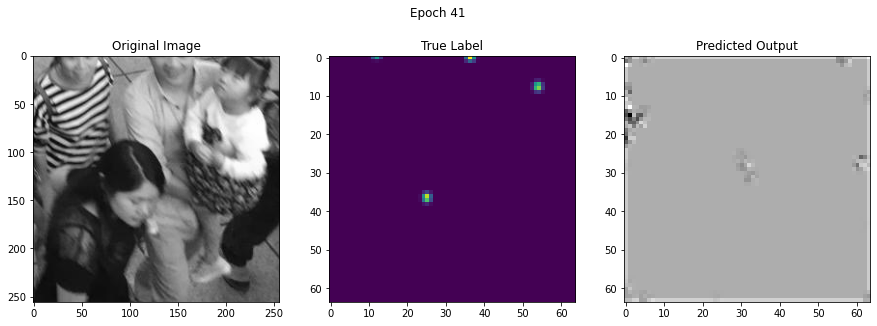

True Number:  tensor(3.0000, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.7703, device='cuda:0')


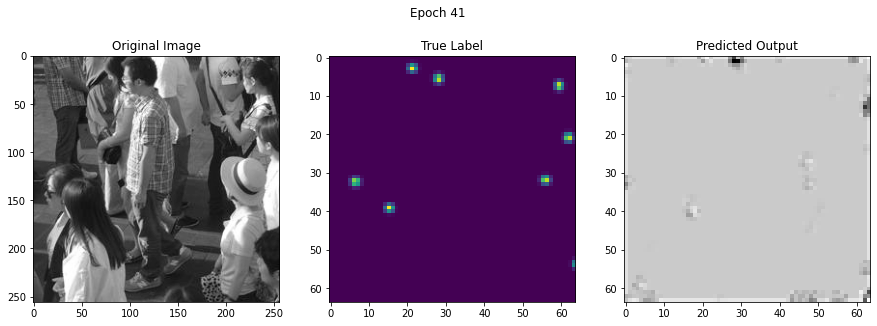

True Number:  tensor(7.2801, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.7565, device='cuda:0')


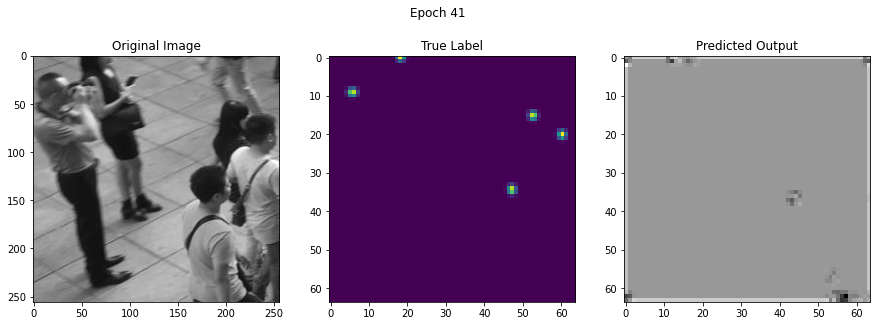

True Number:  tensor(4.6834, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(9.7733, device='cuda:0')


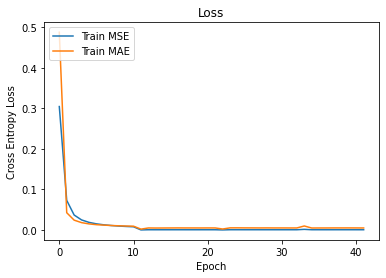

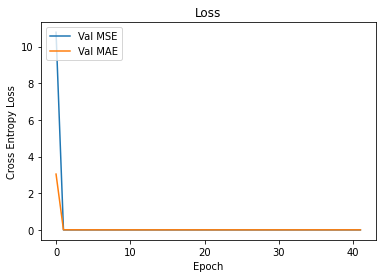

Test Loss MSE:  0.00034505849197273043 Test Loss MAE:  0.004342426520047916
 Epoch 4,  Iteration  3601,  Loss: 0.0004220855
Sum Label:  tensor(9.9880, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(5.9544, device='cuda:0', grad_fn=<SumBackward0>)


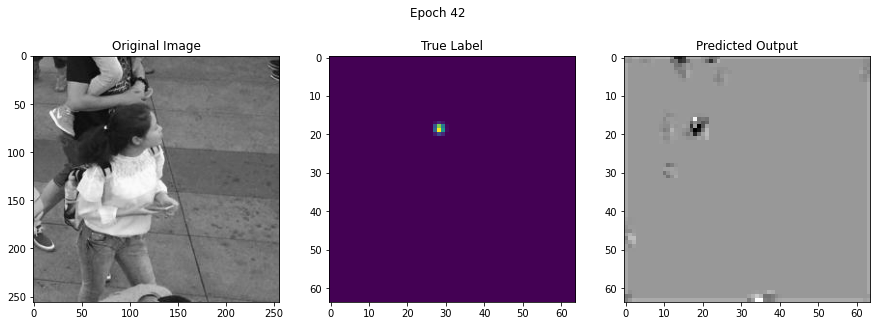

True Number:  tensor(1.0000, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(5.9616, device='cuda:0')


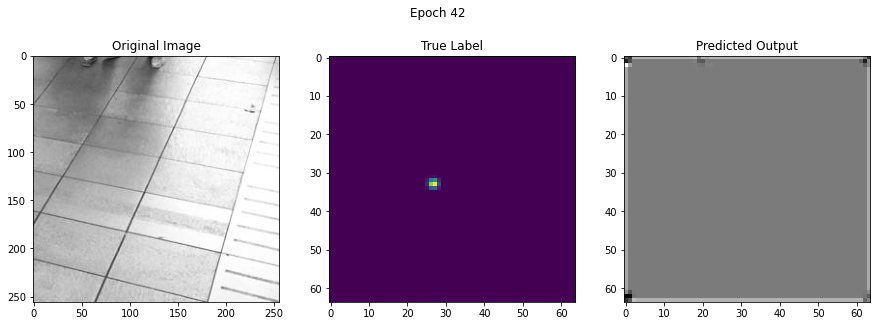

True Number:  tensor(1.0000, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(5.9746, device='cuda:0')


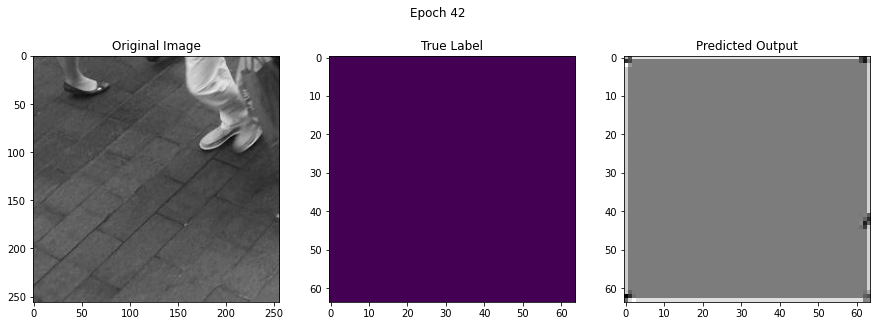

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(5.9752, device='cuda:0')


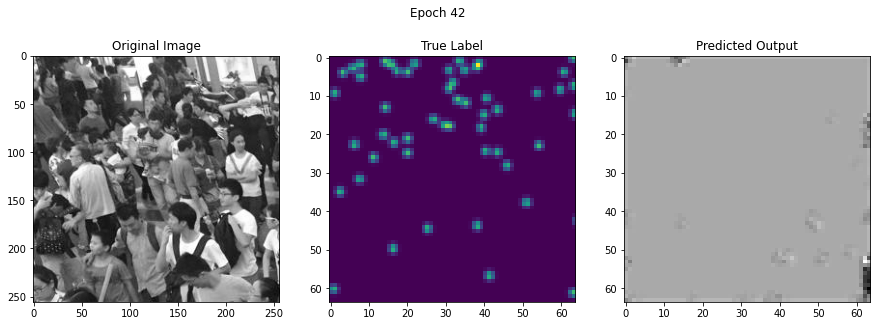

True Number:  tensor(50.8619, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(5.9407, device='cuda:0')


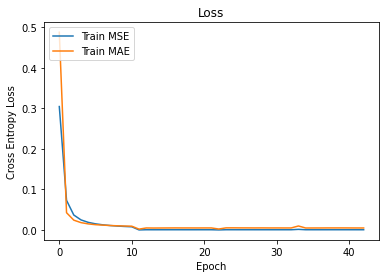

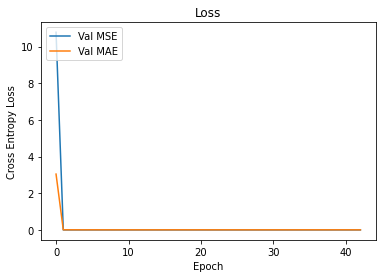

Test Loss MSE:  0.00034820488164741346 Test Loss MAE:  0.0036027336674225
 Epoch 4,  Iteration  4001,  Loss: 0.0004206138
Sum Label:  tensor(10.4393, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(11.0150, device='cuda:0', grad_fn=<SumBackward0>)


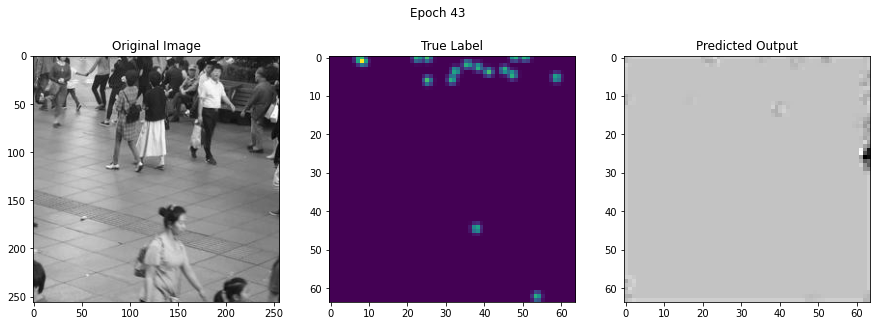

True Number:  tensor(15.9484, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.8912, device='cuda:0')


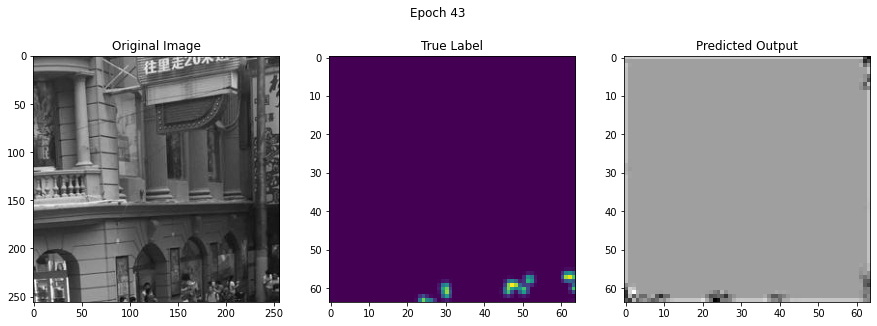

True Number:  tensor(10.4680, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.9009, device='cuda:0')


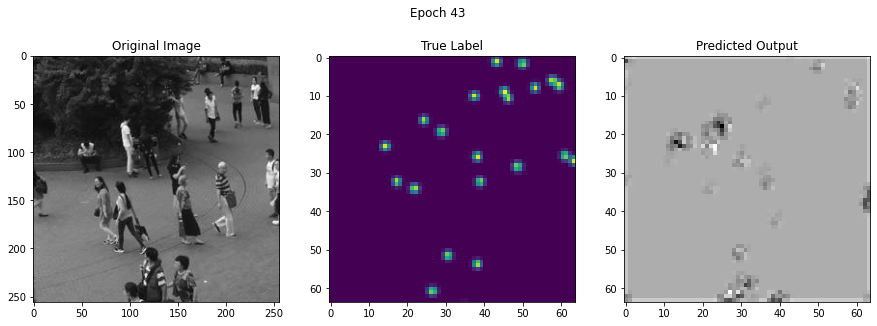

True Number:  tensor(20.7284, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.8890, device='cuda:0')


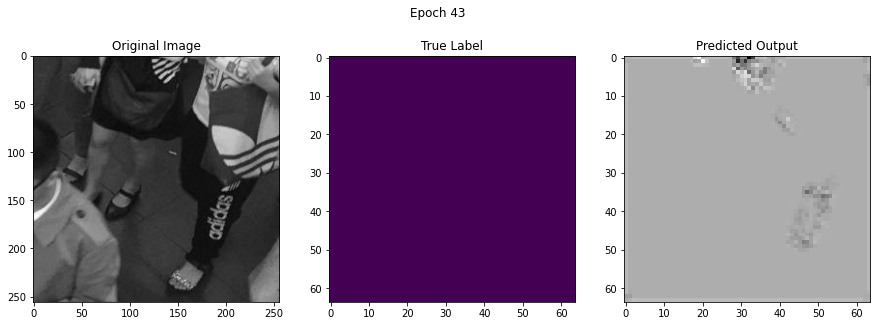

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.8911, device='cuda:0')


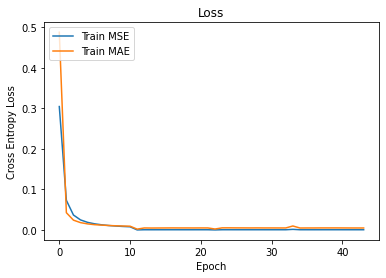

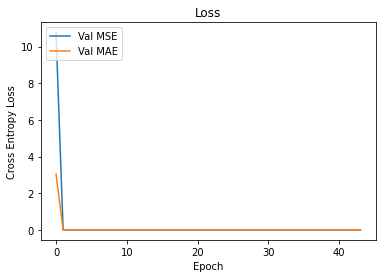

Test Loss MSE:  0.00042021864509010675 Test Loss MAE:  0.0050962660108890495
**********Epoch: 5 **********
 Epoch 5,  Iteration     1,  Loss: 0.0001033816
Sum Label:  tensor(2.6200, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(11.1334, device='cuda:0', grad_fn=<SumBackward0>)


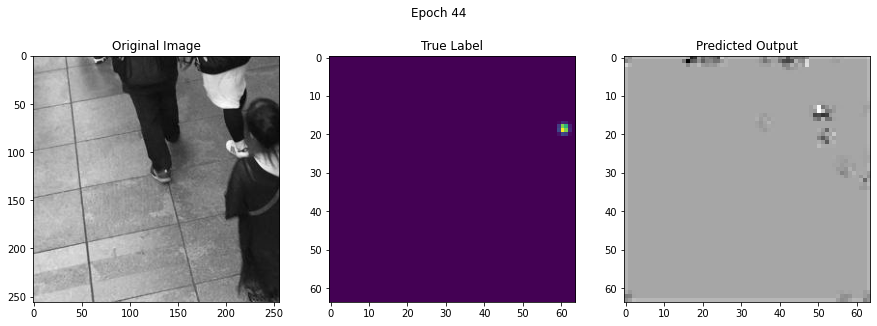

True Number:  tensor(1.0135, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.1881, device='cuda:0')


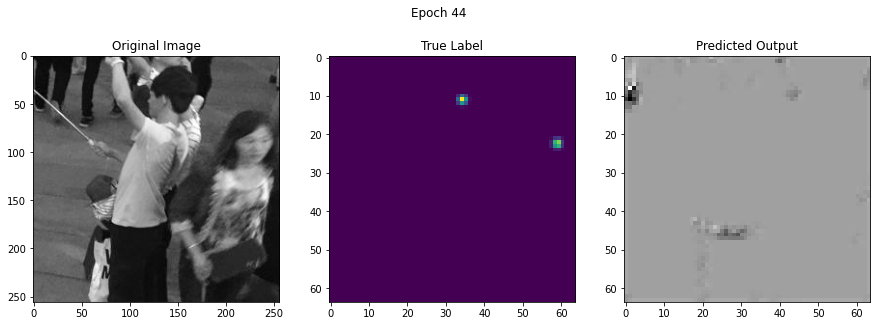

True Number:  tensor(2.0001, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.1686, device='cuda:0')


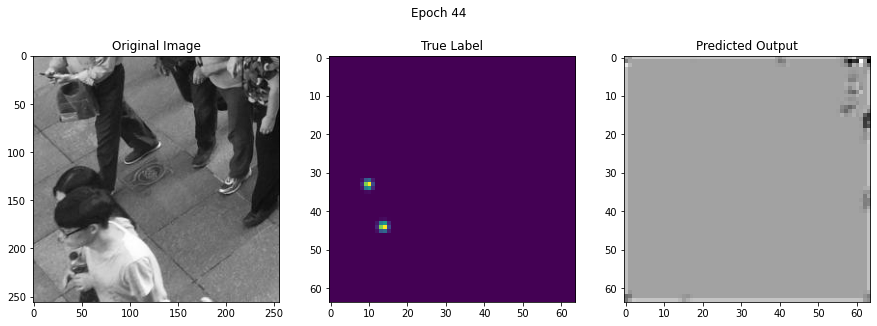

True Number:  tensor(1.9999, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.1993, device='cuda:0')


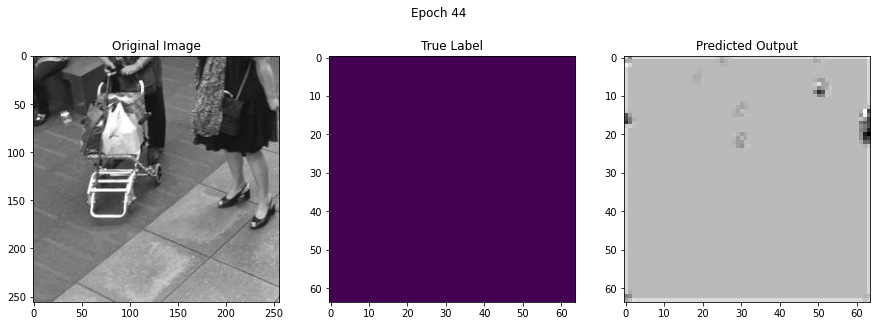

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.1980, device='cuda:0')


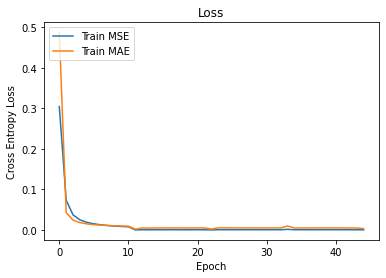

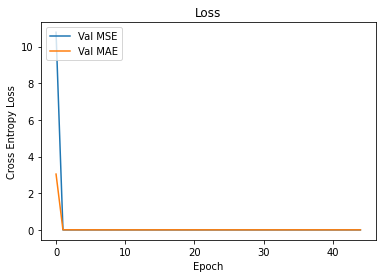

Test Loss MSE:  0.00020509649133637509 Test Loss MAE:  0.004006971217071016
 Epoch 5,  Iteration   401,  Loss: 0.0003857594
Sum Label:  tensor(0.9866, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(10.5483, device='cuda:0', grad_fn=<SumBackward0>)


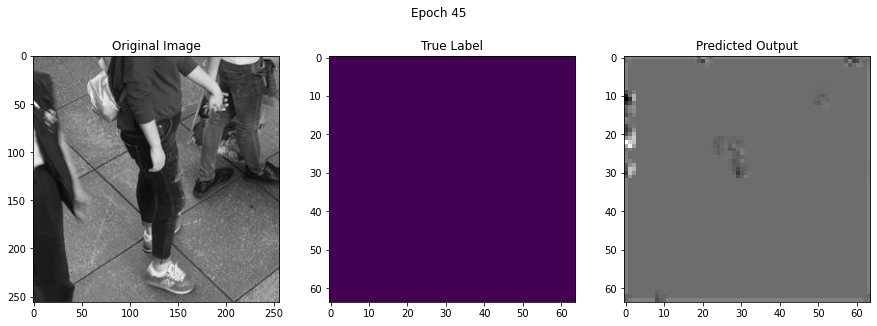

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.4431, device='cuda:0')


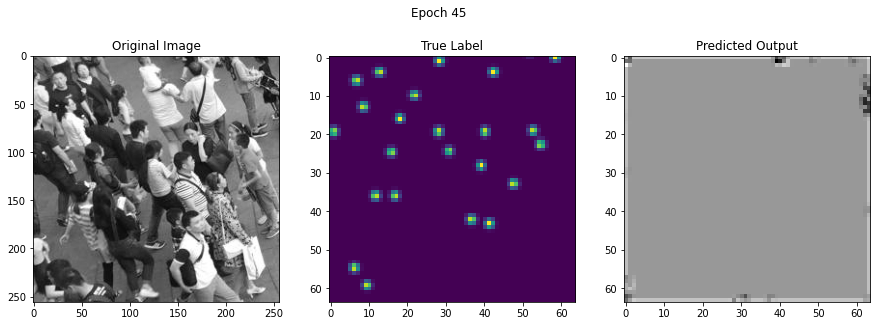

True Number:  tensor(22.6657, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.4393, device='cuda:0')


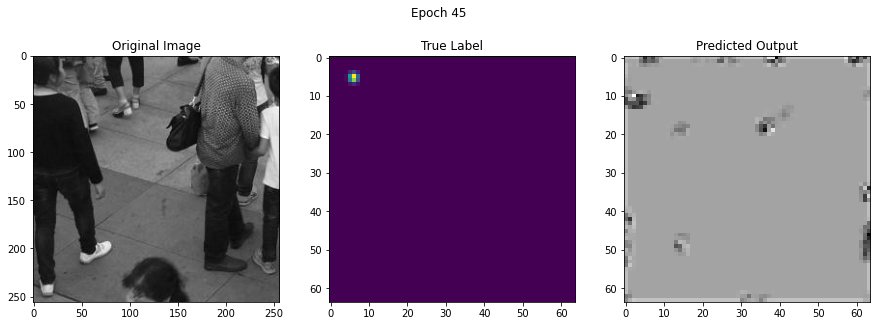

True Number:  tensor(1.0000, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.4173, device='cuda:0')


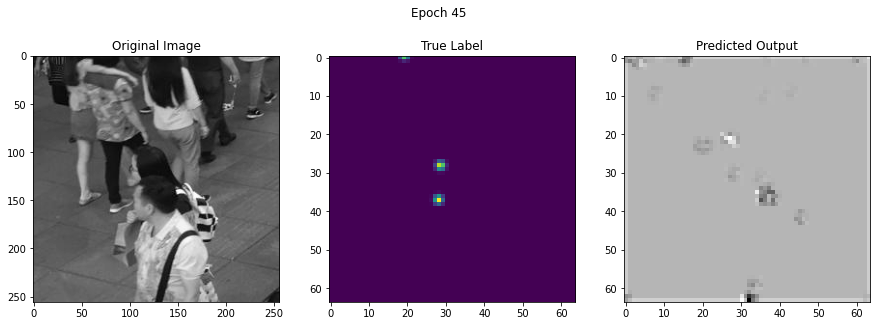

True Number:  tensor(2.4166, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(10.4341, device='cuda:0')


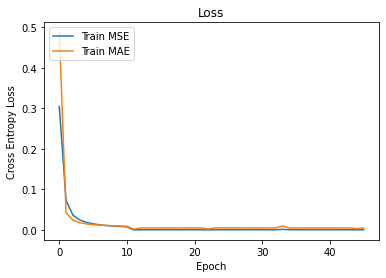

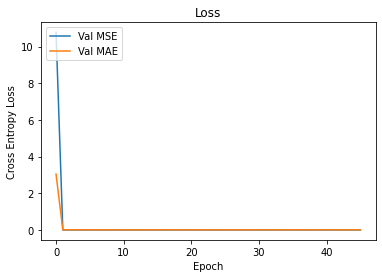

Test Loss MSE:  0.0003683028586201177 Test Loss MAE:  0.004822986938924801
 Epoch 5,  Iteration   801,  Loss: 0.0003760059
Sum Label:  tensor(0., device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(7.1799, device='cuda:0', grad_fn=<SumBackward0>)


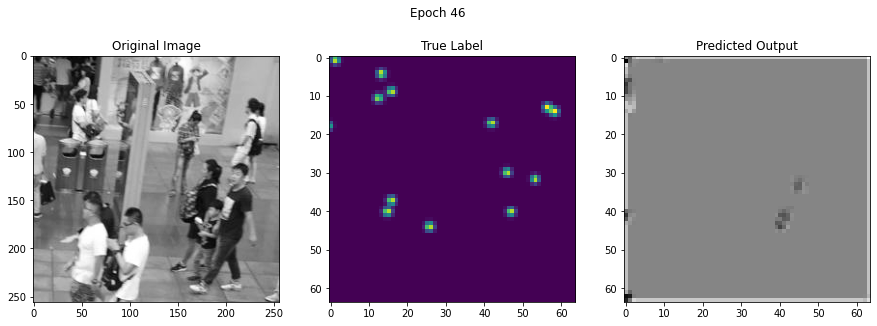

True Number:  tensor(13.2222, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.1458, device='cuda:0')


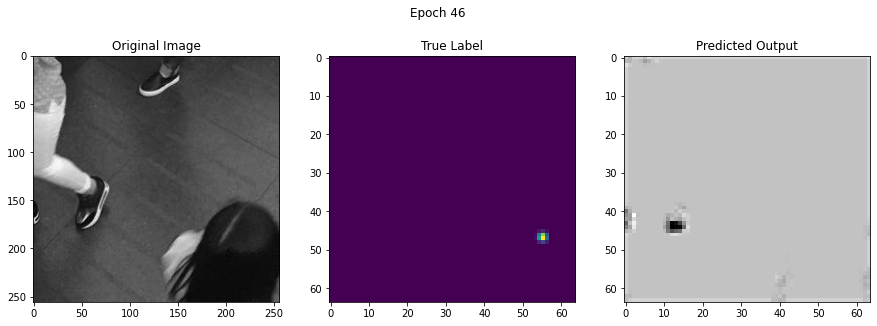

True Number:  tensor(1.0000, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.1336, device='cuda:0')


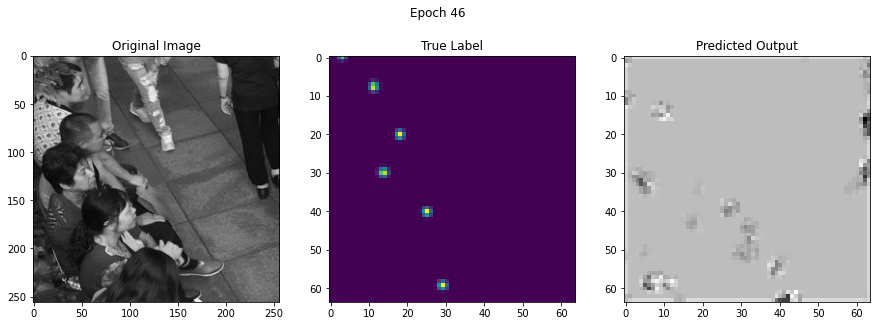

True Number:  tensor(5.3898, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.1285, device='cuda:0')


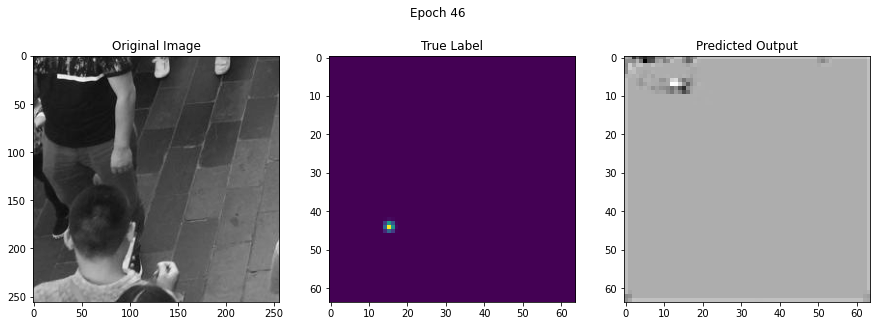

True Number:  tensor(0.9866, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.1345, device='cuda:0')


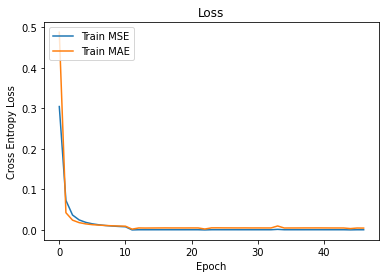

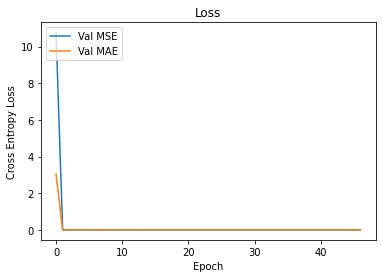

Test Loss MSE:  0.000549198343826378 Test Loss MAE:  0.004534006780813063
 Epoch 5,  Iteration  1201,  Loss: 0.0004035301
Sum Label:  tensor(56.7134, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(8.7305, device='cuda:0', grad_fn=<SumBackward0>)


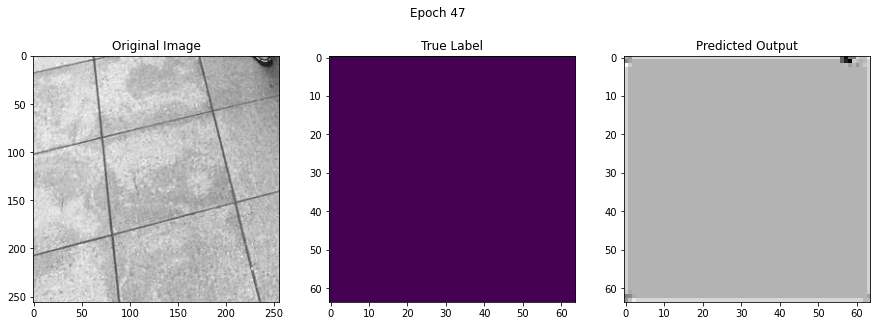

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.8814, device='cuda:0')


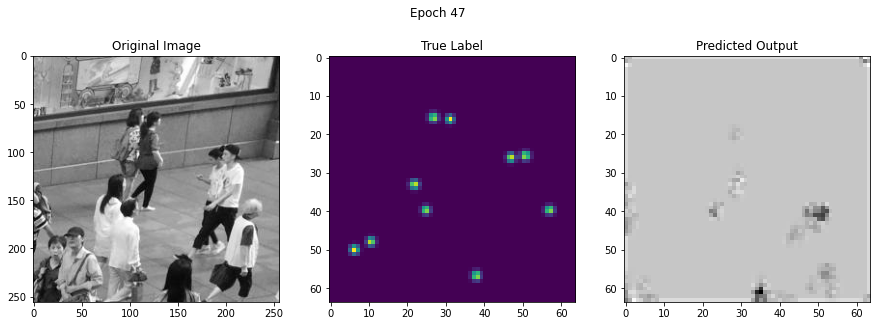

True Number:  tensor(10.0405, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.8606, device='cuda:0')


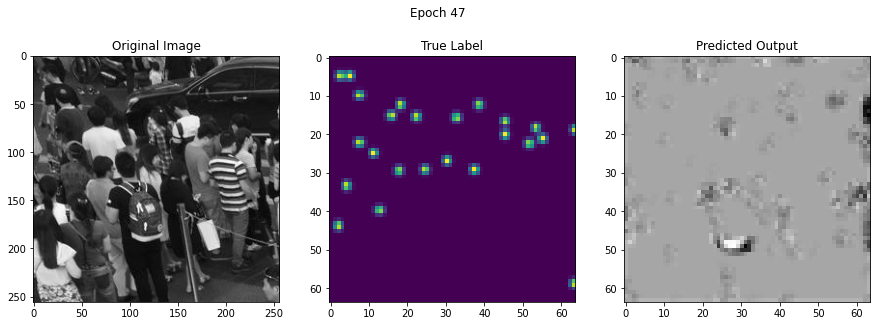

True Number:  tensor(23.2628, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.7865, device='cuda:0')


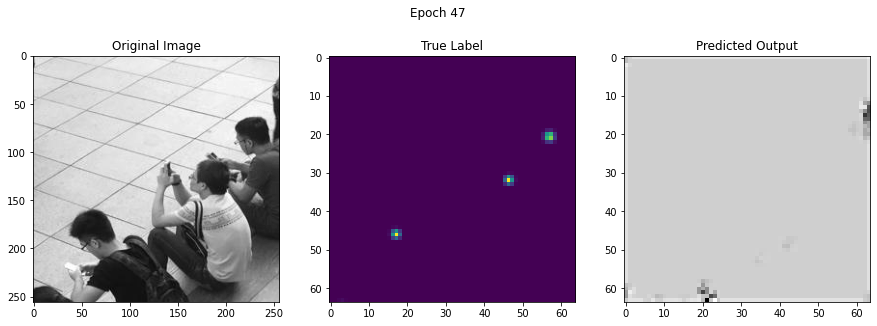

True Number:  tensor(3.0043, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.8731, device='cuda:0')


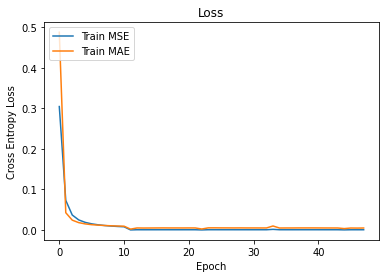

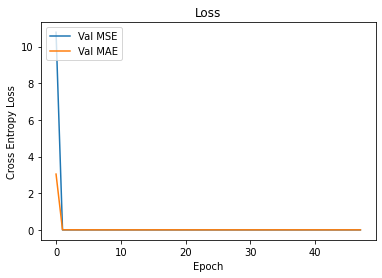

Test Loss MSE:  0.000590004908865398 Test Loss MAE:  0.005287449510598724
 Epoch 5,  Iteration  1601,  Loss: 0.0003848744
Sum Label:  tensor(16.7086, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(7.4563, device='cuda:0', grad_fn=<SumBackward0>)


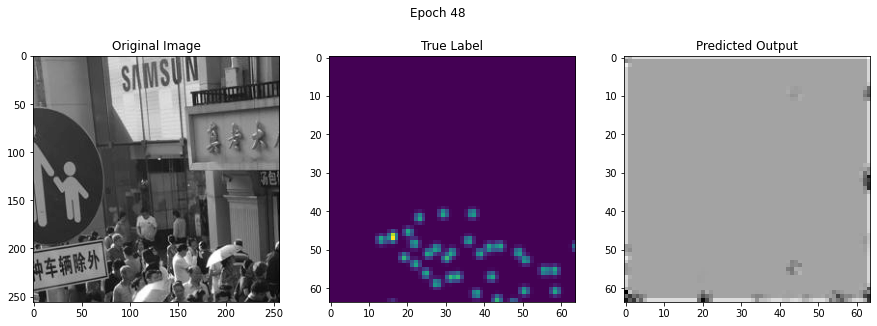

True Number:  tensor(31.5500, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.4021, device='cuda:0')


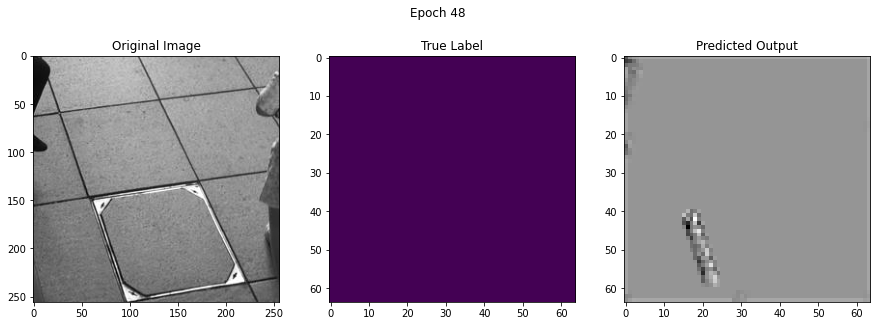

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.3978, device='cuda:0')


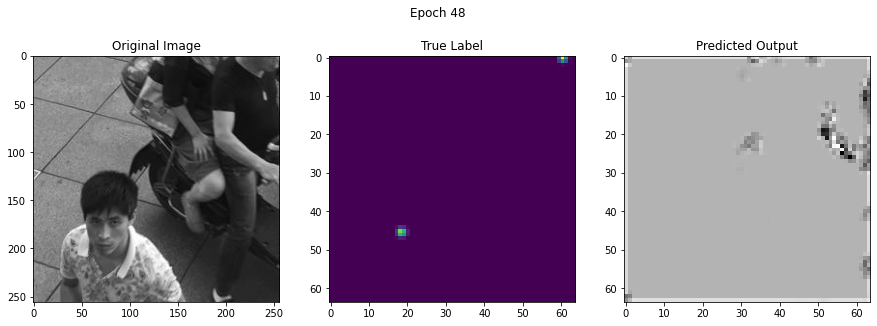

True Number:  tensor(1.8235, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.3966, device='cuda:0')


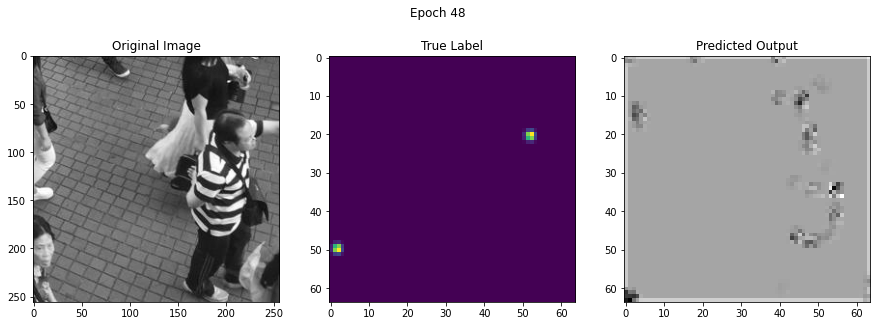

True Number:  tensor(2.0270, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(7.3999, device='cuda:0')


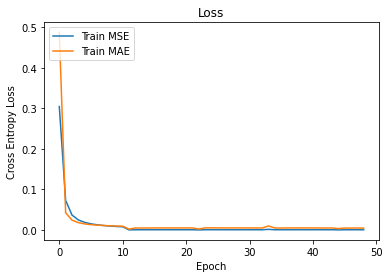

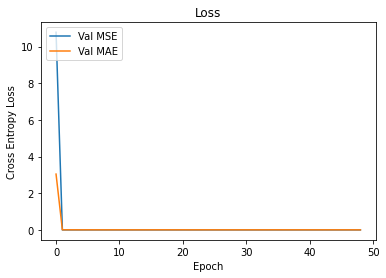

Test Loss MSE:  0.0006018041675002733 Test Loss MAE:  0.004651841078414535
 Epoch 5,  Iteration  2001,  Loss: 0.0003941139
Sum Label:  tensor(0., device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(11.5360, device='cuda:0', grad_fn=<SumBackward0>)


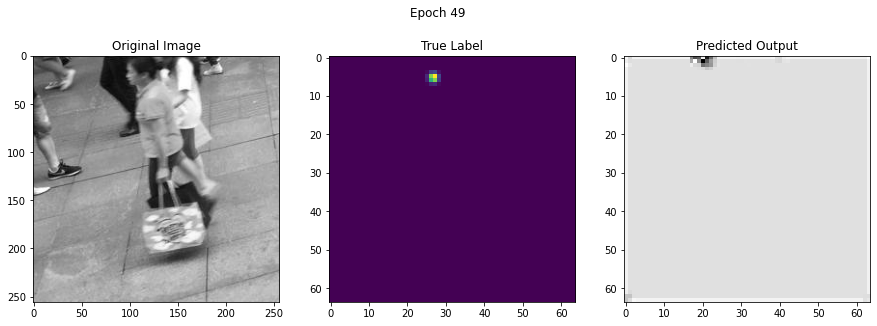

True Number:  tensor(1.0135, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.4398, device='cuda:0')


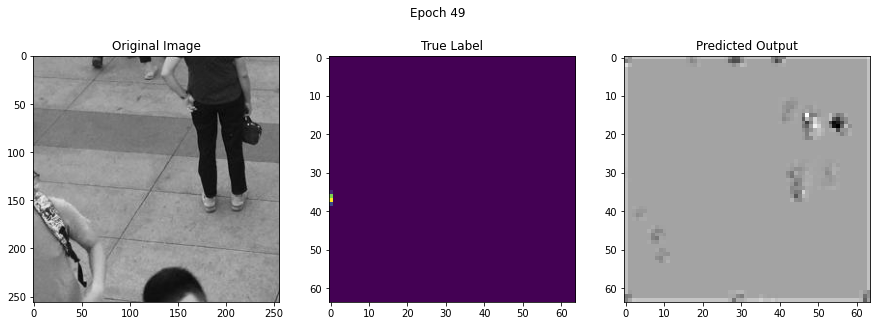

True Number:  tensor(0.1043, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.4365, device='cuda:0')


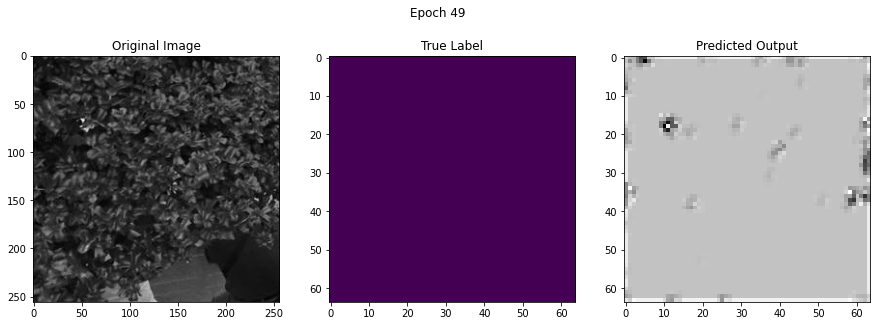

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.4296, device='cuda:0')


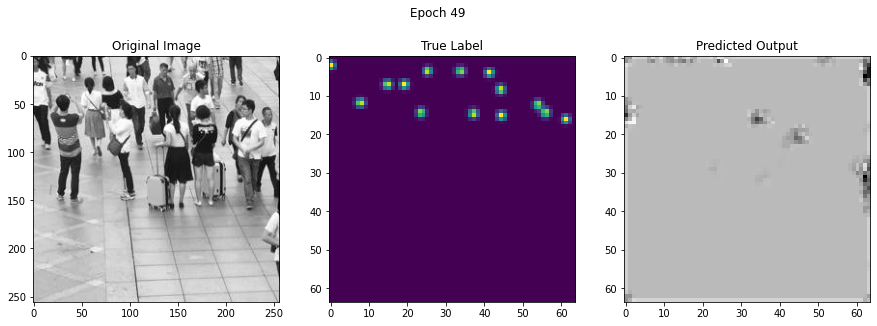

True Number:  tensor(13.6971, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.4282, device='cuda:0')


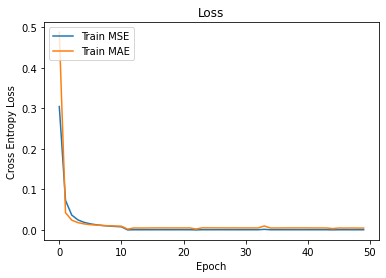

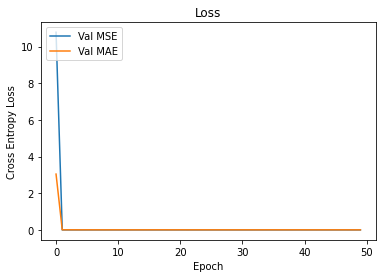

Test Loss MSE:  0.0005698196108539259 Test Loss MAE:  0.005606905561918864
 Epoch 5,  Iteration  2401,  Loss: 0.0003811434
Sum Label:  tensor(10.2240, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(8.6480, device='cuda:0', grad_fn=<SumBackward0>)


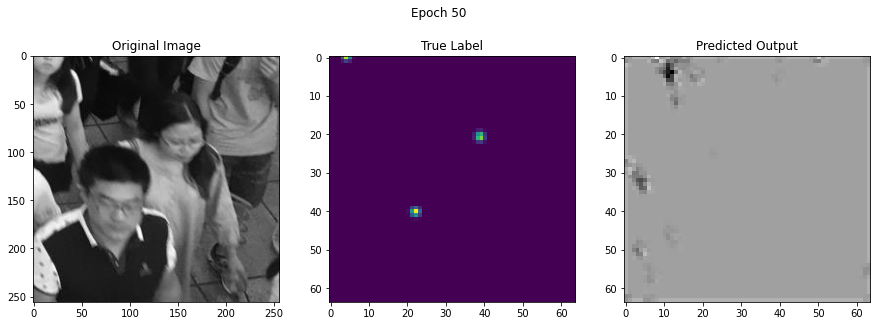

True Number:  tensor(2.5700, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.7422, device='cuda:0')


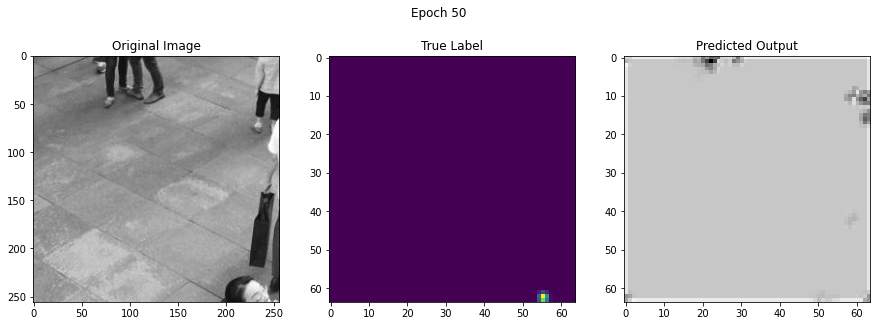

True Number:  tensor(0.9462, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.7488, device='cuda:0')


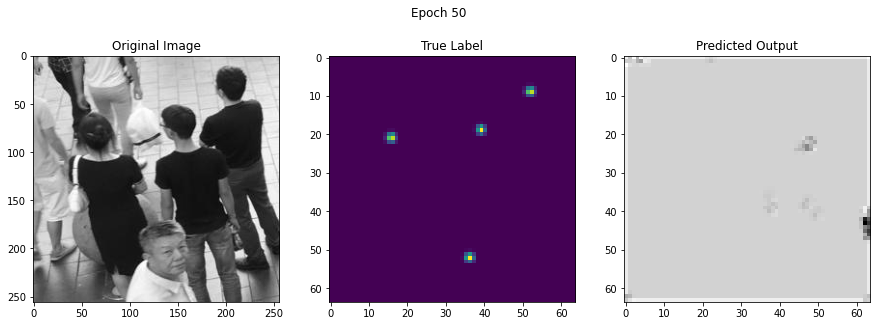

True Number:  tensor(3.9731, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.7511, device='cuda:0')


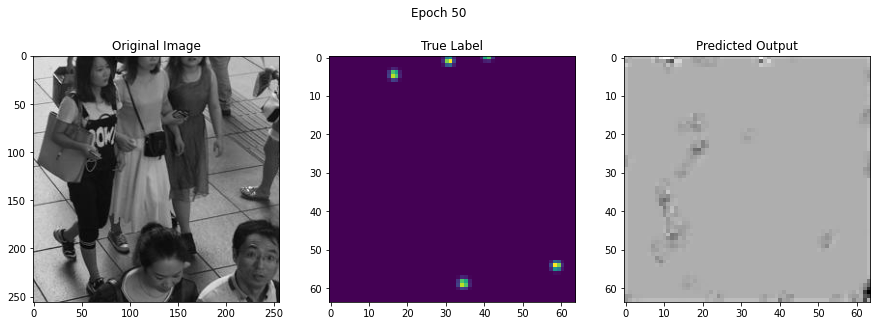

True Number:  tensor(4.4449, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.7351, device='cuda:0')


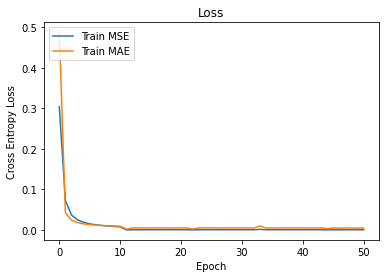

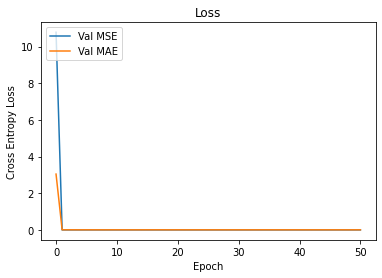

Test Loss MSE:  0.0004906743565652045 Test Loss MAE:  0.00491100304167379
 Epoch 5,  Iteration  2801,  Loss: 0.0004124211
Sum Label:  tensor(5.4670, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(11.3194, device='cuda:0', grad_fn=<SumBackward0>)


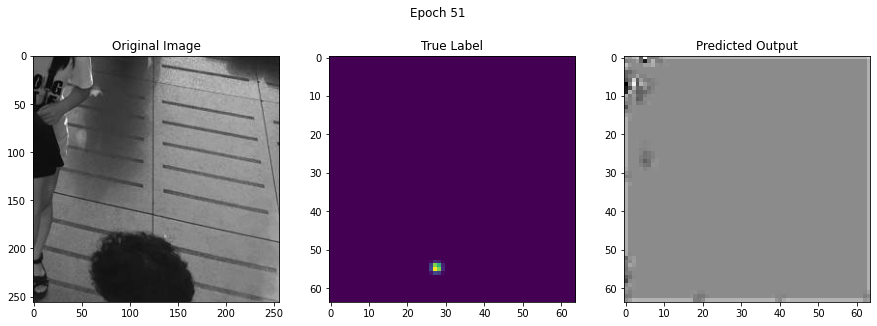

True Number:  tensor(1.0135, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.3138, device='cuda:0')


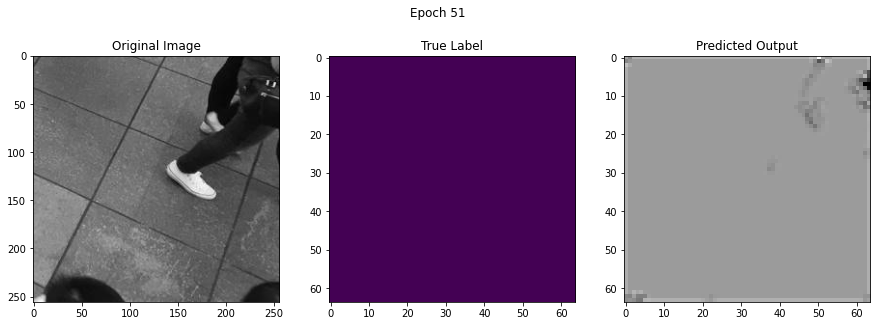

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.3101, device='cuda:0')


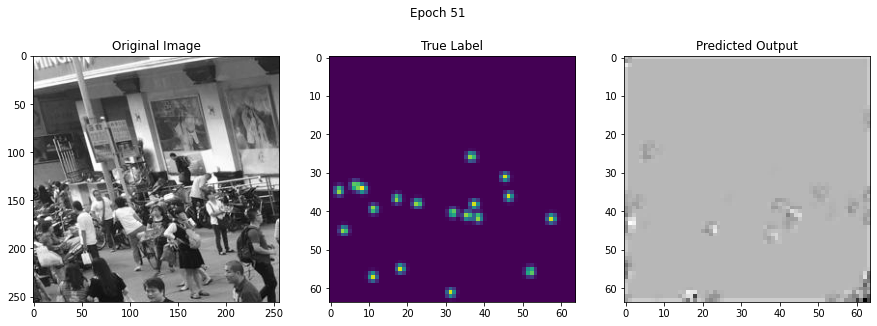

True Number:  tensor(18.9329, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.3050, device='cuda:0')


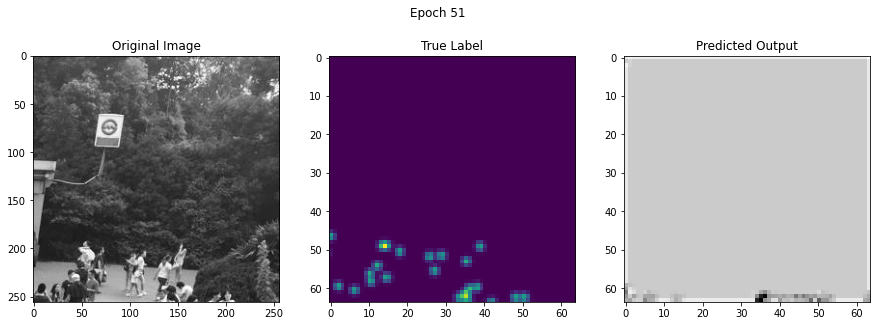

True Number:  tensor(21.9302, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(11.3111, device='cuda:0')


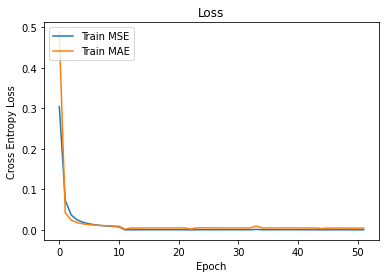

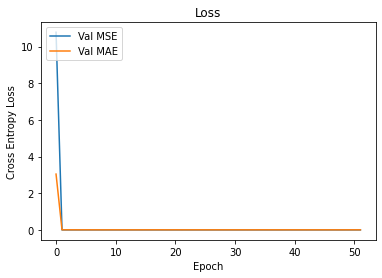

Test Loss MSE:  0.0004007904643766218 Test Loss MAE:  0.005085821091808906
 Epoch 5,  Iteration  3201,  Loss: 0.0004164044
Sum Label:  tensor(50.5302, device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(12.1360, device='cuda:0', grad_fn=<SumBackward0>)


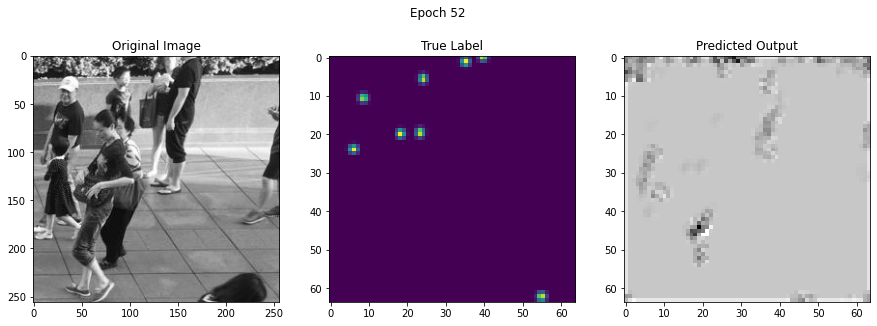

True Number:  tensor(7.6617, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(12.4303, device='cuda:0')


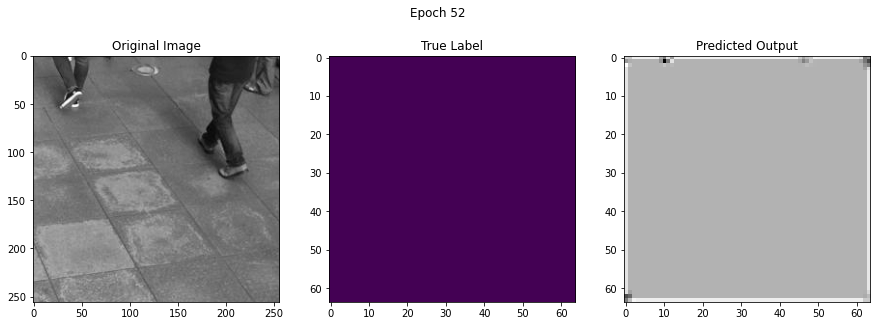

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(12.4515, device='cuda:0')


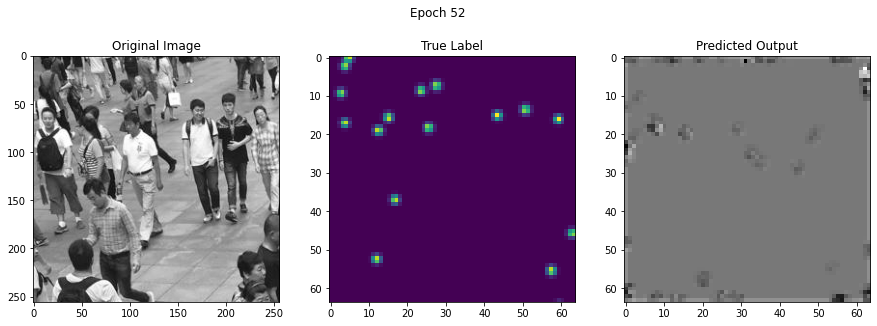

True Number:  tensor(15.8378, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(12.4406, device='cuda:0')


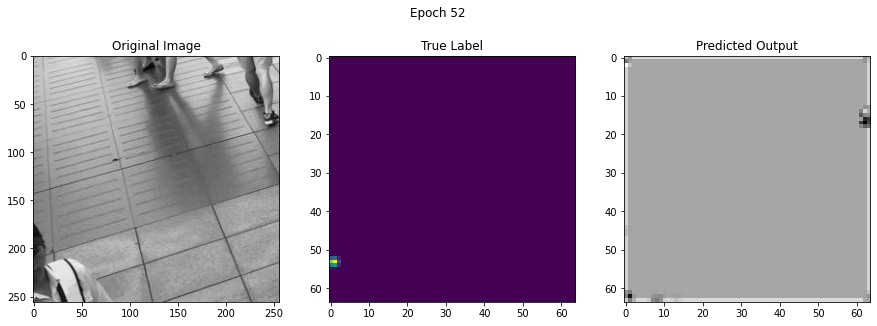

True Number:  tensor(0.9462, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(12.4506, device='cuda:0')


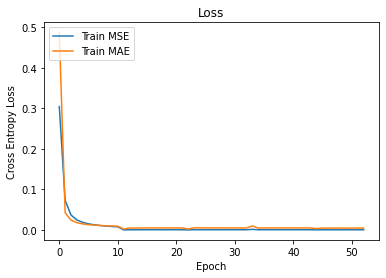

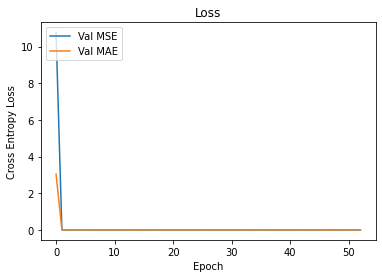

Test Loss MSE:  0.00029994685163811397 Test Loss MAE:  0.004828513063716166
 Epoch 5,  Iteration  3601,  Loss: 0.0004246705
Sum Label:  tensor(0., device='cuda:0', dtype=torch.float64) Sum Prediction:  tensor(8.9593, device='cuda:0', grad_fn=<SumBackward0>)


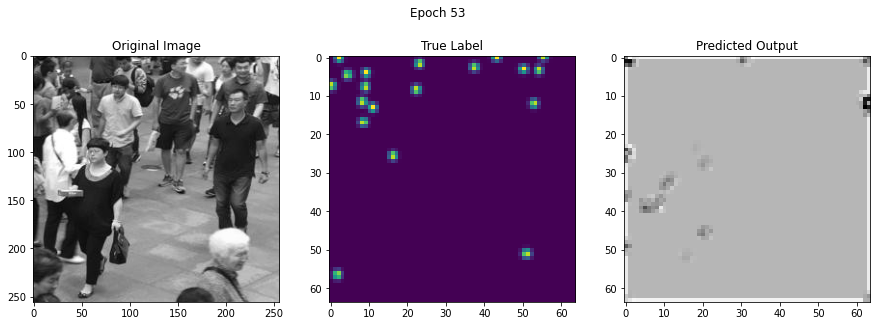

True Number:  tensor(17.8841, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.8346, device='cuda:0')


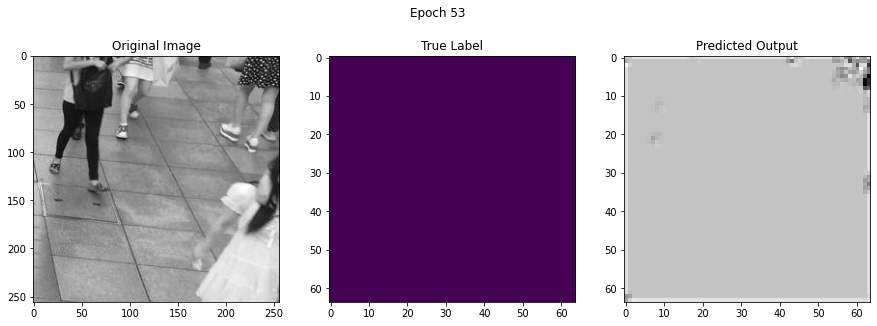

True Number:  tensor(0., device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.8320, device='cuda:0')


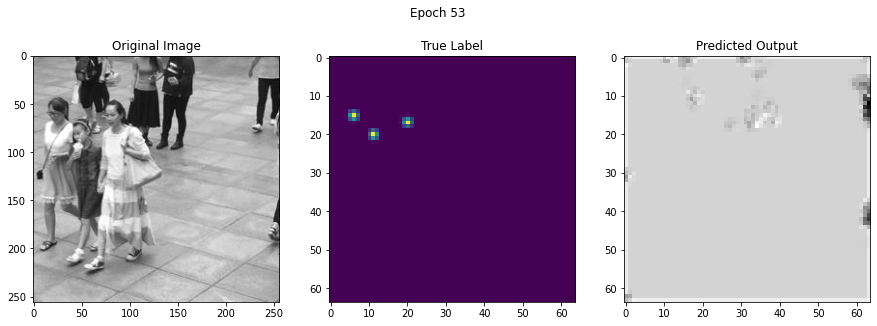

True Number:  tensor(2.9598, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.8280, device='cuda:0')


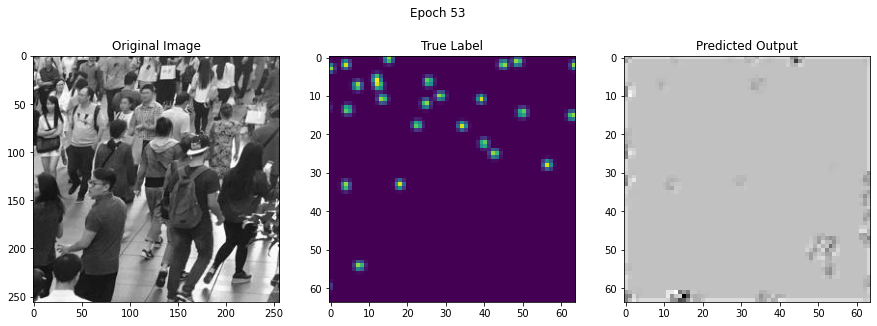

True Number:  tensor(24.1055, device='cuda:0', dtype=torch.float64) Predicted Number:  tensor(8.8299, device='cuda:0')


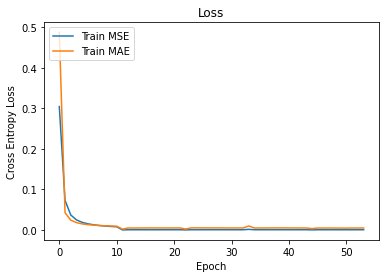

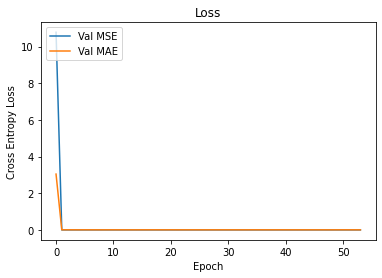

Test Loss MSE:  0.0002790476072952901 Test Loss MAE:  0.0038938142589735564


KeyboardInterrupt: ignored

In [90]:
counter = 0
for epoch in range(60):  # loop over the dataset multiple times
  print("**********Epoch:",epoch+1,"**********")
  lossEpoch = 0.0
  cnt = 0
  running_loss = 0.0
  running_loss_MAE = 0.0
  net = net.train()
  for img,gt_dmap in trainDataSHT:
    cnt = cnt +1
    if torch.cuda.is_available:
      img = Variable(img).cuda()
      gt_dmap =  Variable(gt_dmap).cuda()
    else:
      img = Variable(img)
      gt_dmap = Variable(gt_dmap)
    outputs = net(img.float())
    loss = criterion(outputs.view(-1,64,64), gt_dmap.view(-1,64,64).float())
    lossMAE = criterionII(outputs.view(-1,64,64), gt_dmap.view(-1,64,64).float())
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    running_loss += loss.item()
    running_loss_MAE += lossMAE.item()
    if cnt % 400 == 1:    
        print(' Epoch %d,  Iteration %5d,  Loss: %.10f' %
              (epoch + 1, cnt, running_loss /(cnt)))
        print("Sum Label: ",torch.sum(gt_dmap), "Sum Prediction: ",torch.sum(outputs))
        showResult(trainDataSHT, net, counter)
        mseLoss, maeLoss = calcLoss(valDataSHT, net, criterion, criterionII)
        lossValHist.append(mseLoss)
        lossValMAE.append(maeLoss)
        lossTrainHist.append(running_loss/cnt)
        lossTrainMAE.append(running_loss_MAE/cnt)
        epochHist.append(counter)
        plotLoss(epochHist, lossTrainHist,lossTrainMAE, lossValHist, lossValMAE)
        counter = counter +1
        testMSE, testMAE = calcLoss(testDataSHT, net, criterion, criterionII)
        print("Test Loss MSE: ", testMSE, "Test Loss MAE: ", testMAE)